The goal of this notebook is to analyze the difference between air temperature via satellital images and in-situ measuring devices

In [1]:
from functions import *

2024-12-13 09:37:50.838641: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-13 09:37:50.859385: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-12-13 09:37:50.865678: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-13 09:37:50.882167: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-12-13 09:37:52.111485: W tensorflow/compiler/tf2

In [27]:
import numpy as np
import rasterio
import matplotlib.pyplot as plt
import os
import rasterio
import glob
from skimage.transform import resize
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
import pandas as pd
import geopandas as gpd
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
import pyproj
from geopandas.tools import sjoin
from shapely.geometry import Point,box
import requests
from scipy.stats import ks_2samp
from sklearn.preprocessing import OneHotEncoder
import time
from datetime import datetime
from collections import Counter
import matplotlib.patches as patches
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from rasterio.transform import from_bounds
from rasterio.features import rasterize
from pyproj import Transformer
import contextily as ctx
from skimage.color import rgb2gray
from matplotlib.colors import Normalize

#### Load data

In [3]:
W=64
inputs = ['lst','ndvi','altitude', 'slope','direction']
split = 'random'
filter_alt = False

if W==128:
    data_folder = '../data/preprocessed/'
else:
    data_folder = f'../data/preprocessed/{W}x{W}/'

data = load_all_data(
    source_folder='../data/external/shp/river_cells_oficial',
    source_path=data_folder,
    data_paths= inputs,
    filter_altitude=filter_alt,
    W=W,
    time_split=True if split=='time' else False)

lst : (1307, 64, 64, 3)
ndvi : (1307, 64, 64)
../data/preprocessed/ ole
altitude: (1307, 64, 64)
slope: (1307, 64, 64)
direction: (1307, 64, 64)


In [4]:
total_data, total_times, data_targets, labels = data

#### Load rivers

In [5]:
import os
import fiona
import geopandas as gpd
from shapely.geometry import shape
import matplotlib.pyplot as plt
from shapely.ops import unary_union

river_cells = {}
output_directory = '../data/external/shp/river_cells_oficial'
a=0

for i,riv in enumerate(os.listdir(output_directory)):
    # Check if the file is a shapefile
    try:
        if riv.endswith('.shp'):
            a+=1
            print(f"Processing file: {riv}")
            river = gpd.read_file(os.path.join(output_directory, riv))
            river = river.to_crs("EPSG:4326")
            river_cells[riv.split('station_')[-1].split('.')[0]] = river
            print('Added', riv.split('station_')[-1].split('.')[0])

    except Exception as e:
        print(f"Error processing file: {riv}",e)
        pass

Processing file: station_cell_37.shp
Added cell_37
Processing file: station_cell_8.shp
Added cell_8
Processing file: station_cell_33.shp
Added cell_33
Processing file: station_cell_9.shp
Added cell_9
Processing file: station_cell_42.shp
Added cell_42
Processing file: station_cell_78.shp
Added cell_78
Processing file: station_cell_6.shp
Added cell_6
Processing file: station_cell_46.shp
Added cell_46
Processing file: station_cell_31.shp
Added cell_31
Processing file: station_cell_59.shp
Added cell_59
Processing file: station_cell_63.shp
Added cell_63
Processing file: station_cell_11.shp
Added cell_11
Processing file: station_cell_36.shp
Added cell_36
Processing file: station_cell_65.shp
Added cell_65
Processing file: station_cell_56.shp
Added cell_56
Processing file: station_cell_12.shp
Added cell_12
Processing file: station_cell_72.shp
Added cell_72
Processing file: station_cell_24.shp
Added cell_24
Processing file: station_cell_38.shp
Added cell_38
Processing file: station_cell_80.shp


## Compare clean and raw data

Load raw data

In [6]:
W = 128
total_raw_data = {}
total_raw_times = {}
source_path = '../data/raw/'
data_paths = ['lst','ndvi']#, 'ndvi', 'wt_interpolated']
dir_paths = [os.path.join(source_path,p) for p in data_paths]
all_dir_paths = {k: [] for k in data_paths}
for i,dir_p in enumerate(dir_paths):
    all_dir_paths[data_paths[i]] = []
    for subdir, dirs,files in os.walk(dir_p):
        if subdir != dir_p:
            if not files and not dirs:
                os.rmdir(subdir)
            else:
                all_dir_paths[data_paths[i]].append(subdir)
all_dir_paths

time_split=False
save_labels = []
for k,v in all_dir_paths.items():
    
    if k != 'discharge' and k != 'slope' and k != 'altitude':
        print('Doing',k)
        if k == 'lst' or k == 'masked':
            list_rgb = [True]*len(v)
        else:
            list_rgb = [False]*len(v)
            
        data, times = load_data(v,W,list_rgb)
    
        labelss = []
        for ki,value in data.items():
            labelss+=[ki.split('/')[-1]]*len(value)

        if labelss != []:
            save_labels = labelss
        
        data_values = [np.array(img) for sublist in list(data.values()) for img in sublist]
        times_list = [t for sublist in times for t in sublist]
        
        if time_split:
            dates = [datetime.strptime(date, '%Y-%m') for date in times_list]
            pairs = sorted(zip(dates, data_values, labelss), key=lambda x: x[0])
            sorted_dates, data_values, labelss = zip(*pairs)
            times_list = [date.strftime('%Y-%m') for date in sorted_dates]
            
        total_raw_data[k] = np.array(data_values)
        total_raw_times[k] = times_list
        print(k,':' ,total_raw_data[k].shape)

Doing lst
lst : (11259, 128, 128, 3)
Doing ndvi


/home/ruth.parajo/miniconda3/lib/python3.12/site-packages/skimage/transform/_warps.py:738: RuntimeWarning: All-NaN slice encountered
  min_val = min_func(input_image)
/home/ruth.parajo/miniconda3/lib/python3.12/site-packages/skimage/transform/_warps.py:742: RuntimeWarning: All-NaN slice encountered
  max_val = max_func(input_image)


ndvi : (11259, 128, 128)


In [7]:
original_counts = Counter(save_labels)
print(original_counts)

# Contar imágenes por celda después de la limpieza
cleaned_counts =  Counter(labels) 
print(cleaned_counts)

Counter({'cell_67': 139, 'cell_2': 139, 'cell_70': 139, 'cell_31': 139, 'cell_19': 139, 'cell_29': 139, 'cell_71': 139, 'cell_49': 139, 'cell_43': 139, 'cell_10': 139, 'cell_13': 139, 'cell_41': 139, 'cell_21': 139, 'cell_11': 139, 'cell_58': 139, 'cell_56': 139, 'cell_74': 139, 'cell_37': 139, 'cell_62': 139, 'cell_72': 139, 'cell_65': 139, 'cell_8': 139, 'cell_80': 139, 'cell_68': 139, 'cell_9': 139, 'cell_18': 139, 'cell_69': 139, 'cell_3': 139, 'cell_46': 139, 'cell_23': 139, 'cell_28': 139, 'cell_33': 139, 'cell_54': 139, 'cell_76': 139, 'cell_20': 139, 'cell_22': 139, 'cell_59': 139, 'cell_38': 139, 'cell_7': 139, 'cell_75': 139, 'cell_12': 139, 'cell_48': 139, 'cell_42': 139, 'cell_14': 139, 'cell_77': 139, 'cell_73': 139, 'cell_51': 139, 'cell_81': 139, 'cell_17': 139, 'cell_6': 139, 'cell_45': 139, 'cell_78': 139, 'cell_1': 139, 'cell_30': 139, 'cell_60': 139, 'cell_79': 139, 'cell_15': 139, 'cell_52': 139, 'cell_53': 139, 'cell_26': 139, 'cell_61': 139, 'cell_35': 139, 'cell_

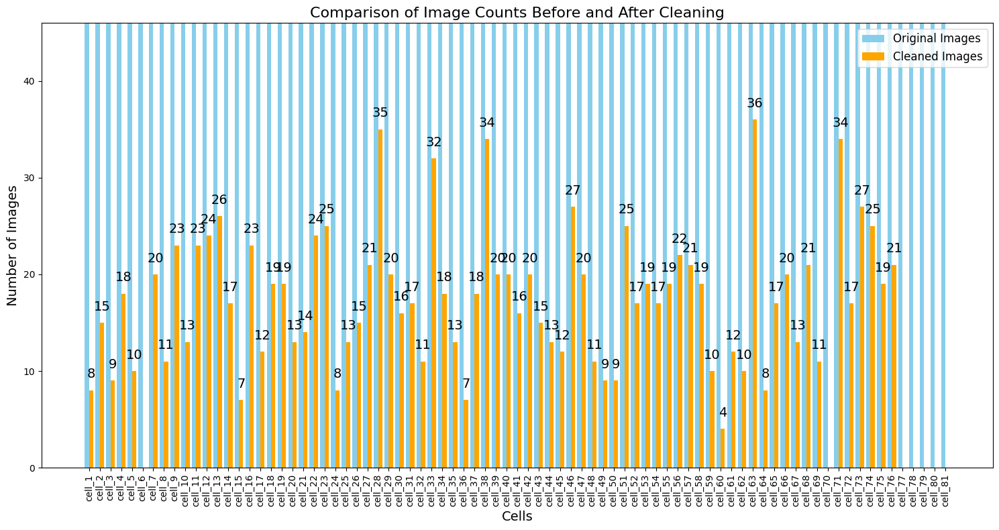

In [8]:
import matplotlib.pyplot as plt
import numpy as np

# Sort cells numerically by extracting the number from the string
cells = sorted(set(original_counts.keys()).union(cleaned_counts.keys()), key=lambda x: int(x.split('_')[1]))

# Extract values for each cell, ensuring alignment with the sorted order
original_values = [original_counts.get(cell, 0) for cell in cells]
cleaned_values = [cleaned_counts.get(cell, 0) for cell in cells]

# Create grouped bar plot
x = np.arange(len(cells))  # Bar positions
width = 0.4  # Width of the bars

fig, ax = plt.subplots(figsize=(15, 8))

# Plot original and cleaned image counts
bars1 = ax.bar(x - width / 2, original_values, width, label="Original Images", color="skyblue")
bars2 = ax.bar(x + width / 2, cleaned_values, width, label="Cleaned Images", color="orange")

# Set Y-axis limit to cut off the tall original bars
ax.set_ylim(0, max(cleaned_values) + 10)

# Set labels and title with custom font sizes
ax.set_xlabel("Cells", fontsize=14)
ax.set_ylabel("Number of Images", fontsize=14)
ax.set_title("Comparison of Image Counts Before and After Cleaning", fontsize=16)

# Customize X-ticks
ax.set_xticks(x)
ax.set_xticklabels(cells, rotation=90, fontsize=10)

# Customize legend font size
ax.legend(fontsize=12)

# Add value labels only for cleaned image bars
for bar in bars2:  # Only for cleaned data bars
    height = bar.get_height()
    if height > 0:  # Show only non-zero values
        ax.text(bar.get_x() + bar.get_width() / 2, height + 1, f'{int(height)}', ha='center', va='bottom', fontsize=14)

# Adjust layout and display the plot
plt.tight_layout()
plt.show()


In [9]:
df = pd.DataFrame({
    "Cell": cells,
    "Original Images": original_values,
    "Cleaned Images": cleaned_values
})

# Ordenar por diferencia
df["Difference"] = df["Original Images"] - df["Cleaned Images"]
df = df.sort_values(by="Difference", ascending=False)

# Mostrar la tabla
print(df)

       Cell  Original Images  Cleaned Images  Difference
80  cell_81              139               0         139
79  cell_80              139               0         139
78  cell_79              139               0         139
77  cell_78              139               0         139
5    cell_6              139               0         139
..      ...              ...             ...         ...
32  cell_33              139              32         107
37  cell_38              139              34         105
70  cell_71              139              34         105
27  cell_28              139              35         104
62  cell_63              139              36         103

[81 rows x 4 columns]


## Data stats

In [10]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import re

# Sample data (simulated) since real data wasn't provided
data = {
    "label": labels[0:len(total_times['lst'])],
    "fecha": total_times['lst']
}
df = pd.DataFrame(data)
df['cell_num'] = df['label'].apply(lambda x: int(re.search(r'\d+', x).group()))

def categorize_season(date_str):
    month = int(date_str.split("-")[1])  # Extract month as integer
    if month in [12, 1, 2]:
        return "Winter"
    elif month in [6, 7, 8]:
        return "Summer"
    else:
        return "Spring-Autumn"

# Apply season categorization
df['season'] = df['fecha'].apply(categorize_season)

# Count frequency of labels and seasons
label_counts = df['label'].value_counts()
season_counts = df['season'].value_counts()

# Calculate top 20 most frequent cell numbers
cell_counts = df['cell_num'].value_counts().head(20)

# Plot for top 20 cell numbers
plt.figure(figsize=(10, 6))
cell_counts.plot(kind='bar', color="skyblue", edgecolor="black")
plt.title("Top 20 Cell Frequency")
plt.xlabel("Cell Numbers", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.savefig("../plots/top_20_cell_frequency_low_alt.png")  # Save as PNG
plt.close()  # Close the plot to avoid overlap

# Plot for season frequency
plt.figure(figsize=(6, 6))
season_counts.plot(kind='bar', color="salmon", edgecolor="black")
plt.title("Frequency by Season")
plt.xlabel("Seasons", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.savefig("../plots/season_frequency_low_alt.png")  # Save as PNG
plt.close()  # Close the plot


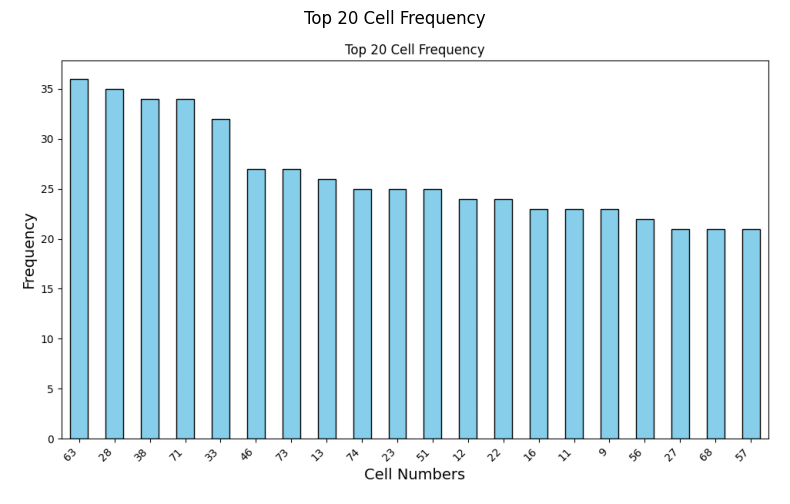

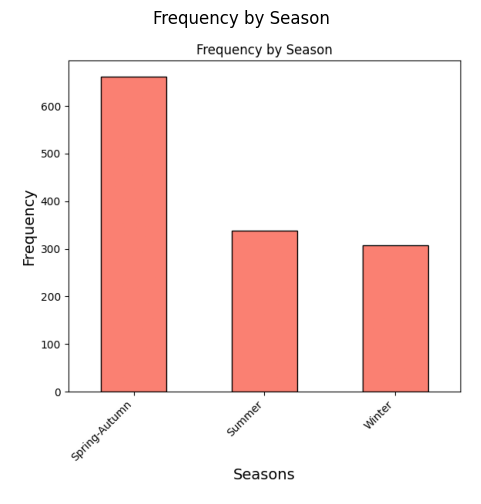

In [11]:
img1 = plt.imread("../plots/top_20_cell_frequency_low_alt.png")
plt.figure(figsize=(10, 6))
plt.imshow(img1)
plt.axis('off')  # Hide axis for a cleaner look
plt.title("Top 20 Cell Frequency")
plt.show()

# Load and display the season frequency chart
img2 = plt.imread("../plots/season_frequency_low_alt.png")
plt.figure(figsize=(6, 6))
plt.imshow(img2)
plt.axis('off')  # Hide axis for a cleaner look
plt.title("Frequency by Season")
plt.show()

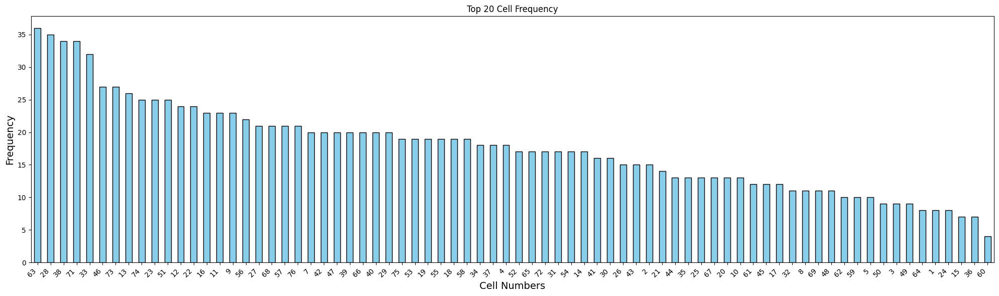

In [12]:
cell_counts = df['cell_num'].value_counts()

# Plot for top 20 cell numbers
plt.figure(figsize=(20, 6))
cell_counts.plot(kind='bar', color="skyblue", edgecolor="black")
plt.title("Top 20 Cell Frequency")
plt.xlabel("Cell Numbers", fontsize=14)
plt.ylabel("Frequency", fontsize=14)
plt.xticks(rotation=45, ha="right")
plt.tight_layout()


#### Frequency heatmap

In [13]:
def get_lat_lon(labels):
    file_path = '../data/raw/wt/cell_coordinates_oficial.csv'
    lat_lon = pd.read_csv(file_path)
    lats=[]
    lons=[]
    for label in labels:
        num_cell = int(label.split('_')[-1])
        lat = lat_lon[lat_lon.Cell==num_cell].Latitude.values[0]
        lon = lat_lon[lat_lon.Cell==num_cell].Longitude.values[0]
        lats.append(lat)
        lons.append(lon)
    lats = np.array(lats)
    lons = np.array(lons)
    return lats, lons

In [14]:
len(labels)

1307

In [15]:
lat, lon = get_lat_lon(labels)
merged_df = pd.DataFrame(data={'lat':list(lat),'lon':list(lon),'labels':labels})
merged_df

,lat,lon,labels
0,2501212,1115123.0,cell_67
1,2501212,1115123.0,cell_67
2,2501212,1115123.0,cell_67
3,2501212,1115123.0,cell_67
4,2501212,1115123.0,cell_67
...,...,...,...
1302,2749036,1244216.0,cell_24
1303,2749036,1244216.0,cell_24
1304,2749036,1244216.0,cell_24
1305,2749036,1244216.0,cell_24


In [16]:
frequency_df = merged_df.groupby(['lat', 'lon']).size().reset_index(name='frequency')

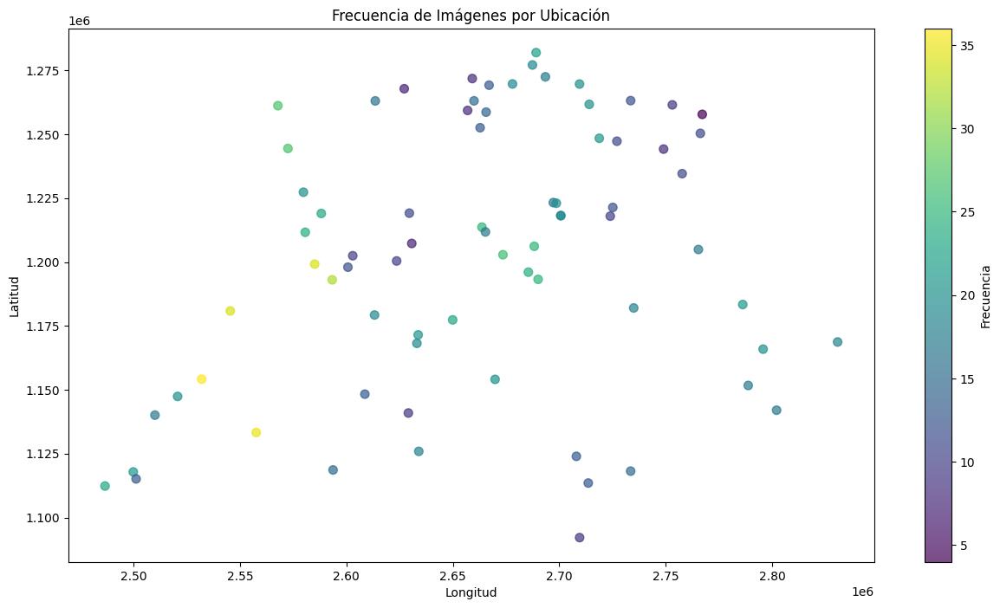

In [17]:
plt.figure(figsize=(15, 8))
plt.scatter(frequency_df['lat'], frequency_df['lon'], c=frequency_df['frequency'], cmap='viridis', s=50, alpha=0.7)
plt.colorbar(label="Frecuencia")
plt.title("Frecuencia de Imágenes por Ubicación")
plt.xlabel("Longitud")
plt.ylabel("Latitud")
plt.show()


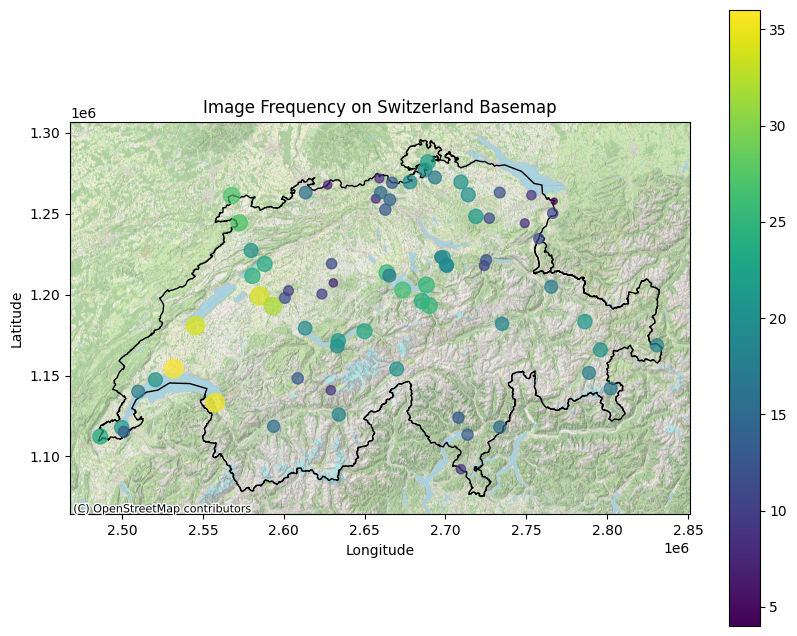

In [20]:
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt

# Create the GeoDataFrame in EPSG:2056
gdf = gpd.GeoDataFrame(
    frequency_df, 
    geometry=gpd.points_from_xy(frequency_df.lat, frequency_df.lon), 
    crs="EPSG:2056"
)


# Convert to EPSG:4326 to use with contextily
gdf = gdf.to_crs(epsg=2056)


switzerland = gpd.read_file('../data/external/shp/swiss_boundaries/swissBOUNDARIES3D_1_5_TLM_LANDESGEBIET.shp')
switzerland = switzerland.to_crs("EPSG:2056")

# Define an appropriate zoom level (e.g., zoom=12 or zoom=13 for regional detail)
zoom_level = 12

# Create the plot
fig, ax = plt.subplots(figsize=(10, 8))
switzerland.plot(ax=ax, color='none', edgecolor='black')  
gdf.plot(
    ax=ax,
    column='frequency',       # Use 'frequency' column for color mapping
    cmap='viridis',           # Color map for frequencies
    markersize=gdf['frequency'] * 5,  # Adjust marker size based on frequency
    legend=True,
    alpha=0.7
)

# Add the basemap with a fixed zoom level
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Add title and labels
ax.set_title("Image Frequency on Switzerland Basemap")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")
plt.savefig('../plots/final_swiss_dist.png')
plt.show()


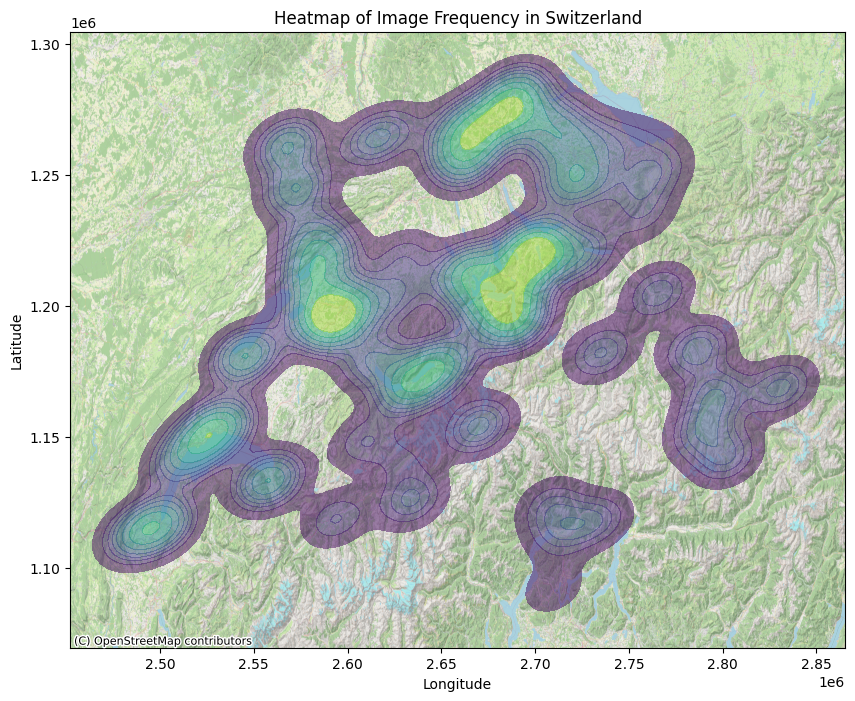

In [21]:
'''plt.figure(figsize=(10, 8))
sns.kdeplot(
    data=frequency_df,
    x='lat',
    y='lon',
    weights='frequency',
    cmap='viridis',
    fill=True,
    alpha=0.5,
    bw_adjust=0.3  # Reduce el bandwidth para mayor detalle
)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

plt.title("Heatmap de Frecuencia de Imágenes en Suiza")
plt.xlabel("Longitud")
plt.ylabel("Latitud")
plt.show()'''
import geopandas as gpd
import contextily as ctx
import matplotlib.pyplot as plt
import seaborn as sns

# Convert coordinates to EPSG:4326 (latitude and longitude)
gdf = gpd.GeoDataFrame(
    frequency_df,
    geometry=gpd.points_from_xy(frequency_df.lat, frequency_df.lon),
    crs="EPSG:2056"
)
#gdf = gdf.to_crs(epsg=4326)

# Extract lat/lon and frequency for the KDE plot
frequency_df['lon'] = gdf.geometry.x
frequency_df['lat'] = gdf.geometry.y

# Create the plot
fig, ax = plt.subplots(figsize=(10, 8))

# KDE plot with frequency weights
sns.kdeplot(
    data=frequency_df,
    x='lon',
    y='lat',
    weights='frequency',
    cmap='viridis',
    fill=True,
    alpha=0.5,
    bw_adjust=0.3,  # Adjust bandwidth for more detail
    ax=ax
)

# Add the OpenStreetMap basemap with appropriate zoom level
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=12)

# Add labels and title
ax.set_title("Heatmap of Image Frequency in Switzerland")
ax.set_xlabel("Longitude")
ax.set_ylabel("Latitude")

plt.show()



### Water temperature evolution

In [30]:
water_temp

,1,2,3,4,5,6,7,8,9,10,...,72,73,74,75,76,77,78,79,80,81
Zeitstempel,,,,,,,,,,,,,,,,,,,,,
2013-03-01 00:00:00,5.76,1.05,2.72,2.91,3.61,5.86,3.23,7.46,6.24,5.59,...,5.96,8.20,4.04,6.69,6.04,6.06,5.48,3.83,4.64,0.96
2013-04-01 00:00:00,8.16,3.23,3.62,5.43,5.91,8.54,5.20,8.94,8.94,8.33,...,8.02,9.92,5.92,9.93,8.77,8.77,8.22,8.19,8.90,1.56
2013-05-01 00:00:00,12.06,5.38,4.49,6.83,8.68,12.21,8.49,9.46,10.16,11.65,...,8.53,10.93,6.86,13.71,10.15,12.35,10.14,10.75,11.26,1.31
2013-06-01 00:00:00,15.15,9.05,5.01,8.56,12.00,15.21,12.85,10.42,13.67,15.12,...,10.90,12.93,8.49,17.17,14.04,15.36,13.41,13.63,15.18,1.31
2013-07-01 00:00:00,19.52,12.63,6.34,10.80,15.42,21.28,17.35,11.98,19.61,20.50,...,13.75,16.97,10.80,20.67,20.99,21.30,17.45,17.22,20.13,1.25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-05-01 00:00:00,13.94,6.03,4.81,7.26,10.67,13.85,11.10,10.58,12.20,13.40,...,10.36,12.10,7.63,15.62,12.29,13.95,11.97,12.41,14.02,1.79
2024-06-01 00:00:00,16.58,9.45,5.38,8.63,13.05,17.00,13.57,11.62,15.24,16.79,...,12.24,13.55,9.03,18.39,15.95,17.04,14.46,14.65,16.51,1.56
2024-07-01 00:00:00,19.75,12.10,6.82,10.47,15.52,20.68,16.94,12.39,18.90,20.38,...,14.30,15.95,10.74,20.82,19.92,20.67,17.49,17.22,19.97,Lücke


In [35]:
water_temp = pd.read_csv(f'../data/preprocessed/wt/water_temp.csv', index_col=0)
times_ordered = total_times['lst']
wt_temp = []
labels_wt = []
for cell, date in zip(labels, times_ordered):
    temp = water_temp[(water_temp["Cell"] == cell) & (water_temp["Date"] == date)]["WaterTemp"]
    #water_temp["YearMonth"] = pd.to_datetime(water_temp.index).strftime("%Y-%m")
    #water_temp = water_temp.set_index("YearMonth")
    #temp = water_temp.loc[date, cell.split('_')[1]]
    #if temp:
     #   wt_temp.append(temp)
      #  labels_wt.append(cell)
        

    if not temp.empty:
        wt_temp.append(temp.values[0])
        labels_wt.append(cell)
data_targets = np.array(wt_temp)

/tmp/ipykernel_2888408/3332101131.py:43: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all Axes decorations.
  plt.tight_layout()


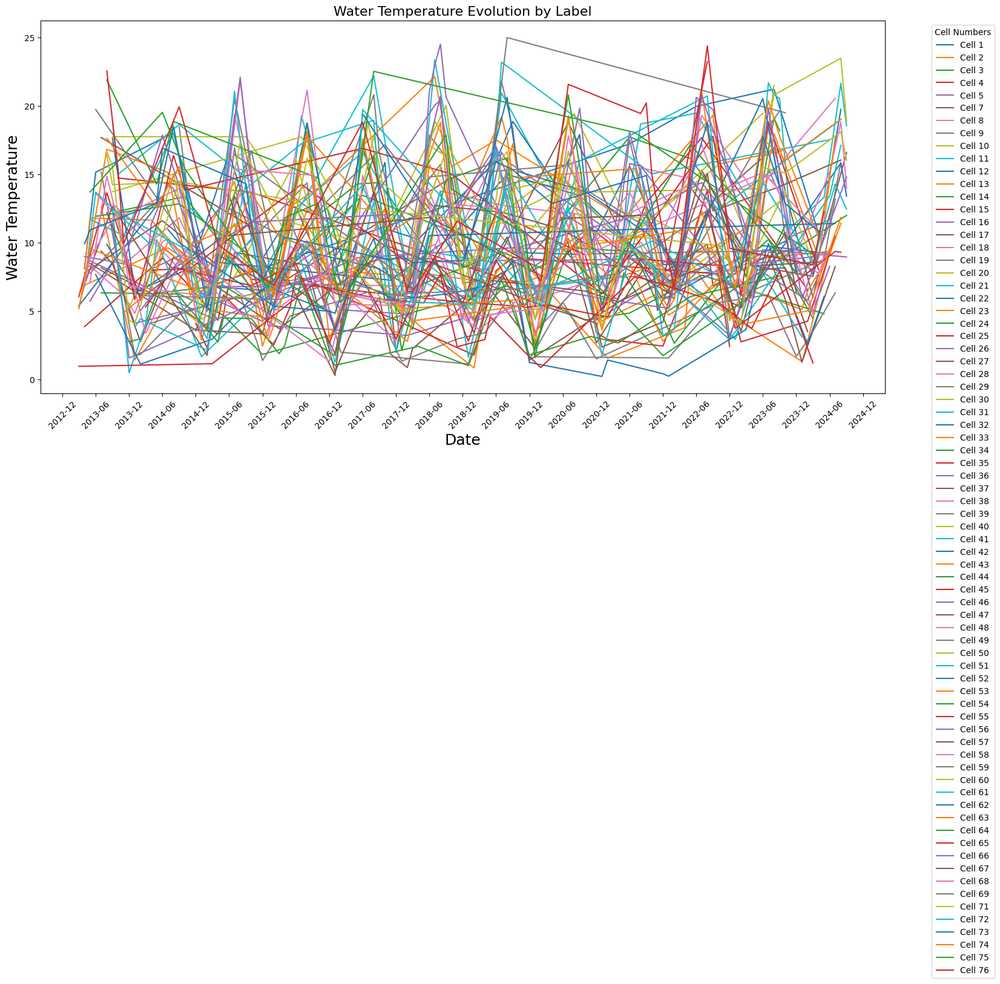

In [19]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import re
import matplotlib.dates as mdates

# Assuming your data includes temperature information alongside labels and dates
data = {
    "label": labels[0:len(total_times['lst'])],
    "fecha": total_times['lst'],
    "temperature": data_targets  # Add your list of water temperatures here
}
df = pd.DataFrame(data)
df['cell_num'] = df['label'].apply(lambda x: int(re.search(r'\d+', x).group()))

# Convert 'fecha' to datetime format
df['fecha'] = pd.to_datetime(df['fecha'], format="%Y-%m")

# Sort by label and date for proper plotting
df = df.sort_values(by=['cell_num', 'fecha'])

# Set the figure size to make the x-axis wider
plt.figure(figsize=(18, 8))

# Plot temperature evolution by label without resampling or interpolation
for cell_num, group in df.groupby('cell_num'):
    plt.plot(group['fecha'], group['temperature'], label=f'Cell {cell_num}')

# Set axis labels and title
plt.xlabel("Date", fontsize=18)
plt.ylabel("Water Temperature", fontsize=18)
plt.title("Water Temperature Evolution by Label", fontsize=16)

# Rotate x-axis labels to make dates readable
plt.xticks(rotation=45)

# Set x-axis to display dates every 6 months
plt.gca().xaxis.set_major_locator(mdates.MonthLocator(interval=6))
plt.gca().xaxis.set_major_formatter(mdates.DateFormatter("%Y-%m"))

# Place the legend outside the plot for clarity
plt.legend(title="Cell Numbers", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.savefig('../plots/wt_evolution.png')
plt.show()


### Variables Descriptive Analysis

In [37]:
for inp in inputs:  
    all_images = total_data[inp]  
    global_min = np.min(all_images)
    global_max = np.max(all_images)
    print(inp, global_min, global_max)
    

lst 0.0 255.0
ndvi -0.67441636 0.8880241


### LST and NDVI analysis and evolution

In [39]:
lst_folder = '../data/preprocessed/64x64/ndvi'
W=128
cells_data={}
cells_times = {}
imgs_paths = [os.path.join(lst_folder,file) for file in os.listdir(lst_folder)]
list_rgb = [False] * len(imgs_paths)
data_ndvi, times_ndvi = load_data(imgs_paths, W, list_rgb)

In [13]:
lst_folder = '../data/preprocessed/lst'
W=128
cells_data={}
cells_times = {}
imgs_paths = [os.path.join(lst_folder,file) for file in os.listdir(lst_folder)]
list_rgb = [True] * len(imgs_paths)
data, times = load_data(imgs_paths, W, list_rgb)

In [55]:
discharge = get_discharge(labels, total_times['lst'])
lat, lon = get_lat_lon(labels)

### Obtain temperature proxy from LST

In [41]:
def float_to_uint8(array):
    """
    Convert a float64 array to uint8 by normalizing it to [0, 255].

    Args:
        array (np.ndarray): Input array of type float64.

    Returns:
        np.ndarray: Array converted to uint8.
    """
    normalized_array = (array - np.min(array)) / (np.max(array) - np.min(array)) * 255
    return normalized_array.astype(np.uint8)

def convert_rgb_to_temperature(image_list, min_temp=0, max_temp=50):
    """
    Convert a list of RGB images to temperature-scaled grayscale images.
    
    Args:
        image_list (list of np.ndarray): List of RGB images as numpy arrays (H x W x 3).
        min_temp (float): Minimum temperature for scaling.
        max_temp (float): Maximum temperature for scaling.
    
    Returns:
        list of np.ndarray: List of transformed images in temperature scale.
    """
    temperature_images = []  # List to store transformed images
    
    for rgb in image_list:
        if rgb.dtype == np.float64:
            rgb = float_to_uint8(rgb)
        # Convert RGB to grayscale
        #print(np.min(rgb),np.max(rgb))
        gray = rgb2gray(rgb)  # Values normalized to [0, 1]
        #print(gray)
        
        # Scale grayscale values to temperature range
        temperature = gray * (max_temp - min_temp) + min_temp
        
        # Append the temperature-scaled image to the result list
        temperature_images.append(temperature)
    
    return temperature_images

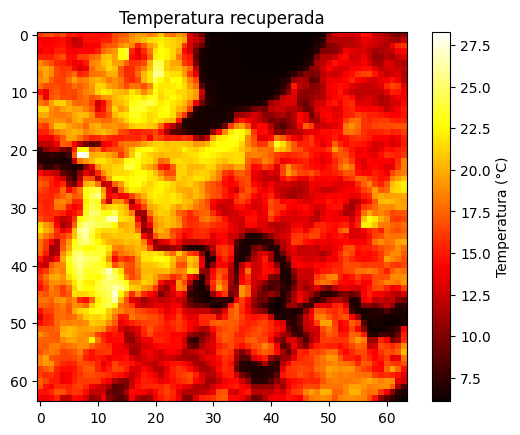

In [42]:
minC = 0  
maxC = 50  
temperature_images = convert_rgb_to_temperature(total_data['lst'], min_temp=minC, max_temp=maxC)

plt.imshow(temperature_images[0], cmap='hot')
plt.colorbar(label='Temperatura (°C)')
plt.title('Temperatura recuperada')
plt.show()

In [43]:
len(temperature_images)

1307

## Seasons mean map

In [51]:
def map_season(date):
    month = pd.to_datetime(date).month
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5, 9, 10, 11]:
        return 'Spring-Autumn'
    elif month in [6, 7, 8]:
        return 'Summer'

mean_lst_values = []
mean_ndvi_values = []
labelss = [] 
tt=0
for i,(k, imgs) in enumerate(data_ndvi.items()):
    dates = []
    keyy = [key for key in data_ndvi.keys() if key.split('/')[-1] == k.split('/')[-1]]
    ndvi_cell = data_ndvi[keyy[0]]
    
    if len(imgs)>0:
        for j,img in enumerate(imgs):
            labelss.append(k.split('/')[-1])
            date = times_ndvi[i][j]
            dates.append(date)
            img_lst = temperature_images[tt]
            tt+=1
            
            mean_lst = np.mean(img_lst)
            mean_lst_values.append(mean_lst)
            
            mean_ndvi = np.mean(ndvi_cell[j])
            mean_ndvi_values.append(mean_ndvi)

In [56]:
df = pd.DataFrame({
    'cell': labels,
    'date': total_times['lst'],
    'mean_lst': mean_lst_values,
    'mean_ndvi': mean_ndvi_values,
    'discharge': discharge,
    'lat': lat,
    'lon': lon
})

df['season'] = df['date'].apply(map_season)

seasonal_data = df.groupby(["cell", "season"])["mean_lst"].mean().reset_index()


         cell     date   mean_lst  mean_ndvi  discharge      lat        lon  \
0     cell_67  2013-08  15.034346   0.449159     87.216  2501212  1115123.0   
1     cell_67  2014-02  14.601240   0.231017     61.759  2501212  1115123.0   
2     cell_67  2015-05  10.060074   0.440989    192.179  2501212  1115123.0   
3     cell_67  2018-06   7.776886   0.408899     95.339  2501212  1115123.0   
4     cell_67  2020-03   7.627264   0.401331     96.676  2501212  1115123.0   
...       ...      ...        ...        ...        ...      ...        ...   
1302  cell_24  2017-06   7.566986   0.748346      3.643  2749036  1244216.0   
1303  cell_24  2021-04  10.899457   0.030390      2.128  2749036  1244216.0   
1304  cell_24  2021-05  11.110658   0.733254      6.727  2749036  1244216.0   
1305  cell_24  2021-12   5.670675   0.139241      0.465  2749036  1244216.0   
1306  cell_24  2024-09   7.870682   0.698092      2.784  2749036  1244216.0   

             season                 geometry  
0   

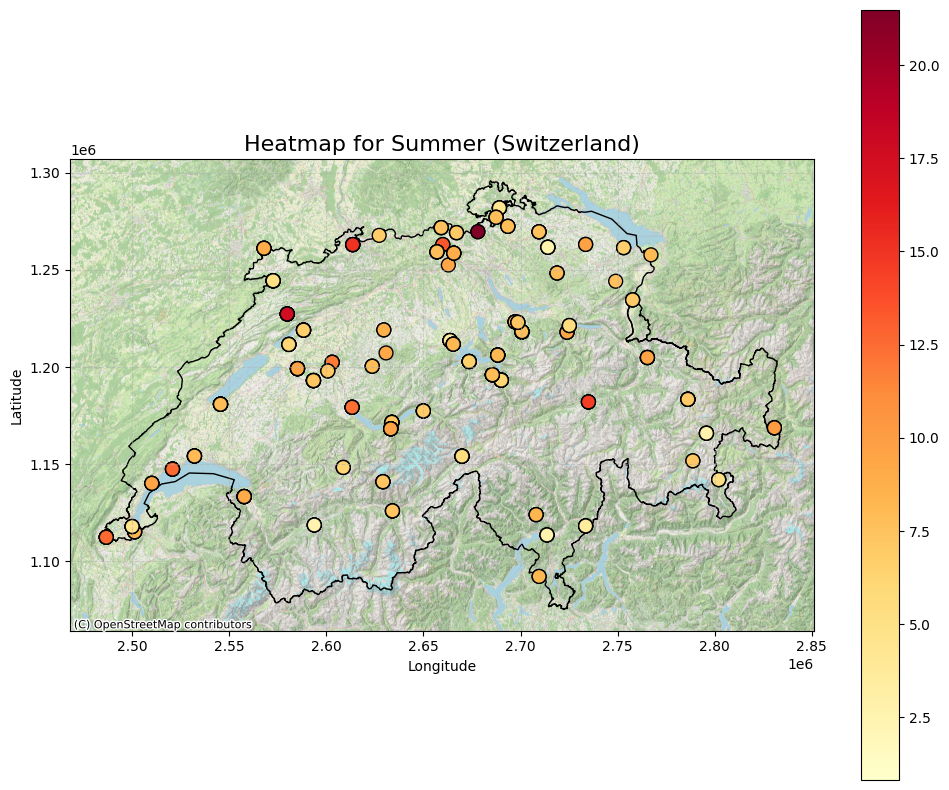

In [58]:
#transformer = Transformer.from_crs("EPSG:2056", "EPSG:4326", always_xy=True)
#df[['lon', 'lat']] = df.apply(lambda row: transformer.transform(row['lat'], row['lon']), axis=1, result_type="expand")

switzerland = gpd.read_file('../data/external/shp/swiss_boundaries/swissBOUNDARIES3D_1_5_TLM_LANDESGEBIET.shp')
#if "NAME" in switzerland.columns:
#    switzerland = switzerland[switzerland["NAME"] == "Switzerland"]

switzerland = switzerland.to_crs("EPSG:2056")

gdf_points = gpd.GeoDataFrame(
    df, geometry=gpd.points_from_xy(df['lat'], df['lon']), crs="EPSG:2056"
)

gdf_points = gdf_points.to_crs(epsg=2056)
print(gdf_points)
# Filtrar datos por estación
season_filter = "Summer"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_summer.png')
plt.show()

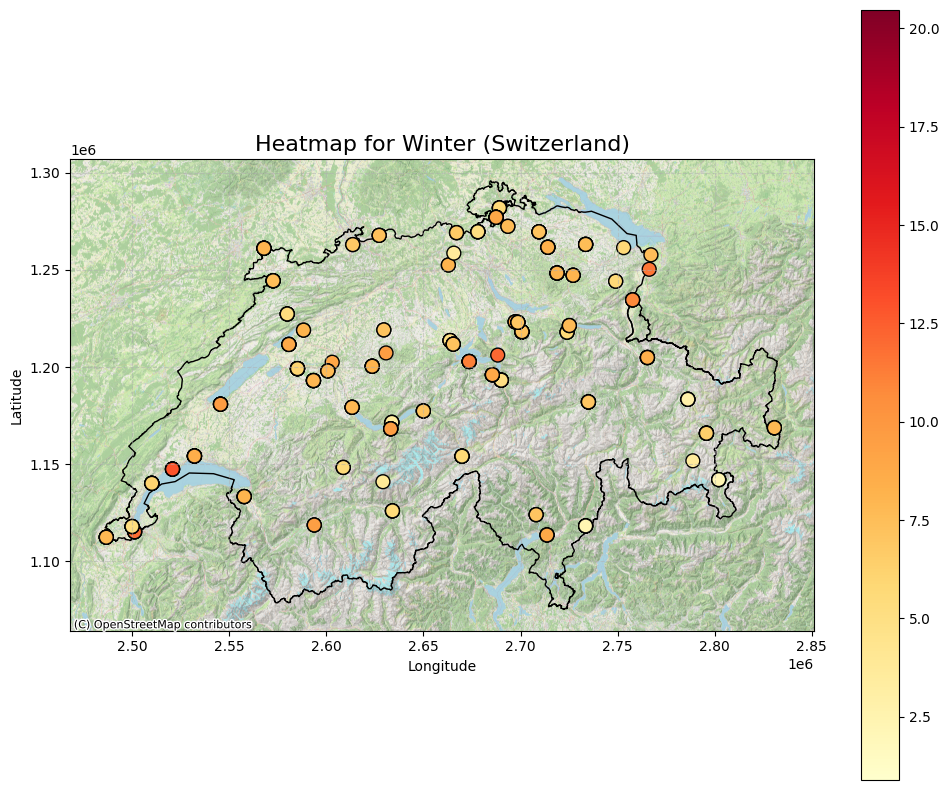

In [59]:
season_filter = "Winter"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  # Dibujar mapa de Suiza
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_winter.png')
plt.show()

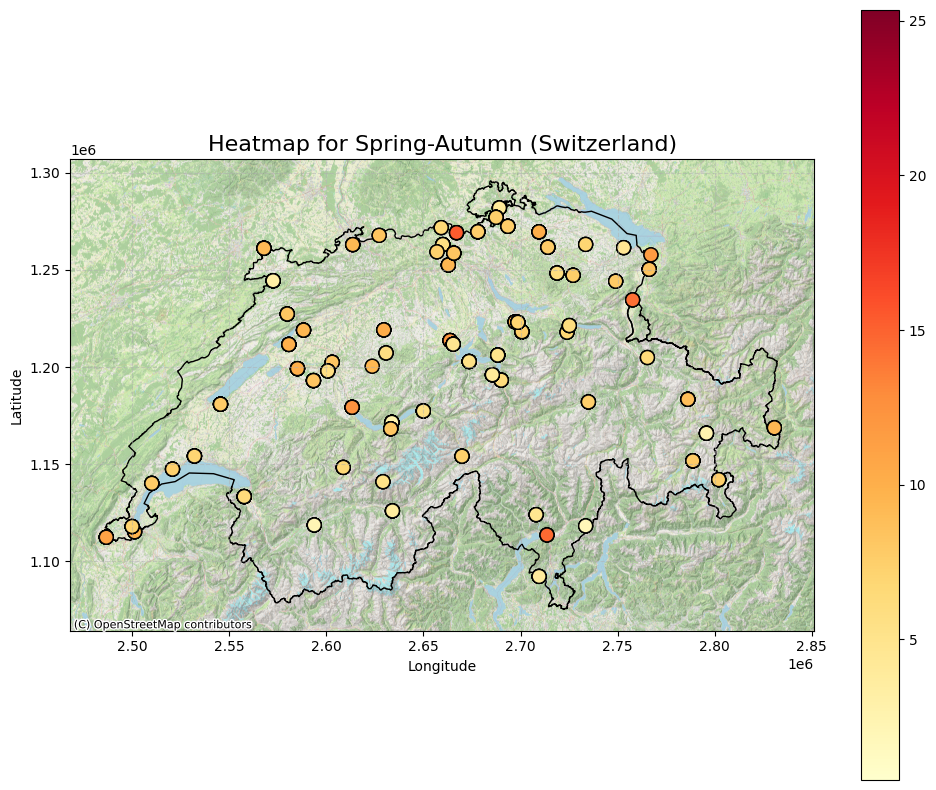

In [60]:
season_filter = "Spring-Autumn"
gdf_filtered = gdf_points[gdf_points['season'] == season_filter]
zoom_level = 12
# Crear el mapa
fig, ax = plt.subplots(figsize=(12, 10))
switzerland.plot(ax=ax, color='none', edgecolor='black')  # Dibujar mapa de Suiza
gdf_filtered.plot(ax=ax, column='mean_lst', cmap='YlOrRd', markersize=100, edgecolor='black', legend=True)
ctx.add_basemap(ax, crs="EPSG:2056", source=ctx.providers.OpenStreetMap.CH, zoom=zoom_level)

# Personalizar el gráfico
plt.title(f"Heatmap for {season_filter} (Switzerland)", fontsize=16)
plt.xlabel("Longitude")
plt.ylabel("Latitude")
plt.grid(True, linestyle='--', alpha=0.5)
plt.savefig('../plots/lst_heatmap_aut_spring.png')
plt.show()

In [61]:
max_lst_row = df.loc[df['mean_lst'].idxmax()]

# Fila con la media más baja de LST
min_lst_row = df.loc[df['mean_lst'].idxmin()]

# Mostrar los resultados
print("Fila con la media más alta de LST:")
print(max_lst_row)

print("\nFila con la media más baja de LST:")
print(min_lst_row)

Fila con la media más alta de LST:
cell               cell_30
date               2020-05
mean_lst         25.345918
mean_ndvi         0.507541
discharge           27.534
lat                2613571
lon              1263084.0
season       Spring-Autumn
Name: 900, dtype: object

Fila con la media más baja de LST:
cell               cell_57
date               2016-04
mean_lst           0.45344
mean_ndvi         0.746612
discharge           38.054
lat                2718825
lon              1248448.0
season       Spring-Autumn
Name: 1203, dtype: object


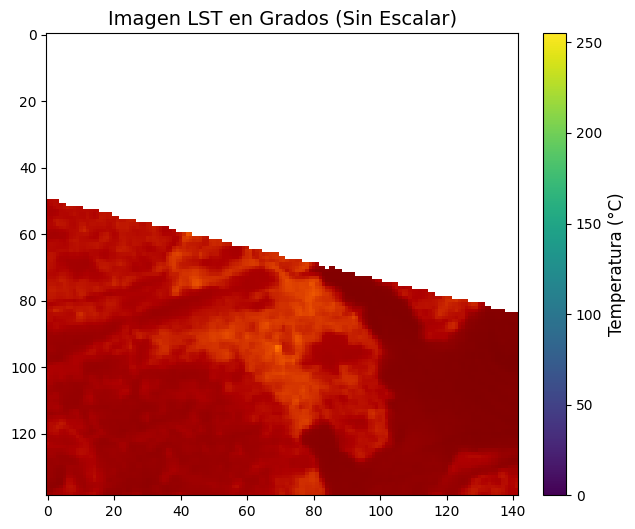

{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 142, 'height': 139, 'count': 3, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.001305375080970748, 0.0, 8.205998956540387,
       0.0, -0.0009063485523095918, 47.11719475456272)}
Cantidad de bandas: 3
Banda 1: Min=125, Max=255, Media=209.59919951362852
Banda 2: Min=0, Max=255, Media=127.99630155030904
Banda 3: Min=0, Max=255, Media=122.9524267909616


In [128]:
im, m = load_raster('../data/raw/lst/cell_52/image_2015-09.tiff', True)

fig, ax = plt.subplots(figsize=(8, 6))
cax = ax.imshow(im, cmap='viridis')  # Usamos un colormap continuo para representar los valores
ax.set_title("Imagen LST en Grados (Sin Escalar)", fontsize=14)

# Crear la barra de colores
cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Temperatura (°C)', fontsize=12)  # Etiqueta en grados

plt.show()
print(m.meta)
with rasterio.open('../data/raw/lst/cell_52/image_2015-09.tiff') as src:
    print(f"Cantidad de bandas: {src.count}")
    for i in range(1, src.count + 1):
        band = src.read(i)
        print(f"Banda {i}: Min={band.min()}, Max={band.max()}, Media={band.mean()}")

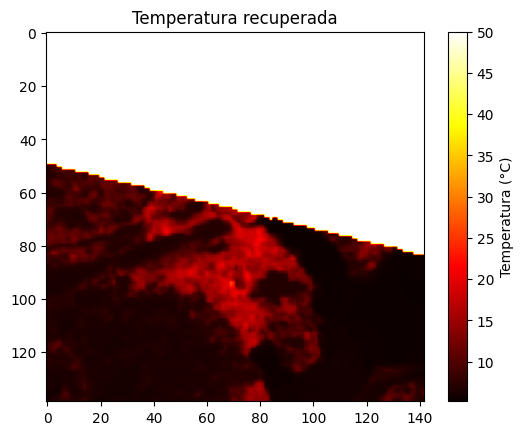

In [34]:
from skimage.color import rgb2gray
minC = 0  # Temperatura mínima (°C)
maxC = 50  
with rasterio.open('../data/raw/lst/cell_52/image_2015-09.tiff') as src:
    rgb = np.dstack([src.read(i) for i in range(1, 4)])  # Combinar las 3 bandas (RGB)

# Convertir a escala de grises como aproximación del gradiente
gray = rgb2gray(rgb)  # Devuelve valores en [0, 1]
#gray = rgb[...,0]
# Revertir el gradiente a temperatura
temperature = gray * (maxC - minC) + minC

# Mostrar el resultado
import matplotlib.pyplot as plt
plt.imshow(temperature, cmap='hot')
plt.colorbar(label='Temperatura (°C)')
plt.title('Temperatura recuperada')
plt.show()

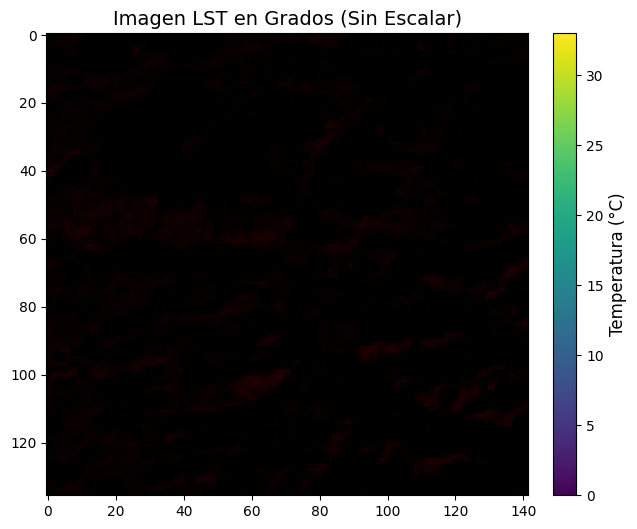

{'driver': 'GTiff', 'dtype': 'uint8', 'nodata': None, 'width': 142, 'height': 136, 'count': 3, 'crs': CRS.from_epsg(4326), 'transform': Affine(0.0012878371327625098, 0.0, 7.259702439241475,
       0.0, -0.0009215557783129945, 46.951099436808974)}
Cantidad de bandas: 3
Banda 1: Min=0, Max=33, Media=3.045049710024855
Banda 2: Min=0, Max=0, Media=0.0
Banda 3: Min=0, Max=0, Media=0.0


In [130]:
im, m = load_raster('../data/raw/lst/cell_33/image_2021-12.tiff', True)

fig, ax = plt.subplots(figsize=(8, 6))
cax = ax.imshow(im, cmap='viridis')  # Usamos un colormap continuo para representar los valores
ax.set_title("Imagen LST en Grados (Sin Escalar)", fontsize=14)

# Crear la barra de colores
cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
cbar.set_label('Temperatura (°C)', fontsize=12)  # Etiqueta en grados

plt.show()
print(m.meta)
with rasterio.open('../data/raw/lst/cell_33/image_2021-12.tiff') as src:
    print(f"Cantidad de bandas: {src.count}")
    for i in range(1, src.count + 1):
        band = src.read(i)
        print(f"Banda {i}: Min={band.min()}, Max={band.max()}, Media={band.mean()}")

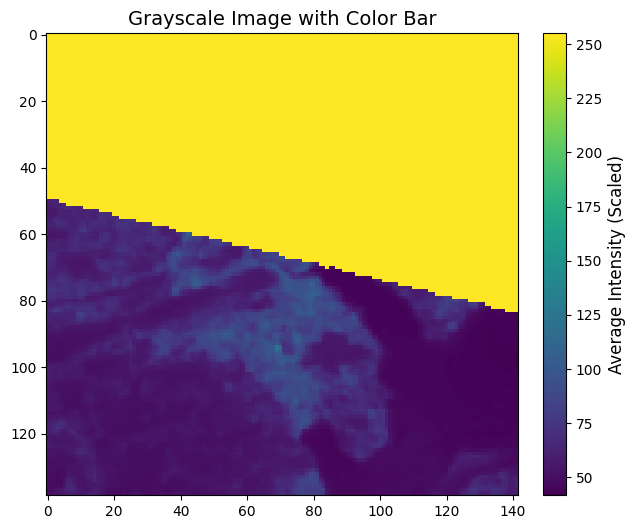

Before filtering:
Original image - Min: 0, Max: 255
Grayscale image - Min: 41.666666666666664, Max: 255.0

After filtering:
Original image (valid pixels) - Min: 0, Max: 255
Grayscale image (valid pixels) - Min: 41.666666666666664, Max: 123.0
Mean temperature of valid pixels: 59.02 °C
Unique valid pixel values: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  81  82  86  88  95 103 114 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199
 200 201 202 203 204 205 206 20

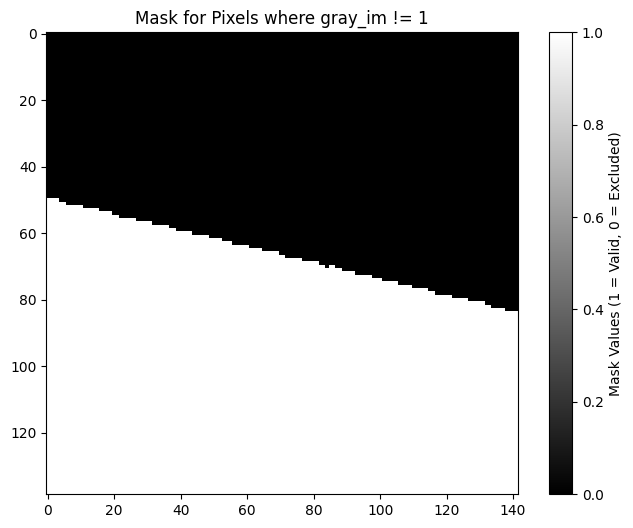

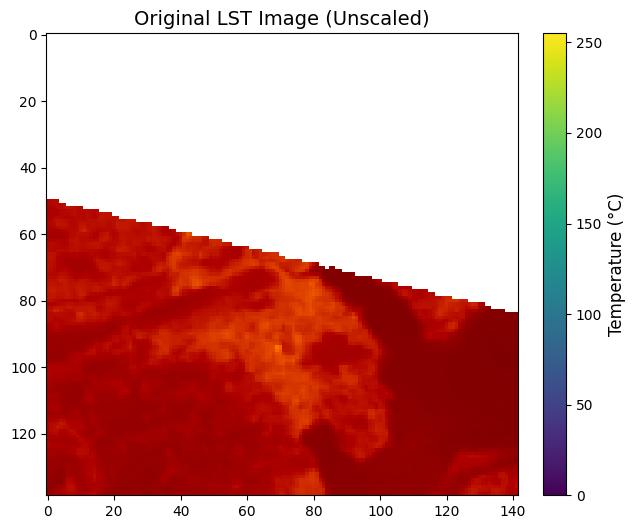

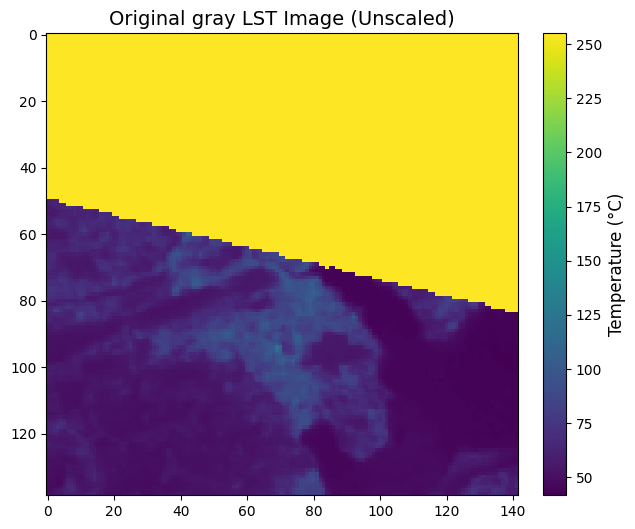

Overall mean temperature of the image: 153.52 °C
------------------


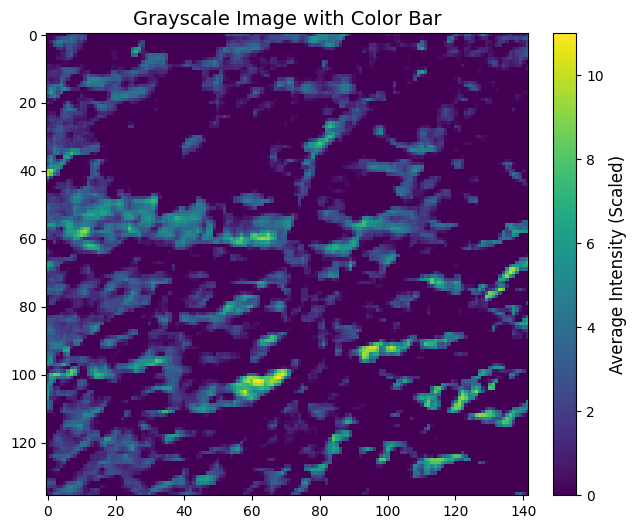

Before filtering:
Original image - Min: 0, Max: 33
Grayscale image - Min: 0.0, Max: 11.0

After filtering:
Original image (valid pixels) - Min: 0, Max: 33
Grayscale image (valid pixels) - Min: 0.0, Max: 11.0
Mean temperature of valid pixels: 59.02 °C
Unique valid pixel values: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  81  82  86  88  95 103 114 125 126 127
 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145
 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163
 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179 180 181
 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197 198 199
 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215 

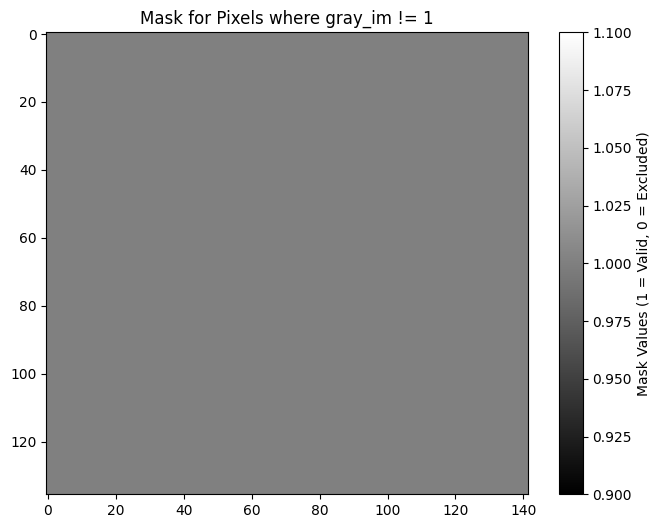

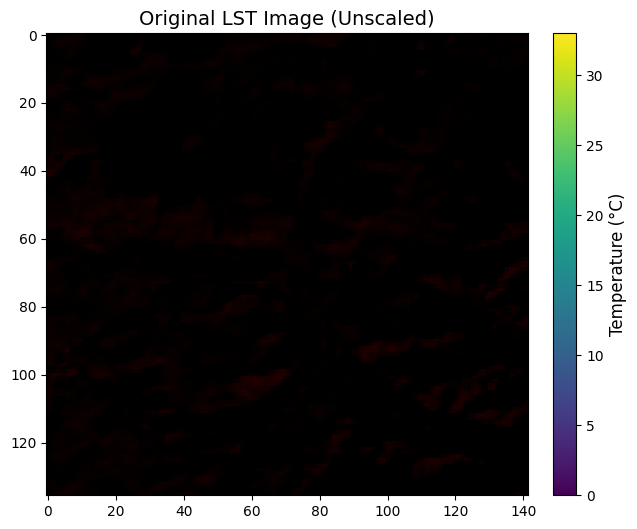

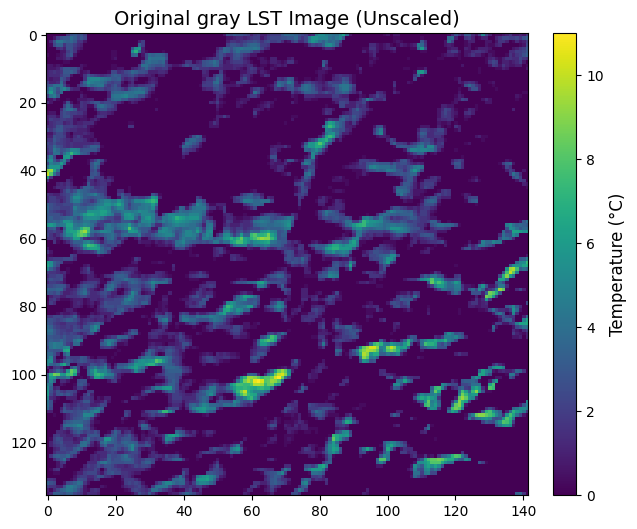

Overall mean temperature of the image: 1.02 °C


In [121]:
import numpy as np
import matplotlib.pyplot as plt

# Function to process and visualize an image
def process_and_visualize_image(image_path):
    # Load the image
    im, m = load_raster(image_path, True)

    # Scale the image
    scaled_im = im
    #np.clip(im * (6 / 255), 0, 1)
    # Convert to grayscale (average of RGB channels)
    gray_im = scaled_im.mean(axis=-1)

    # Visualize the grayscale image with a color bar
    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(gray_im, cmap='viridis')
    ax.set_title("Grayscale Image with Color Bar", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Average Intensity (Scaled)', fontsize=12)
    plt.show()

    # Print min and max values before filtering
    print("Before filtering:")
    print(f"Original image - Min: {np.min(im)}, Max: {np.max(im)}")
    print(f"Grayscale image - Min: {np.min(gray_im)}, Max: {np.max(gray_im)}")

    # Create a mask and filter valid values
    mask = (gray_im != 255)  # Mask where gray_im is not 1
    valid_pixels_original = im[mask]  # Filter original image
    valid_pixels_gray = gray_im[mask]  # Filter grayscale image

    # Print min and max values after filtering
    print("\nAfter filtering:")
    print(f"Original image (valid pixels) - Min: {np.min(valid_pixels_original)}, Max: {np.max(valid_pixels_original)}")
    print(f"Grayscale image (valid pixels) - Min: {np.min(valid_pixels_gray)}, Max: {np.max(valid_pixels_gray)}")

    mean_valid_temperature = np.mean(valid_values)

    # Print statistics
    print(f"Mean temperature of valid pixels: {mean_valid_temperature:.2f} °C")
    print(f"Unique valid pixel values: {np.unique(valid_values)}")
    print(f"Mean of valid pixels (grayscale): {np.mean(gray_im[mask]):.2f}")
    print(f"Unique values in the original image: {np.unique(im)}")

    # Visualize the mask
    plt.figure(figsize=(8, 6))
    plt.imshow(mask, cmap="gray")
    plt.title("Mask for Pixels where gray_im != 1")
    plt.colorbar(label="Mask Values (1 = Valid, 0 = Excluded)")
    plt.show()

    # Visualize the original image with a color bar
    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(im, cmap='viridis')
    ax.set_title("Original LST Image (Unscaled)", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Temperature (°C)', fontsize=12)
    plt.show()

    fig, ax = plt.subplots(figsize=(8, 6))
    cax = ax.imshow(im.mean(axis=-1), cmap='viridis')
    ax.set_title("Original gray LST Image (Unscaled)", fontsize=14)
    cbar = plt.colorbar(cax, ax=ax, fraction=0.046, pad=0.04)
    cbar.set_label('Temperature (°C)', fontsize=12)
    plt.show()

    # Print more statistics
    mean_temperature = np.nanmean(im)
    print(f"Overall mean temperature of the image: {mean_temperature:.2f} °C")

# Process and visualize the first image
process_and_visualize_image('../data/preprocessed/lst/cell_52/image_2015-09.tiff')
print('------------------')
# Process and visualize the second image
process_and_visualize_image('../data/preprocessed/lst/cell_33/image_2021-12.tiff')


In [117]:
img1, m = load_raster('../data/preprocessed/lst/cell_52/image_2015-09.tiff', True)
img2, m = load_raster('../data/preprocessed/lst/cell_33/image_2021-12.tiff', True)

gray_im = img1.mean(axis=-1)  # Promedio de los canales RGB

mask = (gray_im != 255)
valid_values = img1[mask]

combined_min = min(np.min(valid_values), np.min(img2))  # Mínimo entre las dos imágenes
combined_max = max(np.max(valid_values), np.max(img2))

print(combined_min,combined_max)

normalized_img1 = normalize_min_max(img1, combined_min, combined_max)
normalized_img2 = normalize_min_max(img2, combined_min, combined_max)

0 255


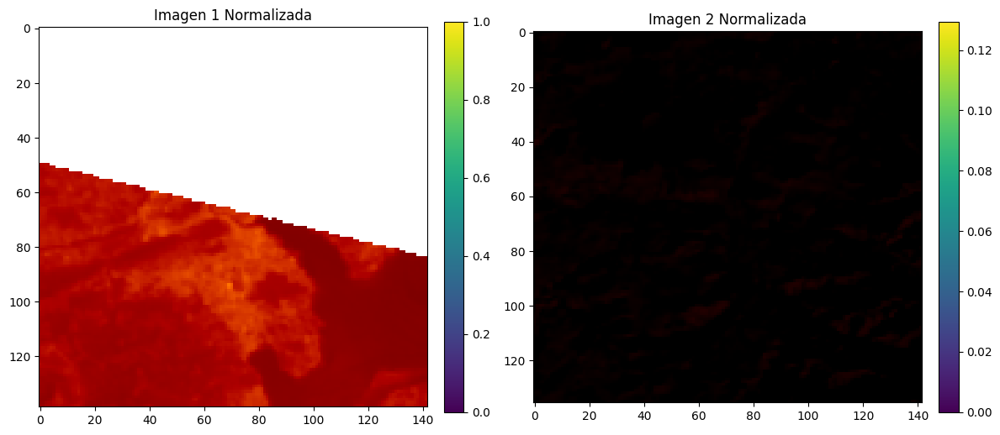

In [118]:
# Crear subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# Normalizar y graficar la primera imagen
cax1 = ax[0].imshow(normalized_img1, cmap="viridis")
cbar1 = plt.colorbar(cax1, ax=ax[0], fraction=0.046, pad=0.04)
ax[0].set_title("Imagen 1 Normalizada")

# Normalizar y graficar la segunda imagen
cax2 = ax[1].imshow(normalized_img2, cmap="viridis")
cbar2 = plt.colorbar(cax2, ax=ax[1], fraction=0.046, pad=0.04)
ax[1].set_title("Imagen 2 Normalizada")

# Mostrar todos los gráficos juntos
plt.tight_layout()
plt.show()


['2013-08', '2014-02', '2015-05', '2018-06', '2020-03', '2020-06', '2021-09', '2022-03', '2022-08', '2022-12', '2023-02', '2023-10', '2023-12']


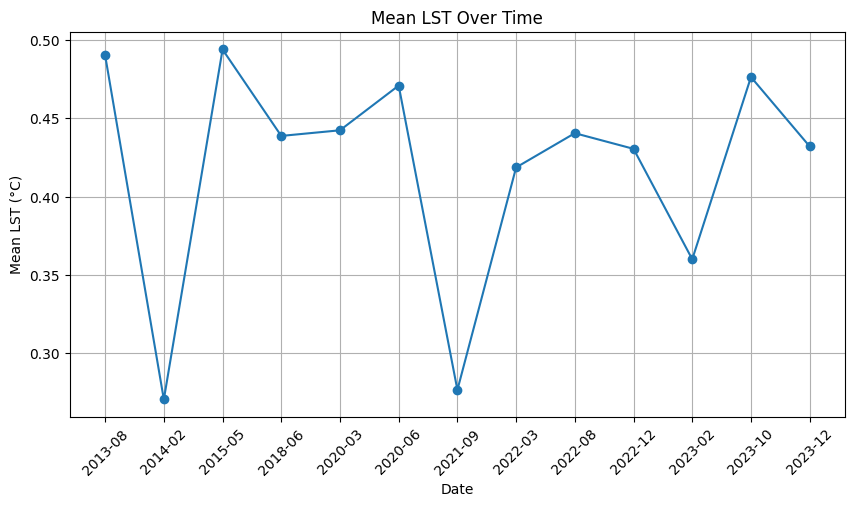

['2013-07', '2014-01', '2015-07', '2015-12', '2016-08', '2018-04', '2019-02', '2019-06', '2021-02', '2022-04', '2022-05', '2022-11', '2024-01', '2024-02', '2024-06']


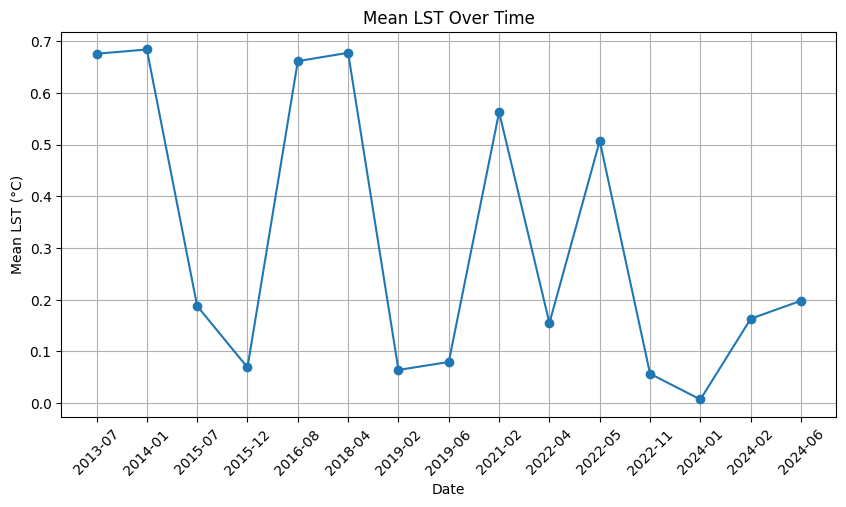

['2013-12', '2014-06', '2015-05', '2015-06', '2016-06', '2017-01', '2017-08', '2017-09', '2017-11', '2017-12', '2018-01', '2018-08', '2018-12', '2019-01', '2019-03', '2019-07', '2020-03', '2020-07', '2020-10', '2021-01', '2021-08', '2021-12', '2022-09', '2022-12', '2023-01', '2023-02', '2023-04', '2023-05', '2023-12', '2024-01', '2024-08', '2024-09']


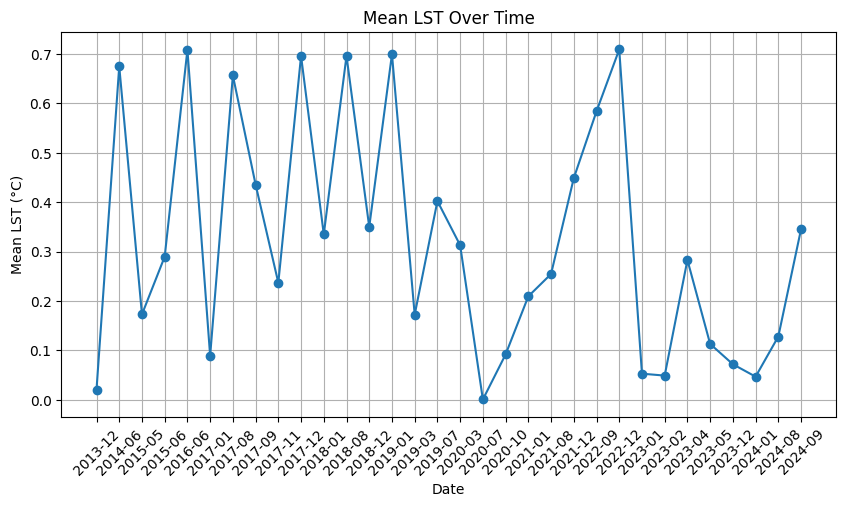

['2013-07', '2014-01', '2014-02', '2016-08', '2016-10', '2017-02', '2019-01', '2019-04', '2019-08', '2020-01', '2022-01', '2022-11', '2022-12', '2023-05', '2023-07', '2023-09', '2023-10', '2024-06', '2024-08']


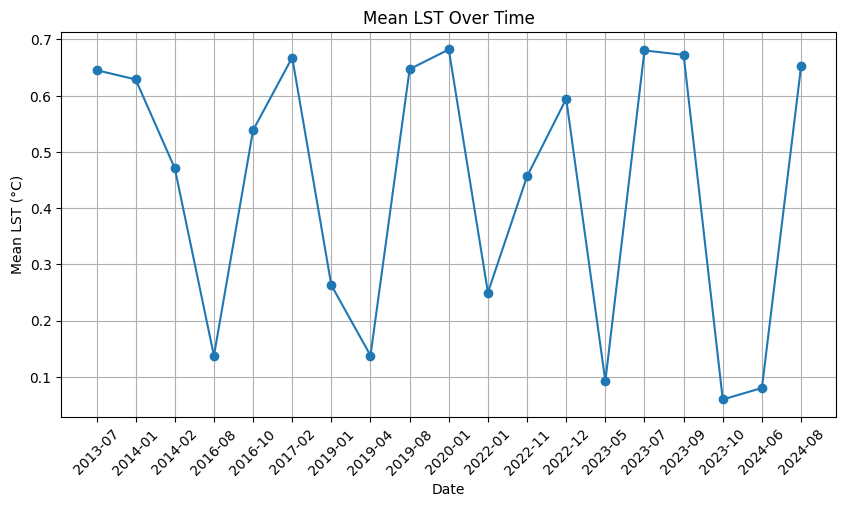

['2014-04', '2015-08', '2015-11', '2015-12', '2016-05', '2016-07', '2017-04', '2017-07', '2018-01', '2018-08', '2018-11', '2019-04', '2019-06', '2019-08', '2019-09', '2019-12', '2020-06', '2020-12', '2022-10', '2023-07', '2023-12', '2024-01', '2024-02', '2024-07']


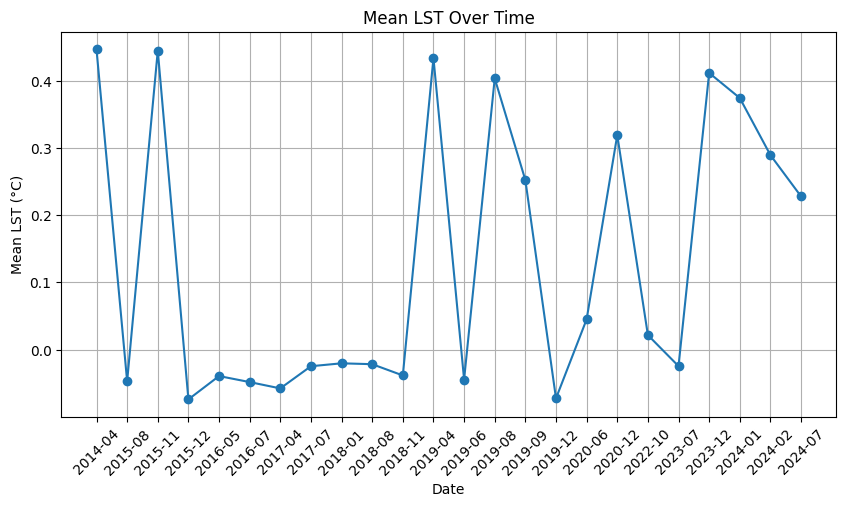

['2013-08', '2013-09', '2013-12', '2014-01', '2014-08', '2014-09', '2014-10', '2014-12', '2015-01', '2015-03', '2015-05', '2015-08', '2016-03', '2016-05', '2016-07', '2016-08', '2017-04', '2017-12', '2018-05', '2018-09', '2018-11', '2018-12', '2019-06', '2019-07', '2019-08', '2020-01', '2020-07', '2020-11', '2020-12', '2021-01', '2021-05', '2021-08', '2021-10', '2023-02', '2023-06', '2023-10', '2024-05', '2024-08', '2024-09']


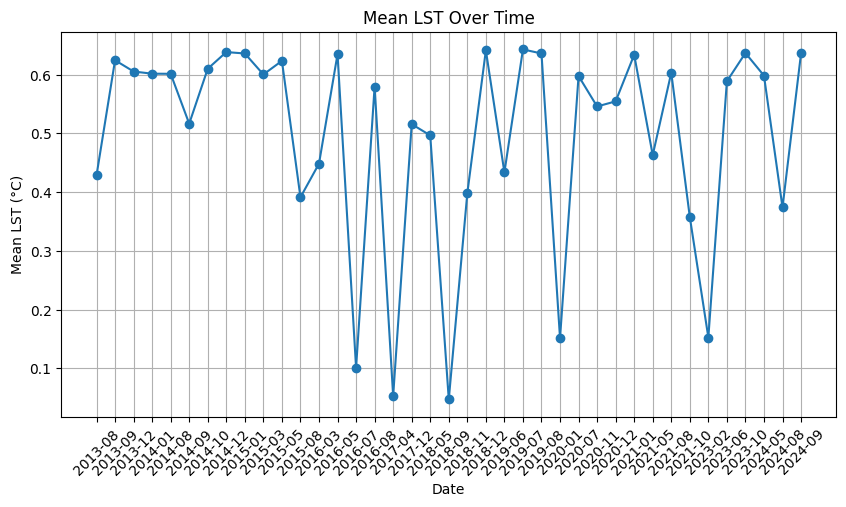

['2013-06', '2015-03', '2015-10', '2016-03', '2016-11', '2017-10', '2019-03', '2019-08', '2023-10']


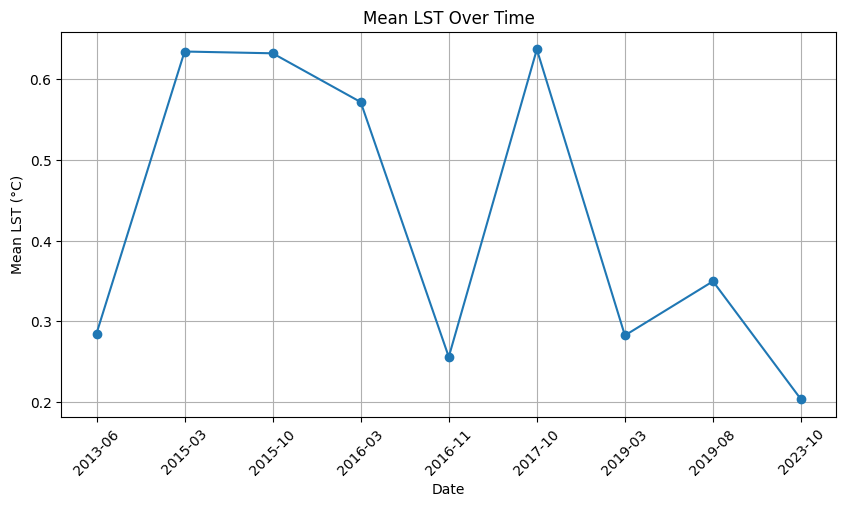

['2013-04', '2013-05', '2014-01', '2014-04', '2015-03', '2015-10', '2016-04', '2016-05', '2016-10', '2018-07', '2018-10', '2019-06', '2021-04', '2021-05', '2022-09', '2022-10', '2023-10']


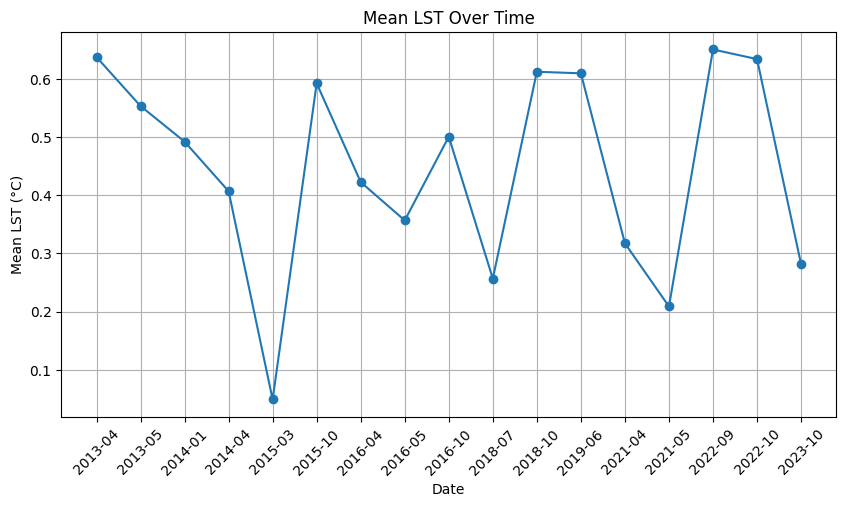

['2013-09', '2015-09', '2016-11', '2017-09', '2018-01', '2018-11', '2019-01', '2019-05', '2019-11', '2020-05', '2020-11', '2021-04', '2022-10', '2023-04', '2023-08']


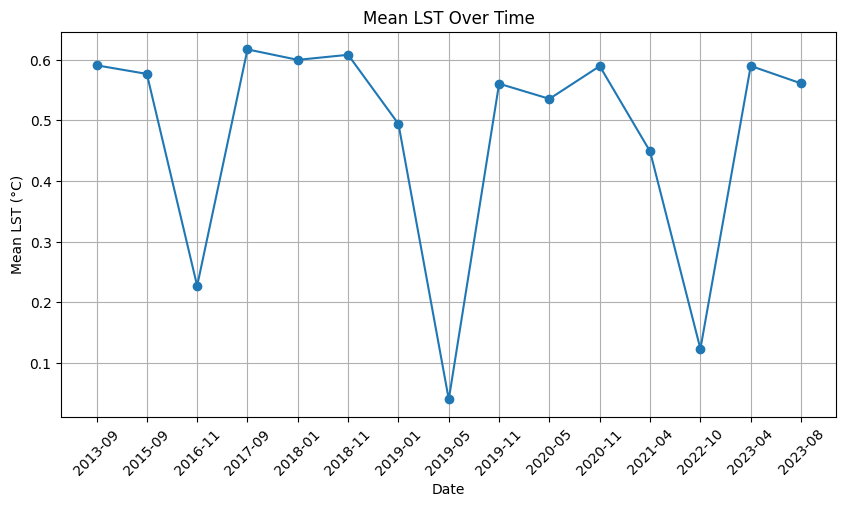

['2013-03', '2013-04', '2014-07', '2015-04', '2015-05', '2015-06', '2015-12', '2016-04', '2016-08', '2017-03', '2017-05', '2017-09', '2017-10', '2019-04', '2019-10', '2020-01', '2020-07', '2021-01', '2021-03', '2021-11', '2022-01', '2022-11', '2023-09', '2024-01', '2024-02', '2024-06', '2024-07', '2024-08']


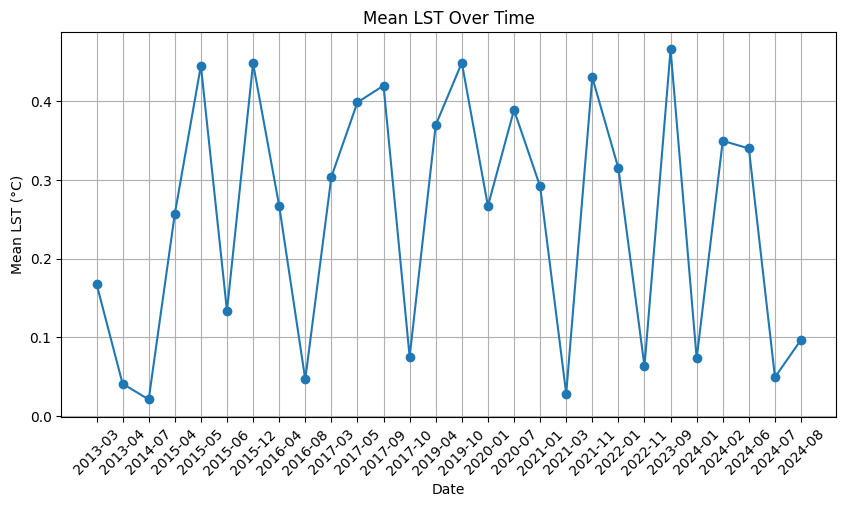

['2013-09', '2013-12', '2014-03', '2014-05', '2015-01', '2016-04', '2016-06', '2017-06', '2018-04', '2019-05', '2019-08', '2020-04', '2020-09', '2022-12', '2024-06', '2024-08']


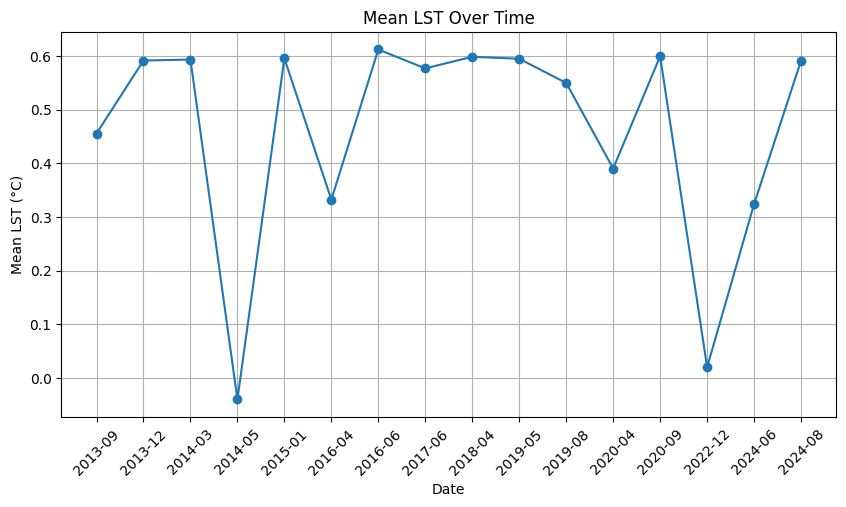

['2013-09', '2013-10', '2014-07', '2014-09', '2015-10', '2015-12', '2017-08', '2018-03', '2018-07', '2018-10', '2018-12', '2019-02', '2019-03', '2019-05', '2019-07', '2021-05', '2021-10', '2022-11', '2024-06', '2024-09']


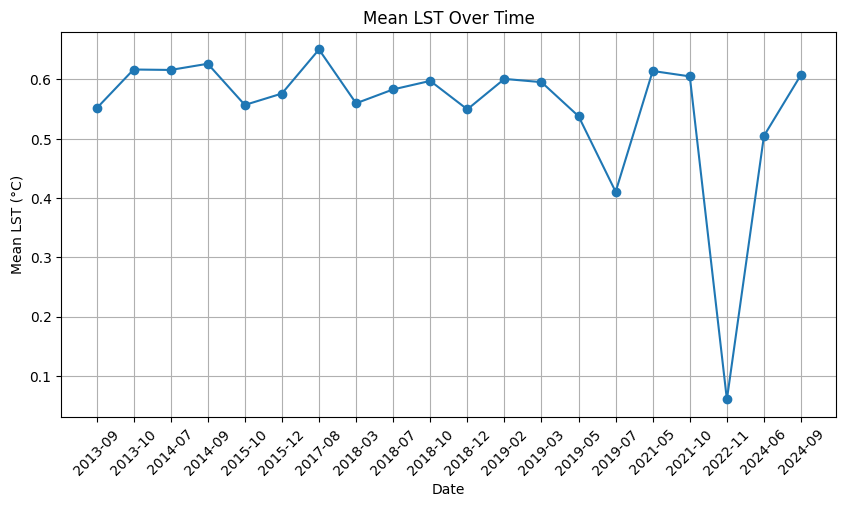

['2013-05', '2013-11', '2014-08', '2014-11', '2016-03', '2016-07', '2016-10', '2016-12', '2017-04', '2019-02', '2019-07', '2021-03', '2021-08', '2022-06', '2023-05', '2023-07', '2023-08', '2023-09', '2023-11', '2024-05', '2024-06', '2024-08', '2024-09']


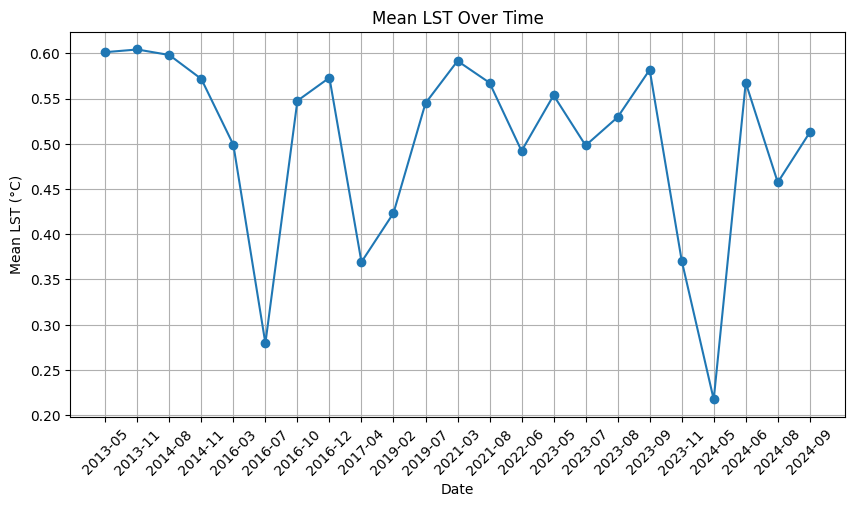

['2013-05', '2013-08', '2014-03', '2014-10', '2016-12', '2017-05', '2017-06', '2017-09', '2017-10', '2019-03', '2021-07', '2022-06', '2022-09', '2023-04', '2023-06', '2023-08', '2023-09', '2024-03', '2024-05']


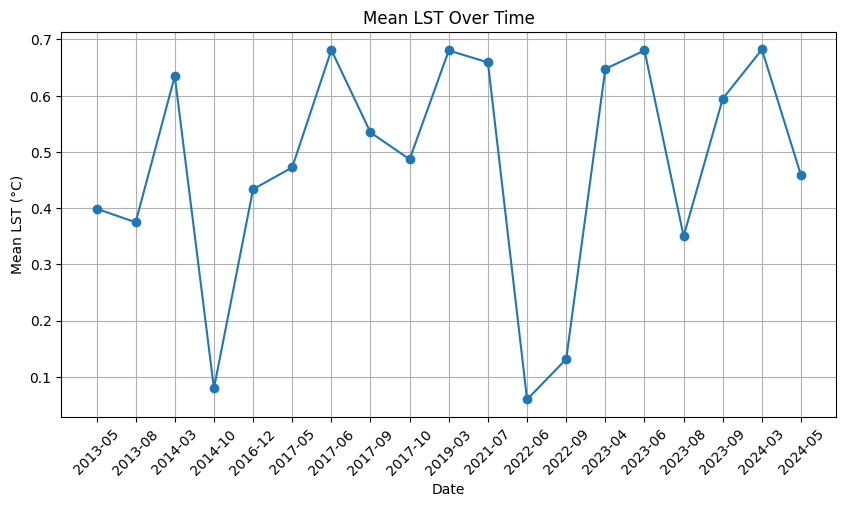

['2014-02', '2015-05', '2015-08', '2015-12', '2016-02', '2016-05', '2017-01', '2018-05', '2018-06', '2018-07', '2018-08', '2018-09', '2020-02', '2020-09', '2021-01', '2021-06', '2021-11', '2022-03', '2022-06', '2022-09', '2023-04', '2024-04']


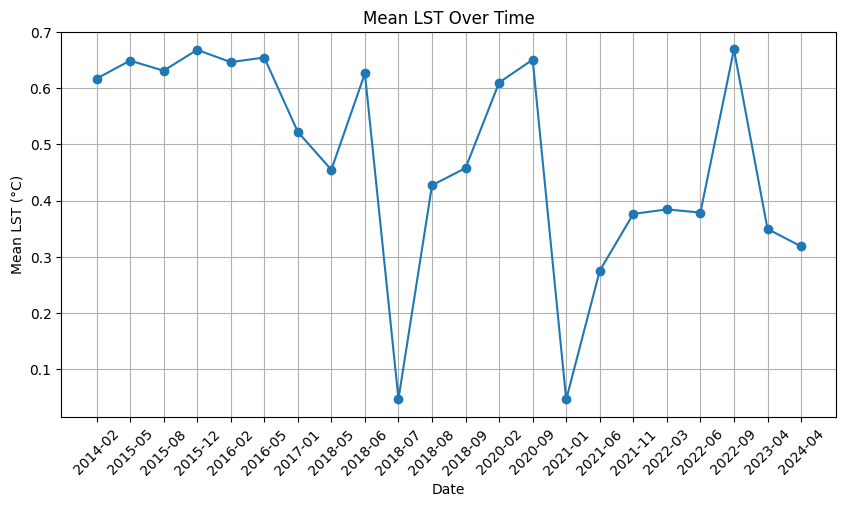

['2013-11', '2014-04', '2014-06', '2014-10', '2014-11', '2015-07', '2016-01', '2016-02', '2016-07', '2016-08', '2016-10', '2017-04', '2018-02', '2018-03', '2019-11', '2020-01', '2020-02', '2020-06', '2021-08', '2022-06', '2022-07', '2022-11', '2023-01', '2024-02', '2024-08']


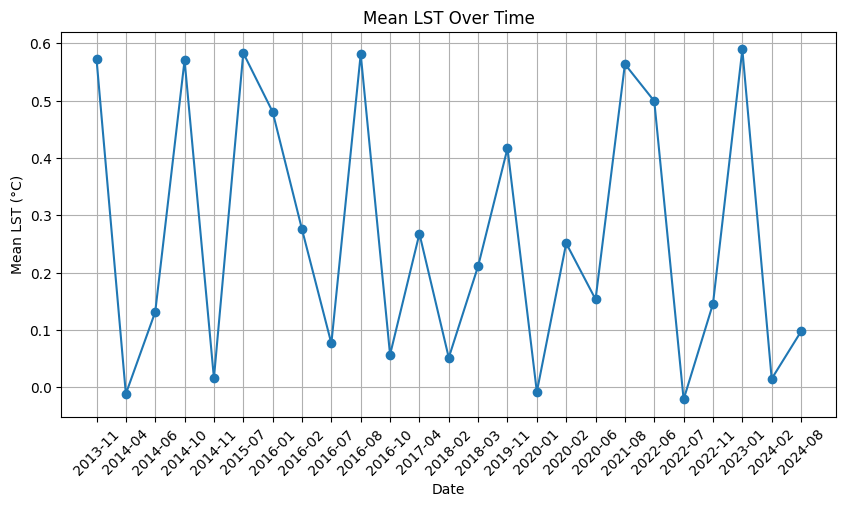

['2013-07', '2013-09', '2013-11', '2013-12', '2014-02', '2014-08', '2015-04', '2016-03', '2016-07', '2016-11', '2017-07', '2018-04', '2018-07', '2018-10', '2019-02', '2019-05', '2020-10', '2021-01', '2021-04', '2021-08', '2022-10', '2023-02', '2023-05', '2023-10', '2024-01', '2024-02']


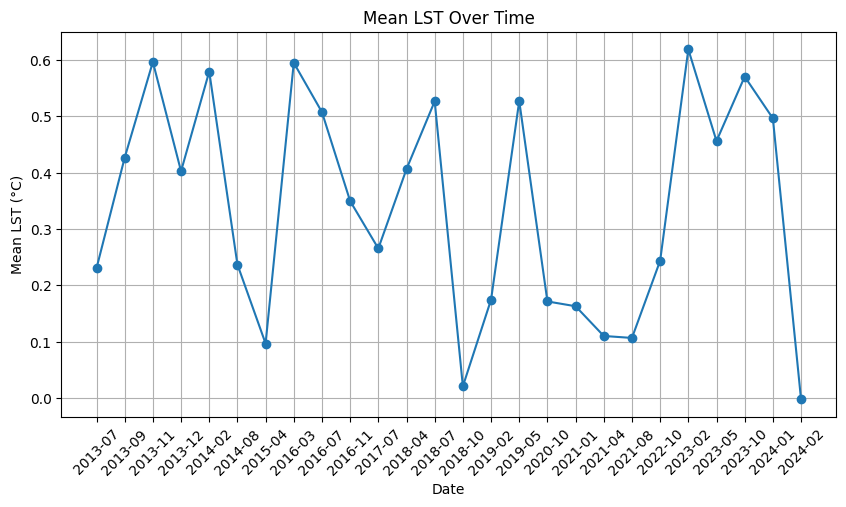

['2013-03', '2014-07', '2014-09', '2015-05', '2015-11', '2016-02', '2016-12', '2017-01', '2017-04', '2018-03', '2018-06', '2020-02', '2020-12', '2023-04', '2023-09', '2024-07']


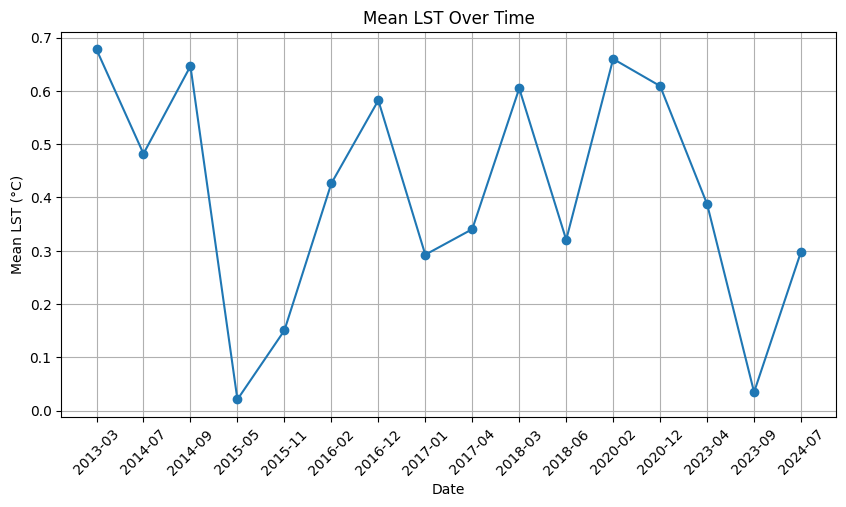

['2013-09', '2013-10', '2014-05', '2014-11', '2015-01', '2015-10', '2015-12', '2016-01', '2017-06', '2018-02', '2019-02', '2019-08', '2020-01', '2021-10', '2022-12', '2023-06', '2024-03', '2024-07', '2024-09']


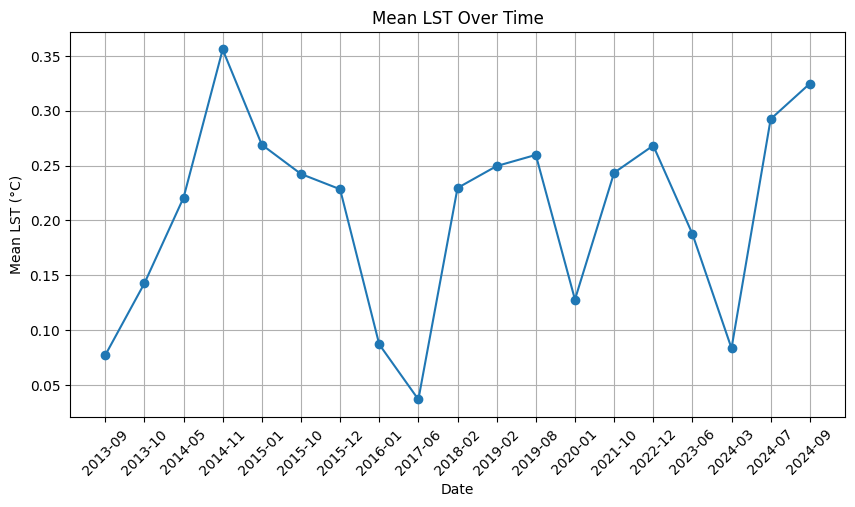

['2013-03', '2015-03', '2016-06', '2016-09', '2017-05', '2017-09', '2018-05', '2018-08', '2018-11', '2019-04', '2019-05', '2019-06', '2019-11', '2020-02', '2021-03', '2021-07', '2021-09', '2022-09', '2022-10', '2023-04', '2023-09', '2024-03']


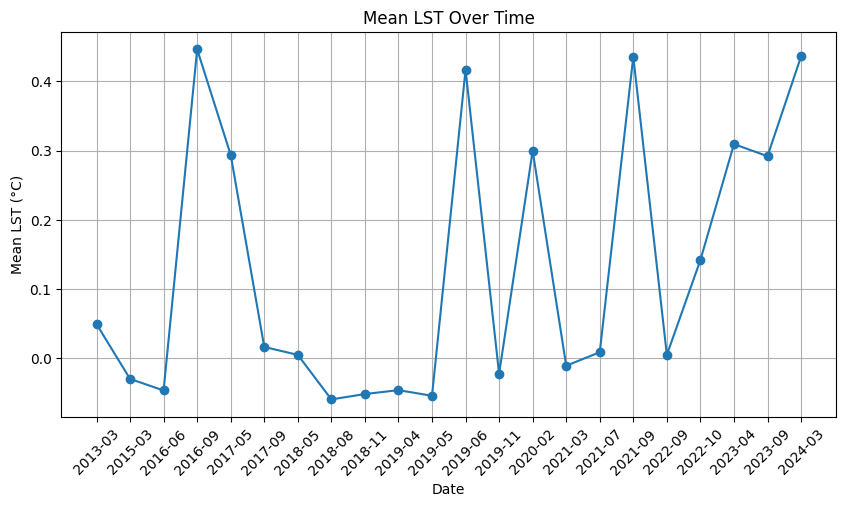

['2013-11', '2014-09', '2015-02', '2015-08', '2016-01', '2018-02', '2018-08', '2019-08', '2020-09', '2022-01', '2023-11']


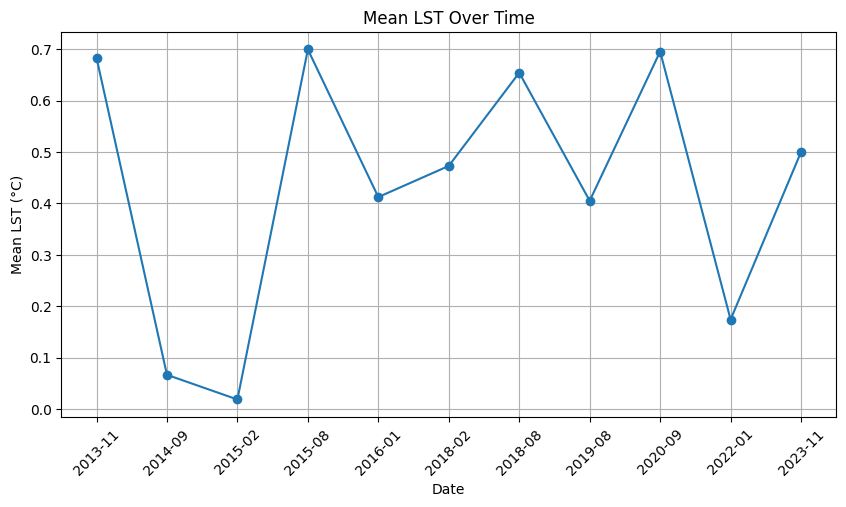

['2013-03', '2013-05', '2013-07', '2014-04', '2014-06', '2014-07', '2014-11', '2015-02', '2015-03', '2015-04', '2015-05', '2015-08', '2016-10', '2016-11', '2017-11', '2017-12', '2018-04', '2018-05', '2018-06', '2018-08', '2019-01', '2019-04', '2019-09', '2019-11', '2020-02', '2020-04', '2020-06', '2020-07', '2021-04', '2021-05', '2021-06', '2021-07', '2021-09', '2021-11', '2022-04', '2022-06', '2022-10', '2023-04', '2023-05', '2023-09', '2023-10', '2024-01', '2024-06', '2024-08']


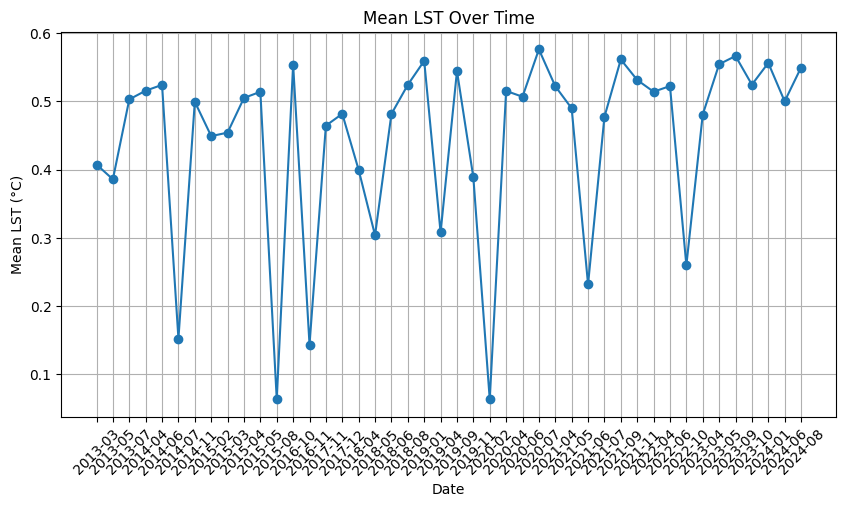

['2013-04', '2013-05', '2013-10', '2013-12', '2015-03', '2015-07', '2016-09', '2017-01', '2017-03', '2018-03', '2018-10', '2019-06', '2020-02', '2020-08', '2020-11', '2021-06', '2021-11', '2022-07', '2022-10', '2023-06', '2024-05']


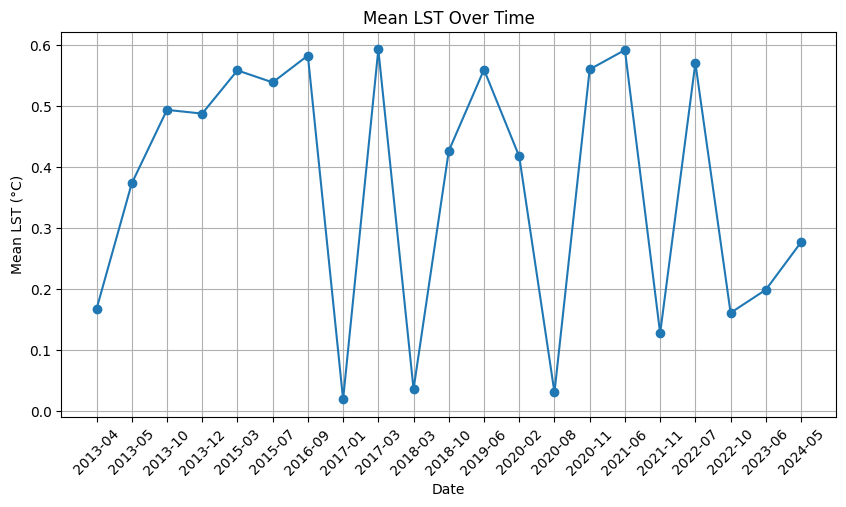

['2014-09', '2014-11', '2015-02', '2015-07', '2016-02', '2016-03', '2016-11', '2017-08', '2017-09', '2018-03', '2018-06', '2018-10', '2019-02', '2019-07', '2019-09', '2019-12', '2020-11', '2021-03', '2021-06', '2021-12', '2022-02', '2023-07', '2023-09']


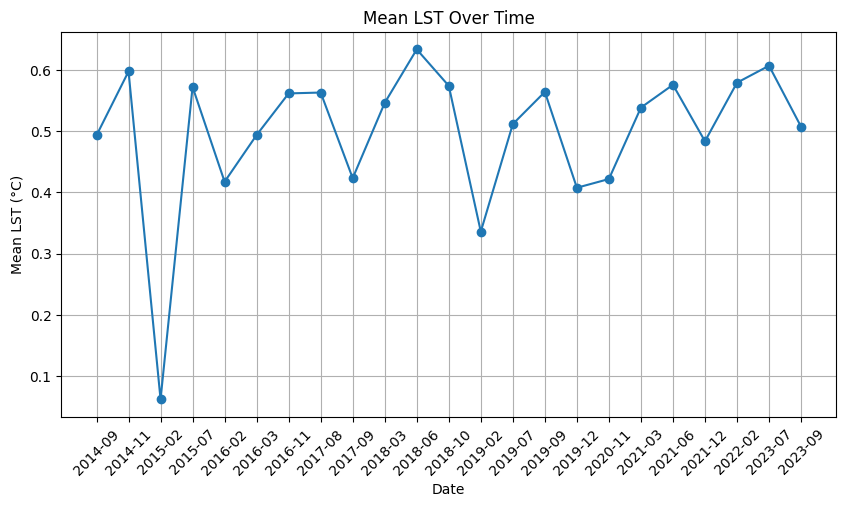

['2014-04', '2015-03', '2015-04', '2015-08', '2016-01', '2016-08', '2016-10', '2016-12', '2017-03', '2018-01', '2018-03', '2018-05', '2018-12', '2019-01', '2019-02', '2020-12', '2022-12', '2023-05', '2024-07']


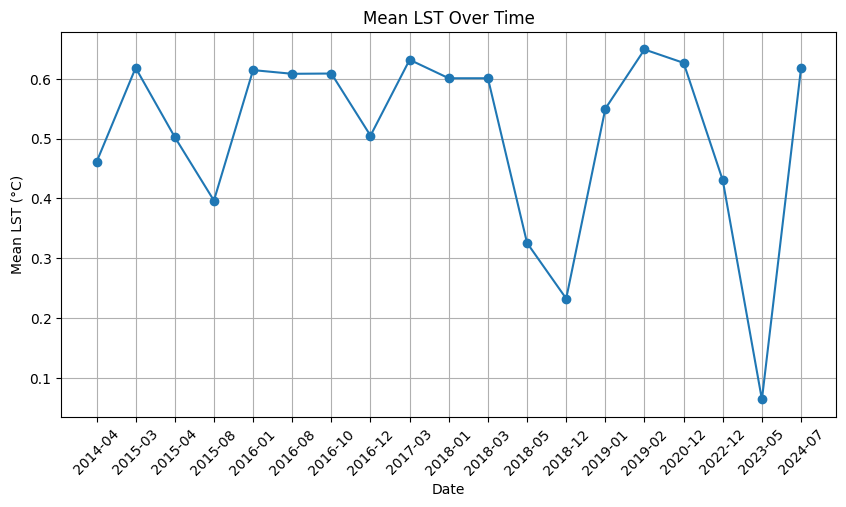

['2014-03', '2016-03', '2016-11', '2017-03', '2017-11', '2019-11', '2021-04', '2022-09', '2023-04', '2024-02', '2024-04']


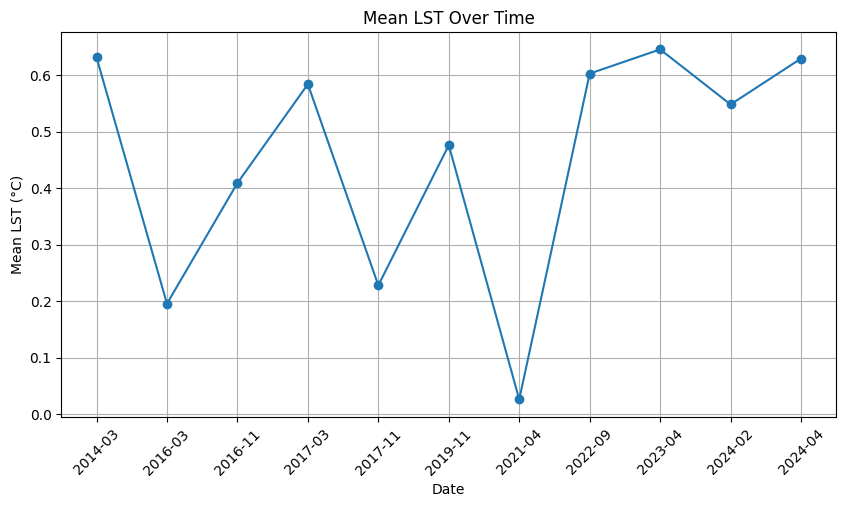

['2013-07', '2014-09', '2015-05', '2015-12', '2019-08', '2020-10', '2021-06', '2022-07', '2024-05']


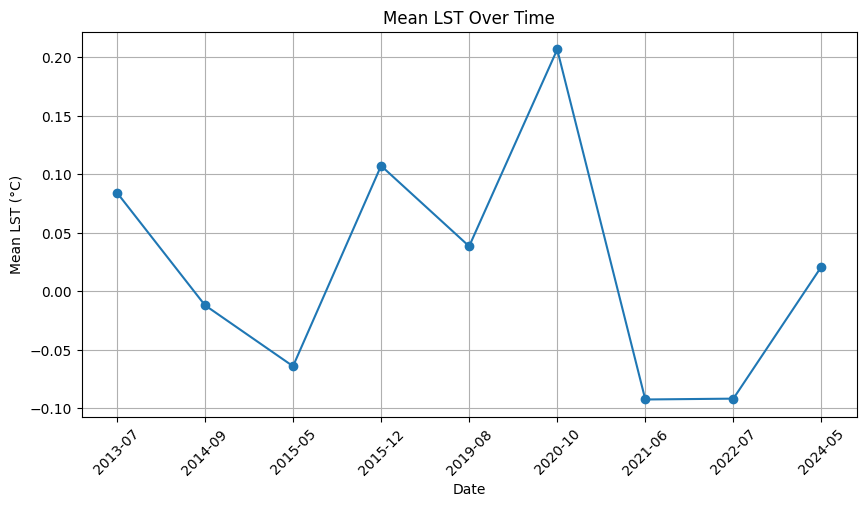

['2014-02', '2014-03', '2014-04', '2014-07', '2014-08', '2015-03', '2016-03', '2016-11', '2018-07', '2018-08', '2018-10', '2019-06', '2020-01', '2020-02', '2020-04', '2020-10', '2020-12', '2021-04', '2021-05', '2021-06', '2021-08', '2023-01', '2023-05', '2023-07', '2023-10', '2024-01', '2024-09']


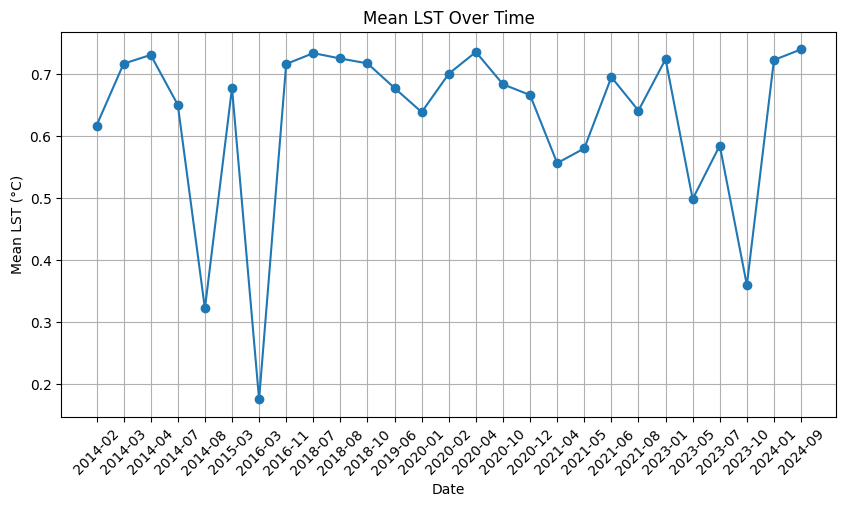

['2014-04', '2014-05', '2014-07', '2015-04', '2015-05', '2015-07', '2015-11', '2016-08', '2017-04', '2018-04', '2018-06', '2018-07', '2018-09', '2019-04', '2019-11', '2020-04', '2020-06', '2020-08', '2020-10', '2021-01', '2021-03', '2021-04', '2022-10', '2023-03', '2023-05', '2024-06']


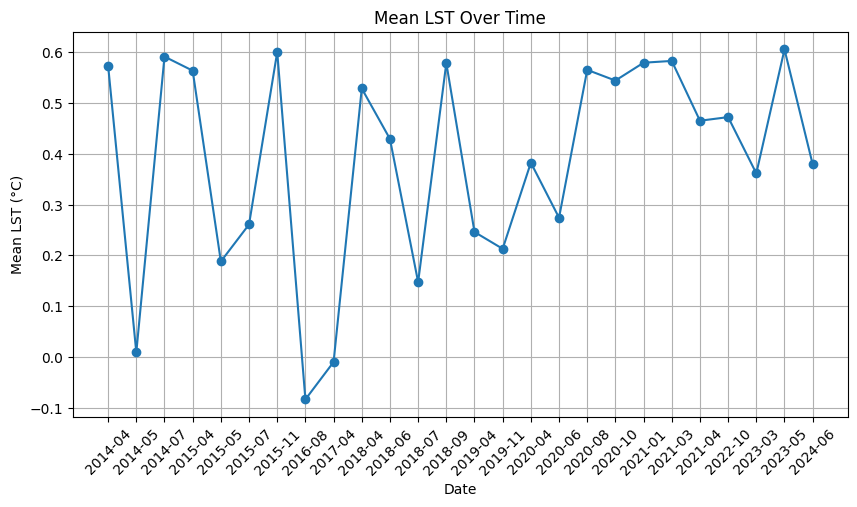

['2013-04', '2013-05', '2013-11', '2014-01', '2014-06', '2014-07', '2015-03', '2015-06', '2015-11', '2015-12', '2016-03', '2016-05', '2016-08', '2017-01', '2017-02', '2018-01', '2018-06', '2018-07', '2019-01', '2019-03', '2019-04', '2019-09', '2020-05', '2020-08', '2021-03', '2021-06', '2021-08', '2022-03', '2022-05', '2022-07', '2022-09', '2023-03', '2023-09', '2024-04', '2024-06']


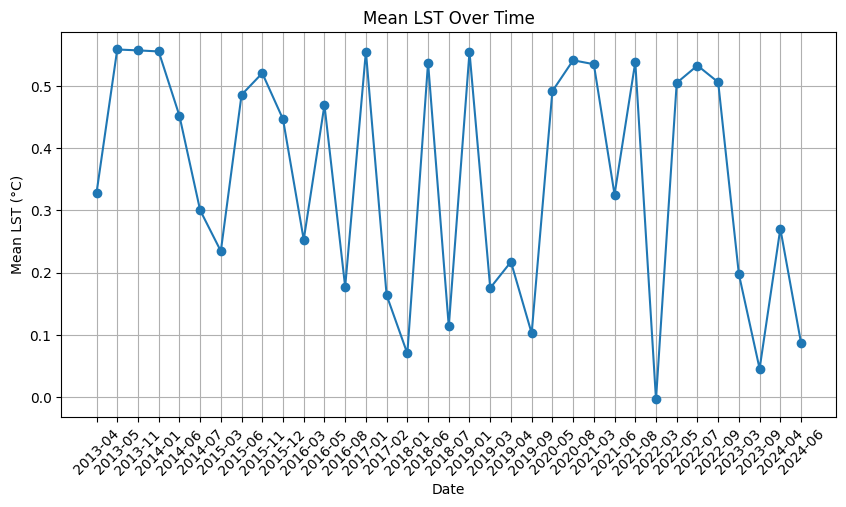

['2013-05', '2013-08', '2014-07', '2015-01', '2015-02', '2015-03', '2015-09', '2015-10', '2015-12', '2016-01', '2016-05', '2016-08', '2016-12', '2017-03', '2017-06', '2017-10', '2017-12', '2018-01', '2018-06', '2018-08', '2018-10', '2019-02', '2019-04', '2019-07', '2019-08', '2019-10', '2020-01', '2020-04', '2020-05', '2020-10', '2020-11', '2020-12', '2021-05', '2021-08', '2021-12', '2022-04', '2022-11', '2022-12', '2023-03', '2023-04', '2023-06', '2023-08', '2023-11', '2024-04', '2024-05', '2024-06']


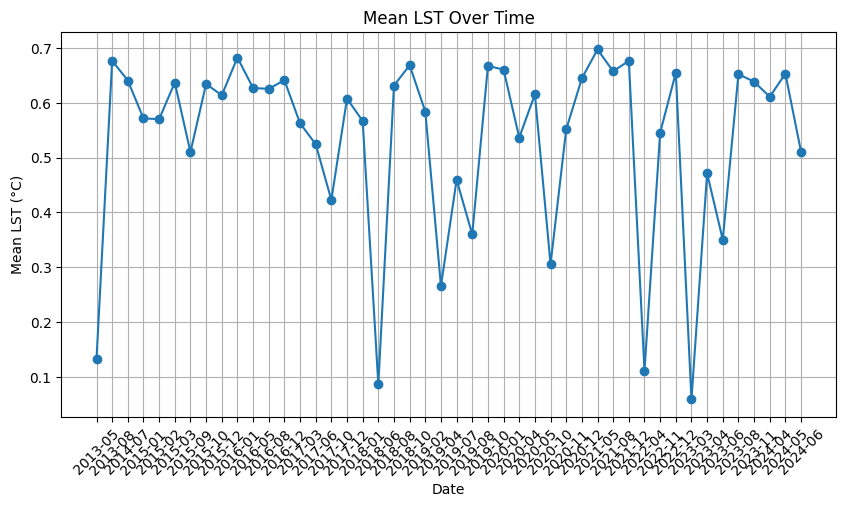

['2014-08', '2015-04', '2015-05', '2015-10', '2016-03', '2016-04', '2016-07', '2016-12', '2017-01', '2018-04', '2019-01', '2019-07', '2019-12', '2020-11', '2021-04', '2022-05', '2023-09']


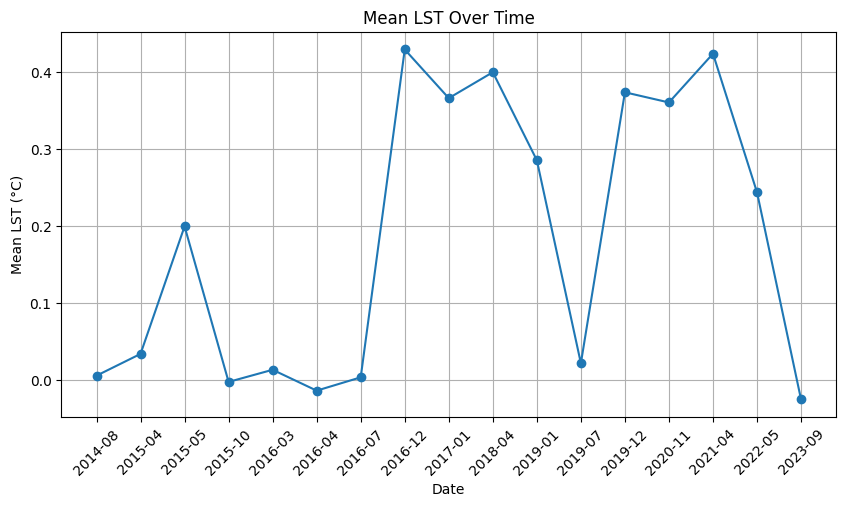

['2013-08', '2013-10', '2013-11', '2014-09', '2015-04', '2016-02', '2017-06', '2018-02', '2018-03', '2018-11', '2019-12', '2020-02', '2020-07', '2021-08', '2021-09', '2021-10', '2022-02', '2022-08', '2022-12', '2024-03', '2024-05']


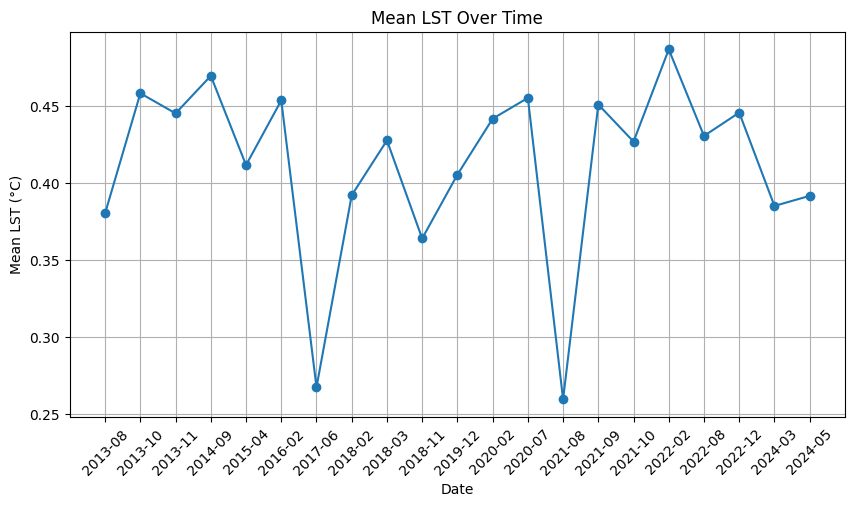

['2013-04', '2014-03', '2015-02', '2015-07', '2016-06', '2017-02', '2018-02', '2018-09', '2019-02', '2019-05', '2019-07', '2019-10', '2020-09', '2020-10', '2023-05', '2023-08', '2023-11', '2024-08', '2024-09']


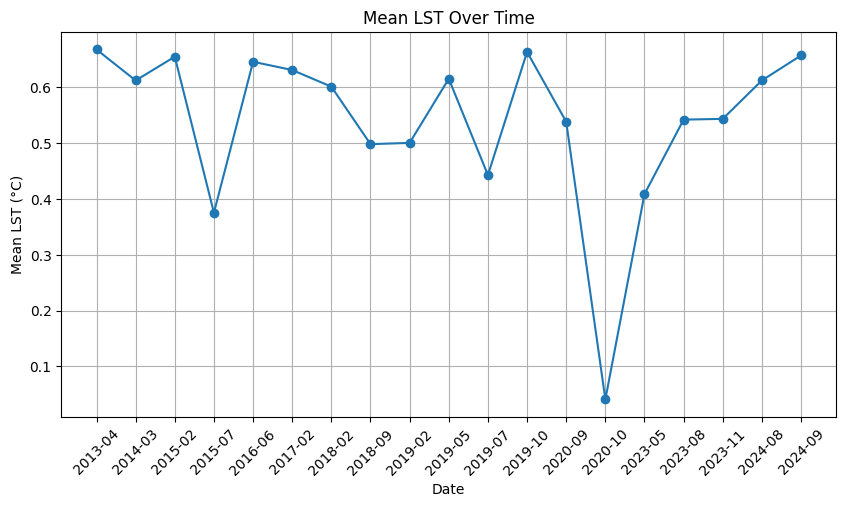

['2013-09', '2014-01', '2014-02', '2014-12', '2015-06', '2015-12', '2016-05', '2016-08', '2017-02', '2017-10', '2017-11', '2018-04', '2019-06', '2019-09', '2020-05', '2020-09', '2020-11', '2021-06', '2022-03', '2022-05', '2023-04', '2023-11', '2024-03', '2024-08']


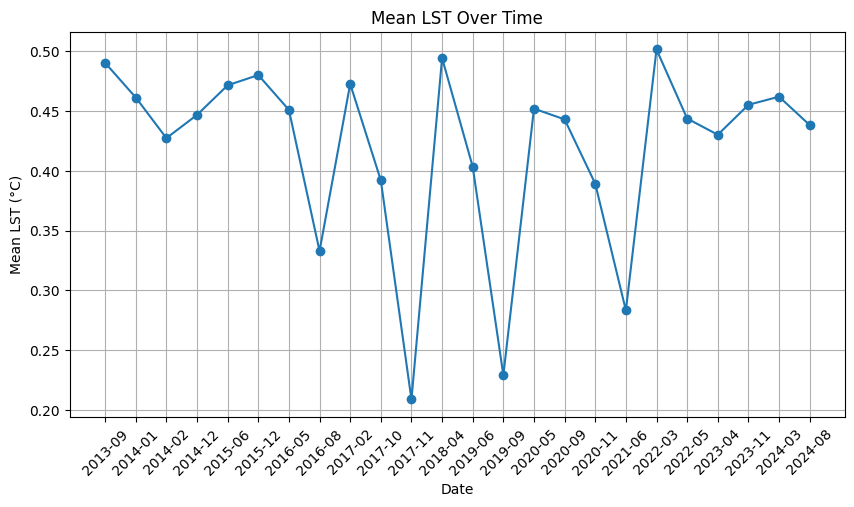

['2015-05', '2015-07', '2016-08', '2017-05', '2018-02', '2018-03', '2018-04', '2018-06', '2019-07', '2020-04', '2020-06', '2020-07', '2020-09', '2020-11', '2021-09', '2021-10', '2023-11', '2024-01', '2024-03']


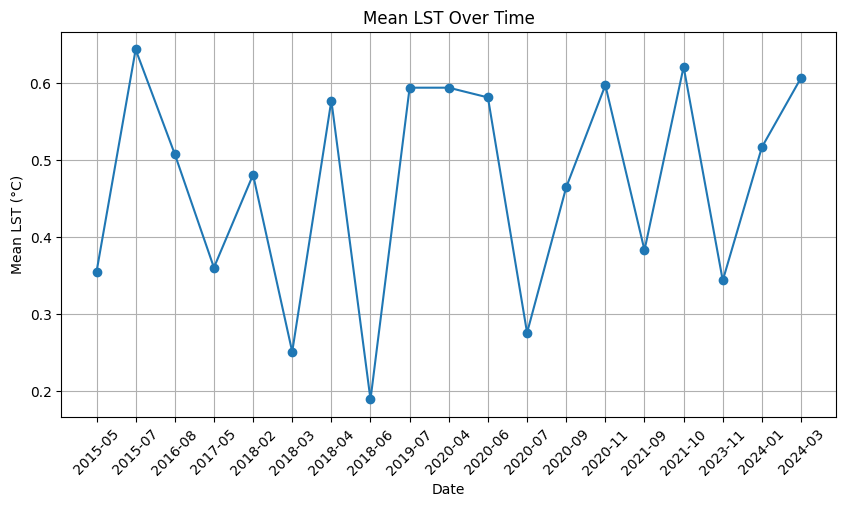

['2013-06', '2013-10', '2014-07', '2014-09', '2014-10', '2014-12', '2015-01', '2015-03', '2015-04', '2015-05', '2015-06', '2015-07', '2015-08', '2016-02', '2016-09', '2017-04', '2018-01', '2018-03', '2018-05', '2018-10', '2019-06', '2019-08', '2019-12', '2020-01', '2020-03', '2020-07', '2021-03', '2021-05', '2021-08', '2022-05', '2022-07', '2023-04', '2023-05', '2023-07', '2023-09', '2023-10', '2023-11', '2024-02', '2024-06', '2024-08', '2024-09']


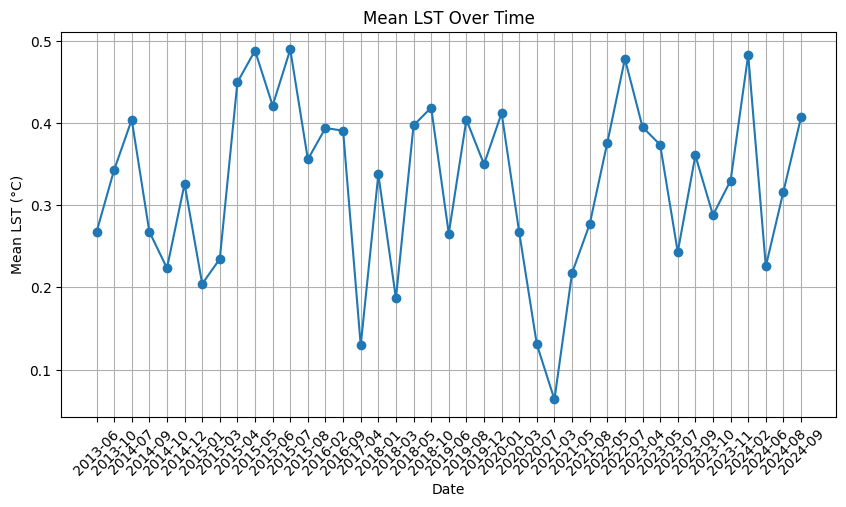

['2013-05', '2014-12', '2015-12', '2016-06', '2016-10', '2016-11', '2017-06', '2017-10', '2017-12', '2018-05', '2020-01', '2020-03', '2020-05', '2020-12', '2021-10', '2021-11', '2022-09', '2023-08', '2024-03', '2024-04']


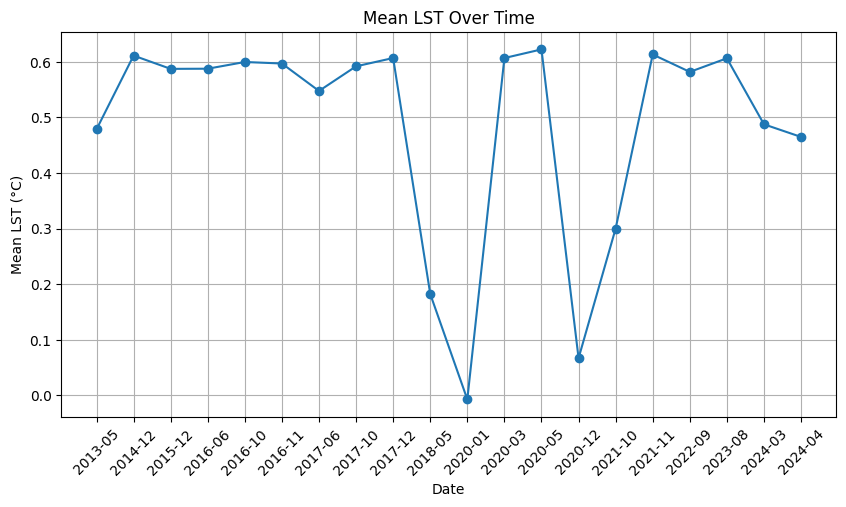

['2013-05', '2014-06', '2014-10', '2016-01', '2016-04', '2016-10', '2017-02', '2018-09', '2018-10', '2019-11', '2019-12', '2020-03', '2020-04', '2020-05', '2020-07', '2021-01', '2021-03', '2022-05', '2023-12']


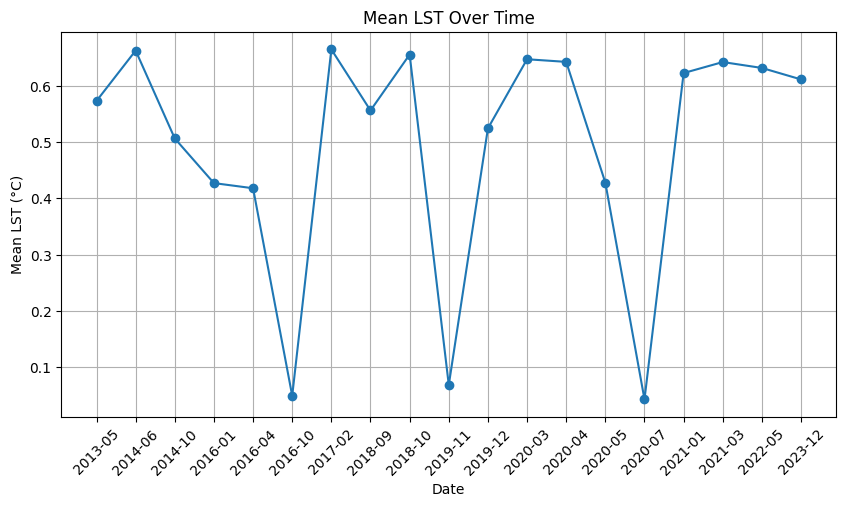

['2013-08', '2014-01', '2014-10', '2015-04', '2016-03', '2016-07', '2016-09', '2017-02', '2017-04', '2017-08', '2017-09', '2018-01', '2018-05', '2018-12', '2019-01', '2019-08', '2019-09', '2020-09', '2020-11', '2021-06', '2021-07', '2021-12', '2023-06', '2024-06']


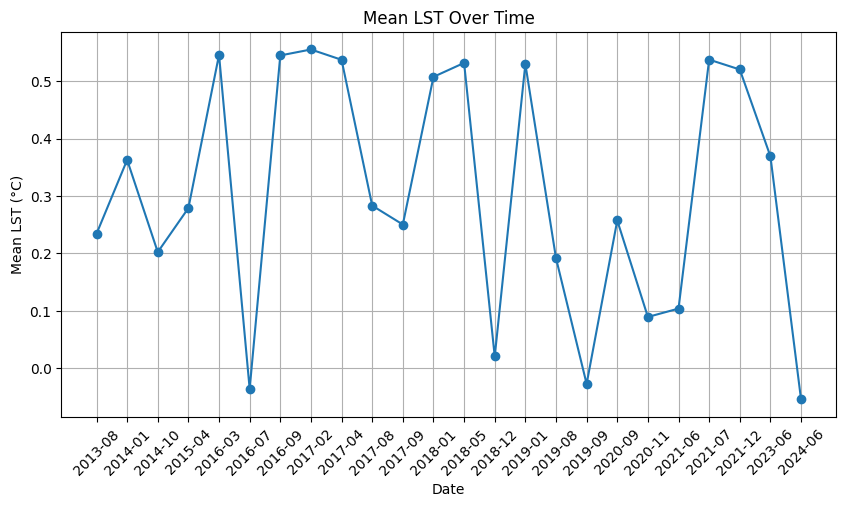

['2013-09', '2015-01', '2015-12', '2016-01', '2016-05', '2016-12', '2017-12', '2018-05', '2018-09', '2018-12', '2019-07', '2020-03', '2020-09', '2020-10', '2021-09', '2023-03', '2023-09']


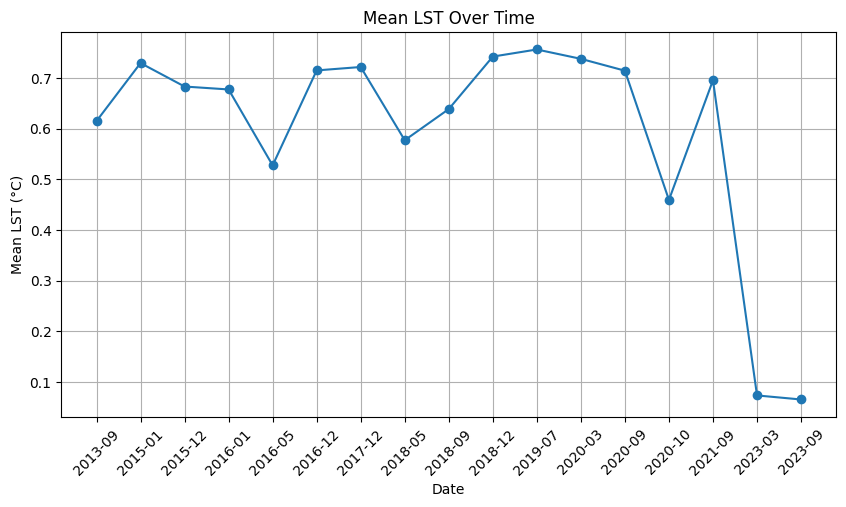

['2013-06', '2014-02', '2015-03', '2015-10', '2016-08', '2017-09', '2017-10', '2018-10', '2019-06', '2019-09', '2019-12', '2021-01', '2021-02', '2021-12', '2022-01', '2023-03', '2023-05', '2023-07', '2024-02', '2024-05']


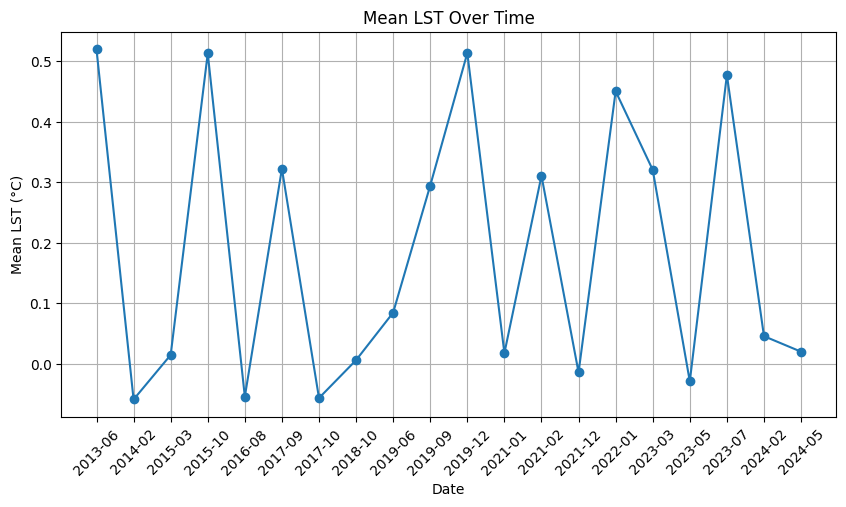

['2013-10', '2014-10', '2015-04', '2015-09', '2016-01', '2016-08', '2016-10', '2017-05', '2017-09', '2019-02', '2019-11', '2021-06', '2022-05', '2022-10', '2023-03', '2023-08', '2023-09']


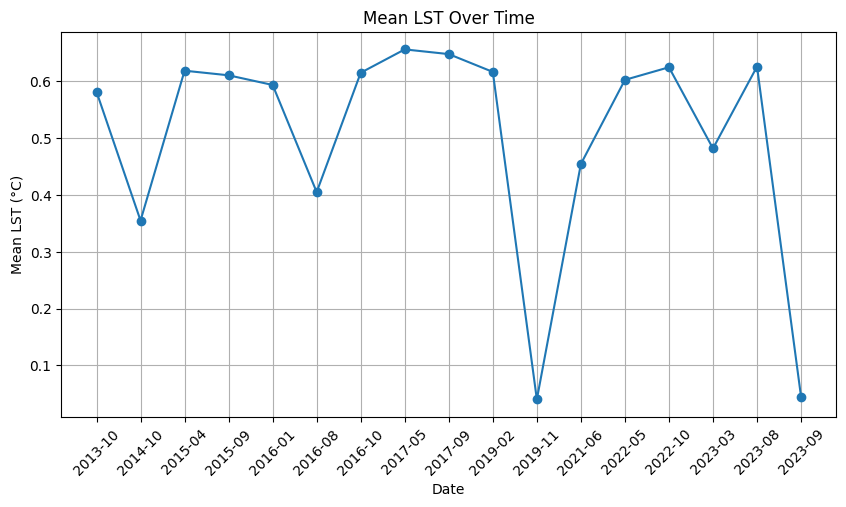

['2013-06', '2013-12', '2014-01', '2014-07', '2014-08', '2015-03', '2015-04', '2015-12', '2016-02', '2017-02', '2017-07', '2018-05', '2019-01', '2019-07', '2019-09', '2020-08', '2021-05', '2021-07', '2022-02', '2022-11', '2022-12', '2023-02', '2023-03', '2023-04', '2023-05', '2023-06', '2024-04', '2024-07']


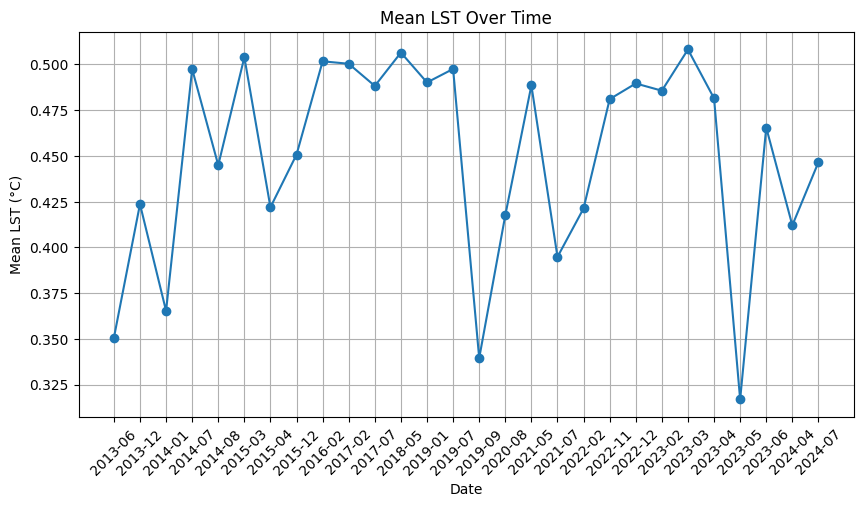

['2013-04', '2013-05', '2014-05', '2014-06', '2015-09', '2015-10', '2015-12', '2016-02', '2016-04', '2017-11', '2018-01', '2018-03', '2018-12', '2019-06', '2019-09', '2020-04', '2021-09', '2021-12', '2022-02', '2022-04', '2022-05', '2022-08', '2022-10', '2023-02', '2023-06', '2023-10', '2024-04']


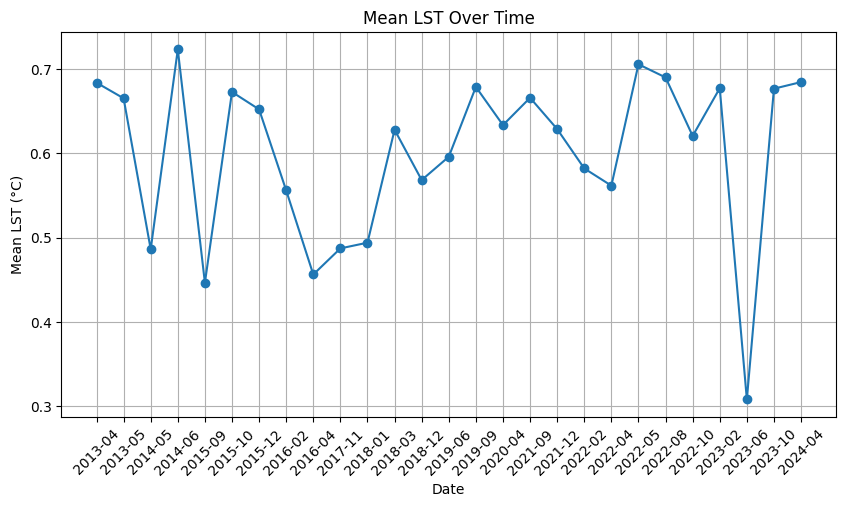

['2013-04', '2013-06', '2014-04', '2014-05', '2014-11', '2015-01', '2015-02', '2015-03', '2015-07', '2015-09', '2016-07', '2017-08', '2017-09', '2017-11', '2018-04', '2019-03', '2019-06', '2019-11', '2021-04', '2021-08', '2021-12', '2022-02', '2022-05', '2022-10', '2024-08']


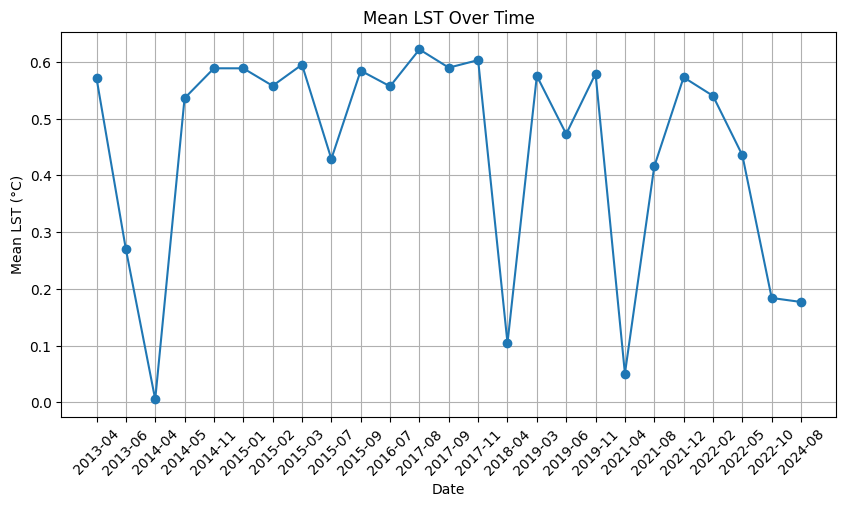

['2013-07', '2014-05', '2014-06', '2014-07', '2015-01', '2015-03', '2015-06', '2015-08', '2015-10', '2016-09', '2016-11', '2017-02', '2017-08', '2018-02', '2019-07', '2020-08', '2021-01', '2022-04', '2022-09', '2023-04', '2023-05', '2023-12', '2024-09']


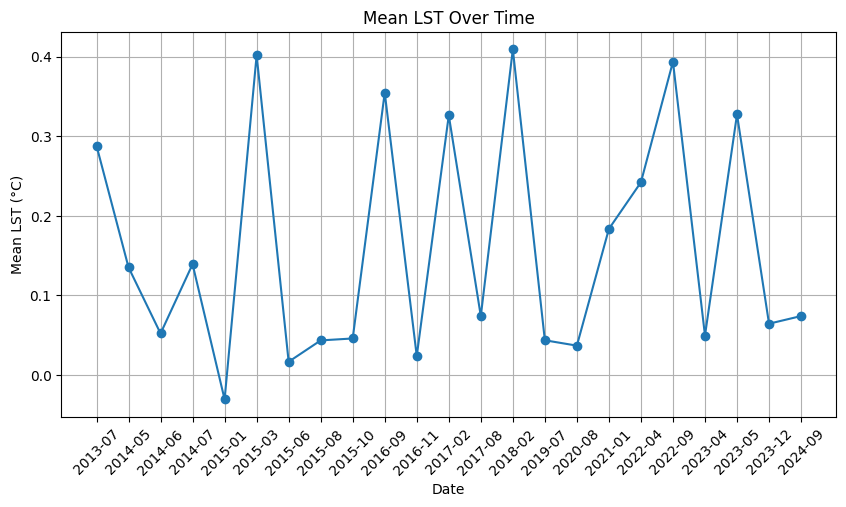

['2013-07', '2013-08', '2014-05', '2014-07', '2015-03', '2015-08', '2015-11', '2016-01', '2017-11', '2018-03', '2018-05', '2018-10', '2018-11', '2019-02', '2020-04', '2020-07', '2021-05', '2021-09', '2022-02', '2022-05', '2022-07', '2022-12', '2023-04', '2023-12', '2024-03', '2024-09']


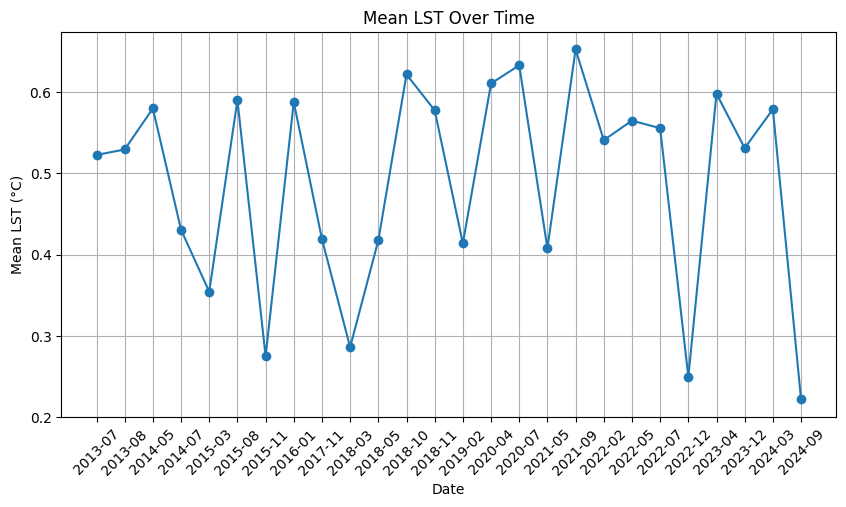

['2014-04', '2016-11', '2017-06', '2019-12', '2021-01']


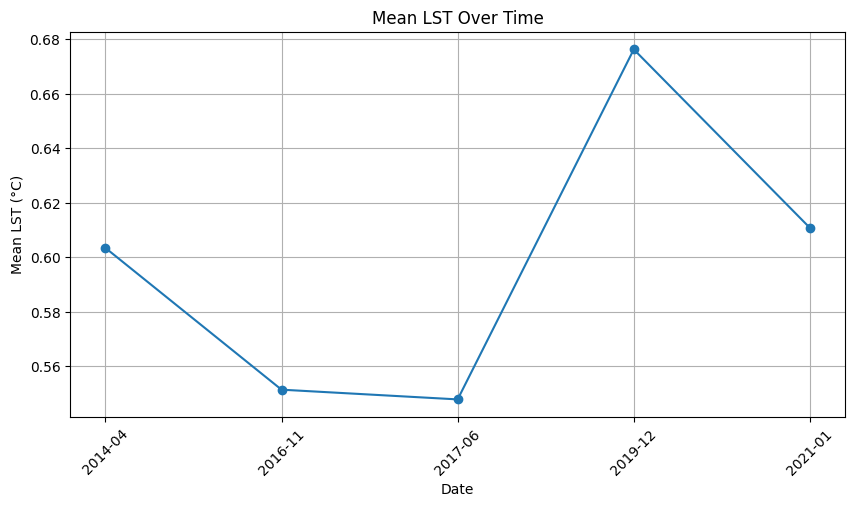

['2013-11', '2014-01', '2014-05', '2014-07', '2014-08', '2014-10', '2017-06', '2018-07', '2018-10', '2019-08', '2021-01', '2022-09', '2023-02', '2023-07', '2023-09', '2024-04']


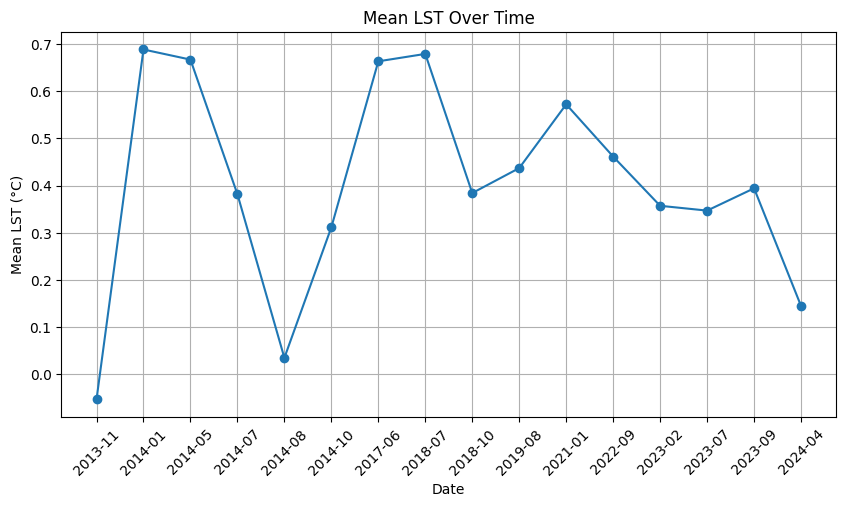

['2014-10', '2015-12', '2016-11', '2017-04', '2017-06', '2017-11', '2018-02', '2018-05', '2019-06', '2019-07', '2019-09', '2019-11', '2020-01', '2020-02', '2020-04', '2021-02', '2021-06', '2022-02', '2022-05', '2022-10', '2022-11', '2023-02', '2023-06', '2023-09', '2024-02', '2024-06']


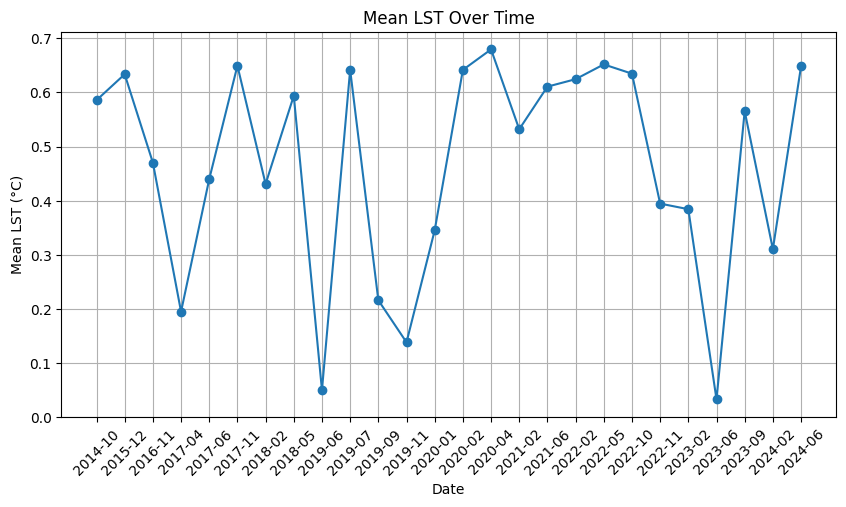

['2013-04', '2013-06', '2014-08', '2015-03', '2021-06', '2022-06', '2023-08', '2024-04']


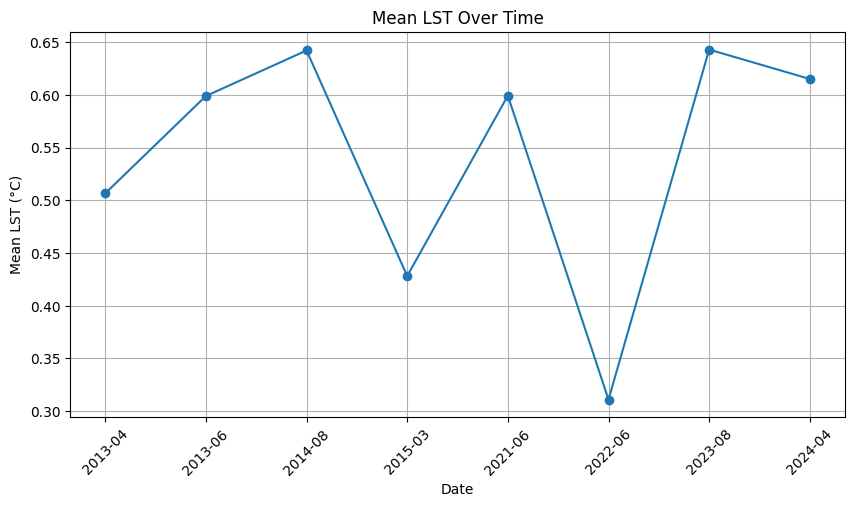

['2013-06', '2013-08', '2013-09', '2014-09', '2015-07', '2016-06', '2016-10', '2017-02', '2017-07', '2017-09', '2018-03', '2018-04', '2018-05', '2018-07', '2019-01', '2019-05', '2019-06', '2020-05', '2020-07', '2020-08', '2021-12', '2023-10', '2024-01']


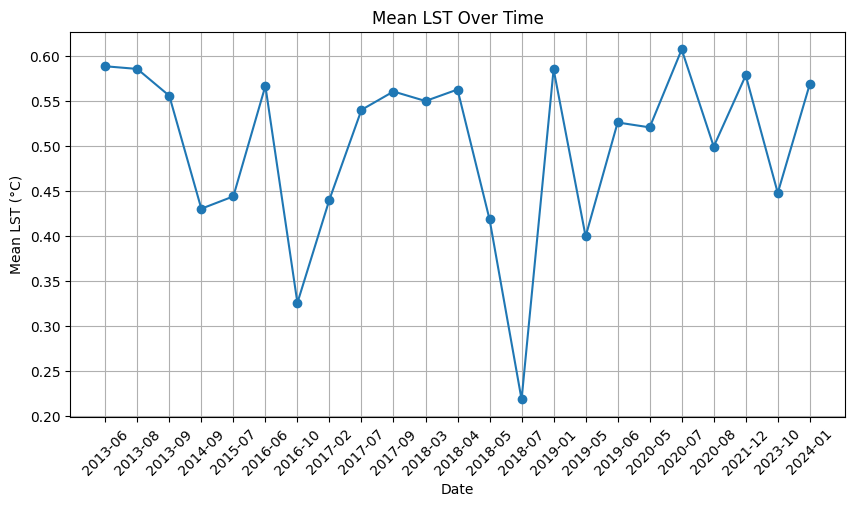

['2017-05', '2022-11', '2023-01', '2023-06']


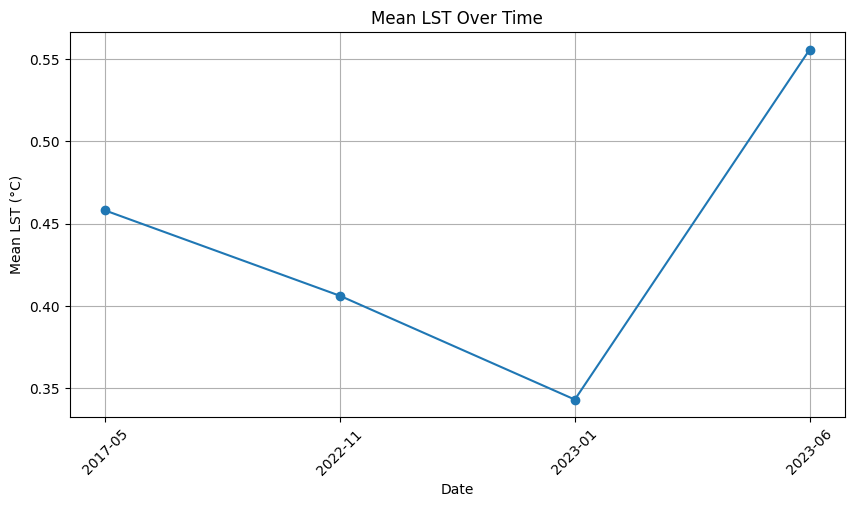

['2013-11', '2014-04', '2016-01', '2017-01', '2018-05', '2018-09', '2018-12', '2019-01', '2020-02', '2020-03', '2020-04', '2020-08', '2020-11', '2022-02', '2022-10']


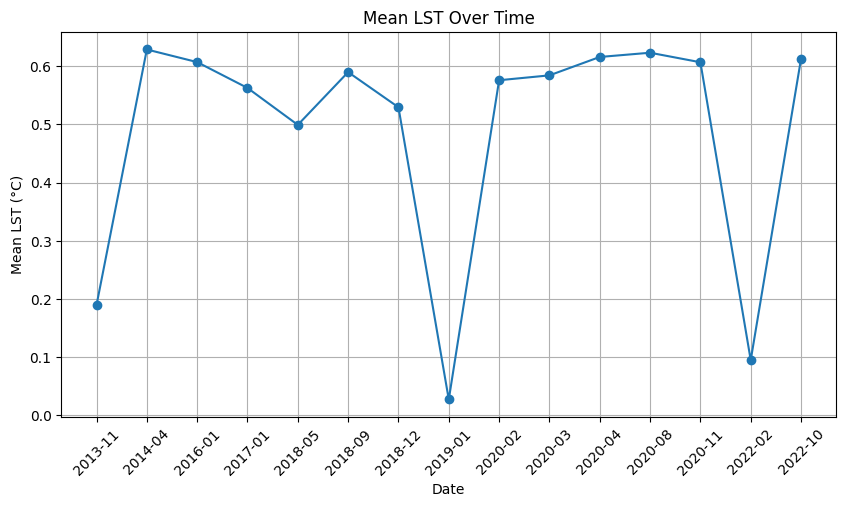

['2013-10', '2015-10', '2018-12', '2020-01', '2020-11', '2021-12', '2022-08']


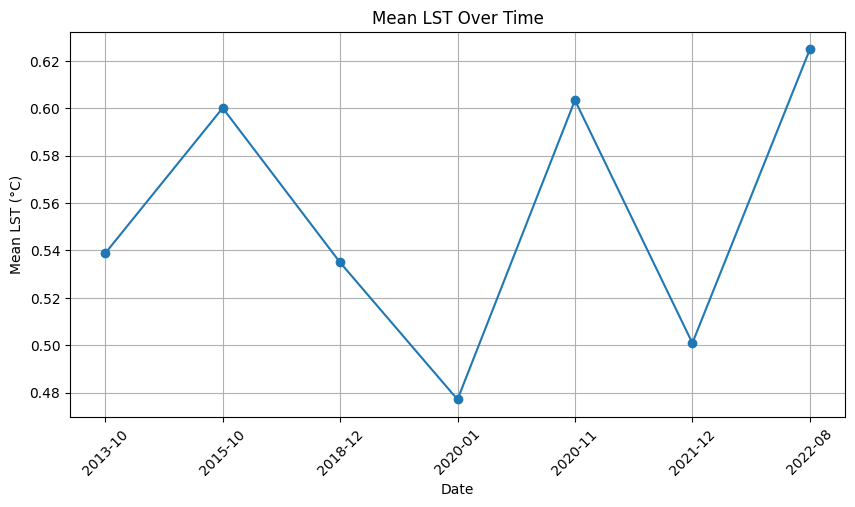

['2013-03', '2014-05', '2014-08', '2015-02', '2015-04', '2015-09', '2016-03', '2017-01', '2017-03', '2017-06', '2018-12', '2019-08', '2019-10', '2020-10', '2021-11', '2022-03', '2023-06', '2023-12']


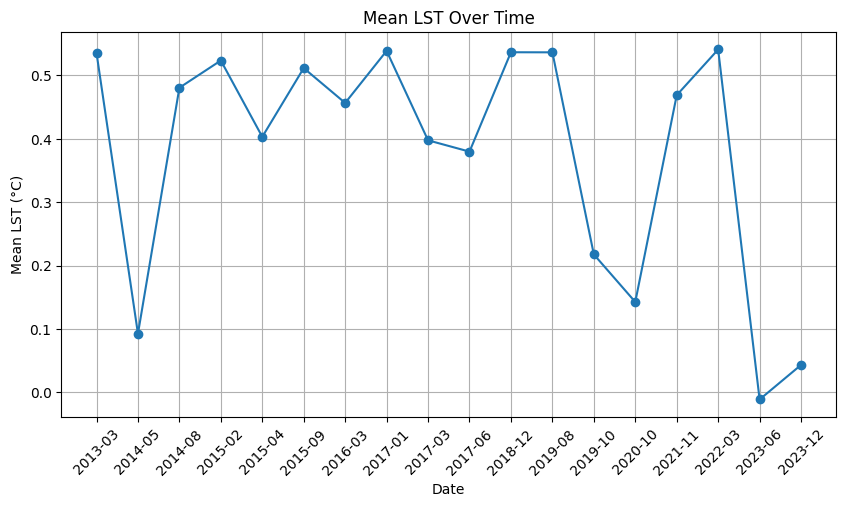

['2013-03', '2013-05', '2015-01', '2015-09', '2015-12', '2016-02', '2016-08', '2017-11', '2018-05', '2018-06', '2019-04', '2019-09', '2019-10', '2021-07', '2022-01', '2022-04', '2023-05', '2023-06', '2023-10', '2024-08']


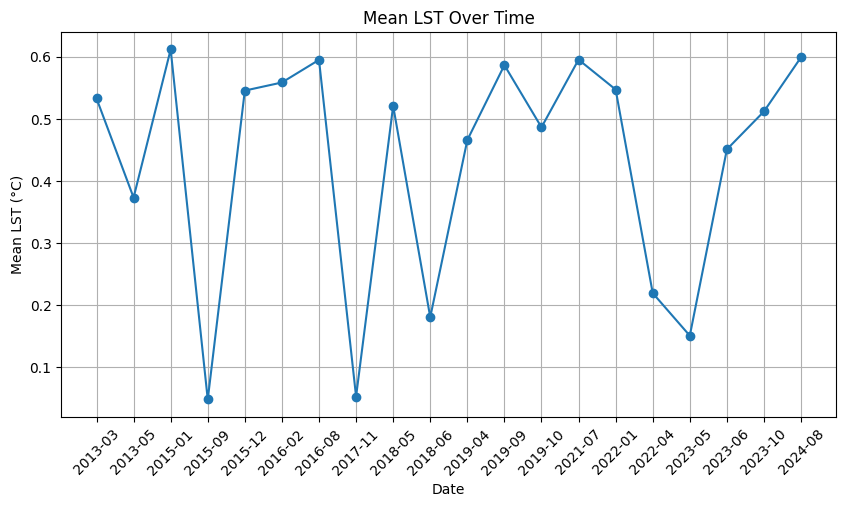

['2014-04', '2014-09', '2014-11', '2015-12', '2016-02', '2016-03', '2017-09', '2018-06', '2019-04', '2019-06', '2020-05', '2021-08', '2022-12', '2023-06', '2024-09']


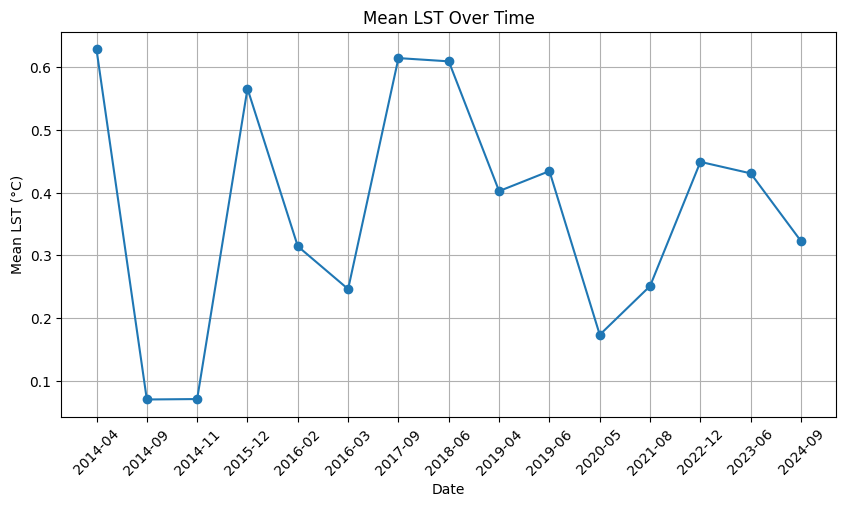

['2014-01', '2014-02', '2015-02', '2015-09', '2015-11', '2016-02', '2017-04', '2017-05', '2017-06', '2018-01', '2019-03', '2020-01', '2020-02', '2020-09', '2021-02', '2022-08', '2022-11', '2022-12', '2023-07']


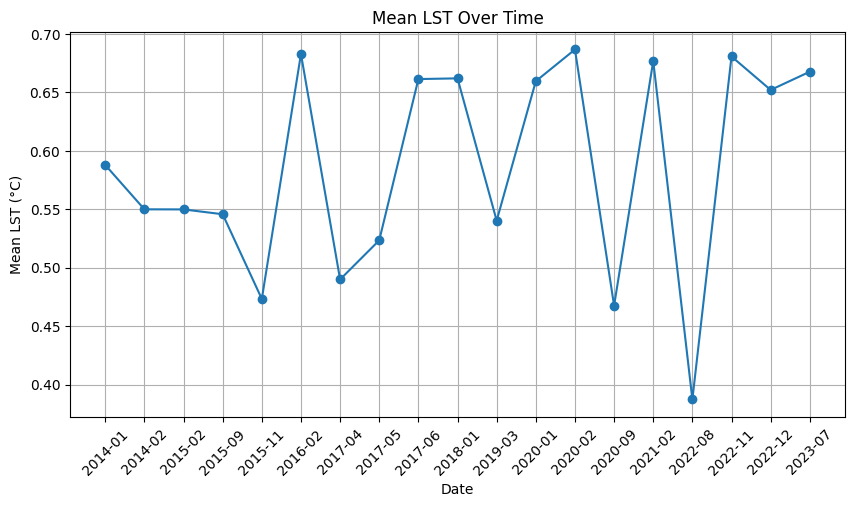

['2013-03', '2013-08', '2014-02', '2014-04', '2014-11', '2016-07', '2018-12', '2019-06', '2020-10', '2021-01', '2021-09', '2022-07', '2024-02']


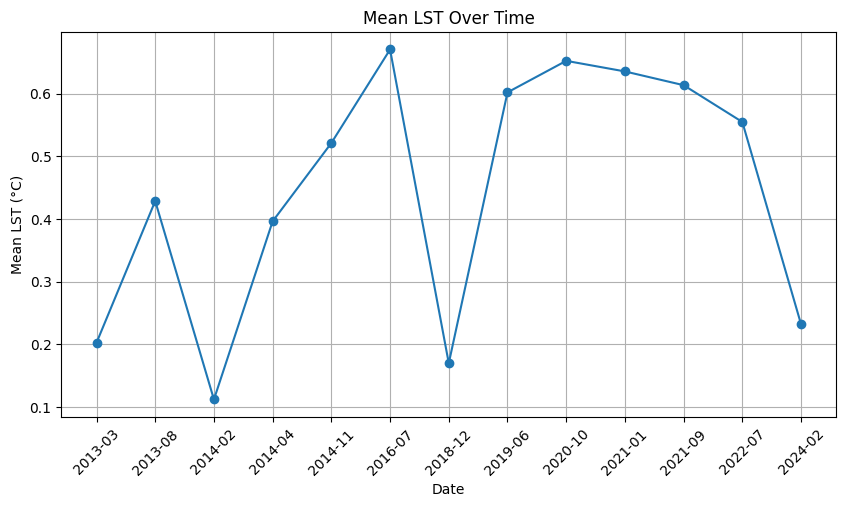

['2013-12', '2014-03', '2014-08', '2015-01', '2016-02', '2016-05', '2017-04', '2017-08', '2018-01', '2018-05', '2018-06', '2018-09', '2019-01', '2020-05', '2020-06', '2020-10', '2021-10', '2023-03', '2023-10', '2024-03']


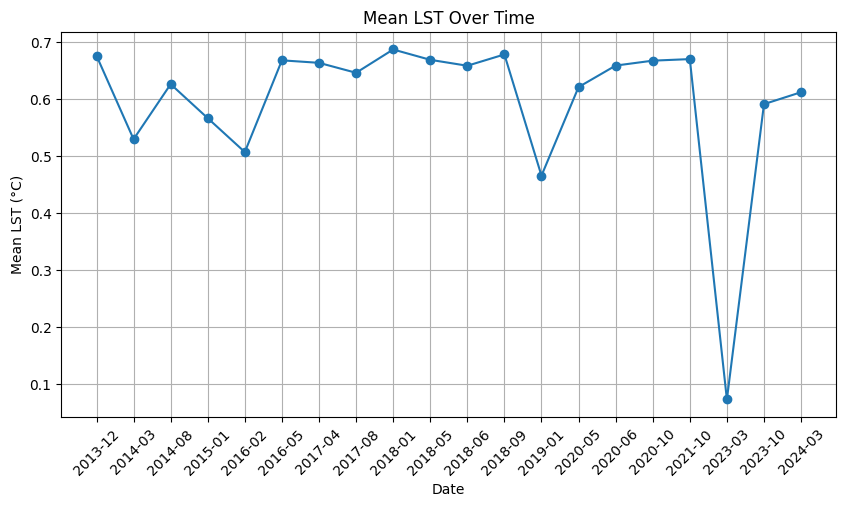

['2013-04', '2013-11', '2014-06', '2015-03', '2015-04', '2015-10', '2017-10', '2017-12', '2018-01', '2018-05', '2018-08', '2018-10', '2019-06', '2019-10', '2020-02', '2021-02', '2022-01', '2022-04', '2022-07', '2023-04']


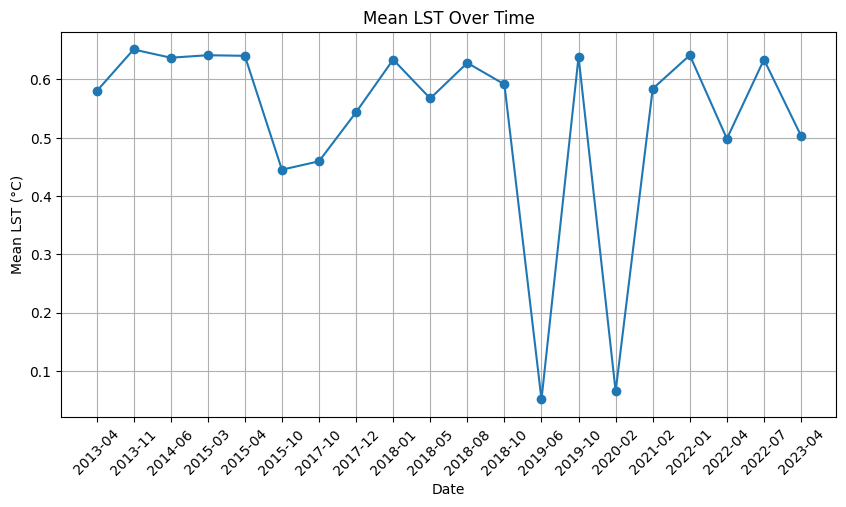

['2013-06', '2014-09', '2016-11', '2017-08', '2018-01', '2018-09', '2019-08', '2019-10', '2020-01', '2020-05', '2021-12', '2023-04', '2023-10']


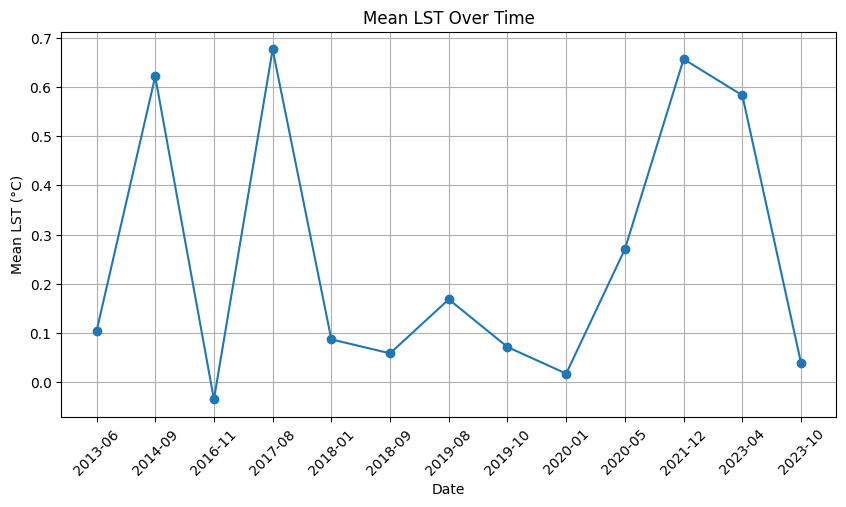

['2015-02', '2015-04', '2017-11', '2018-10', '2019-08', '2020-09', '2022-03', '2022-09', '2023-02', '2024-08', '2024-09']


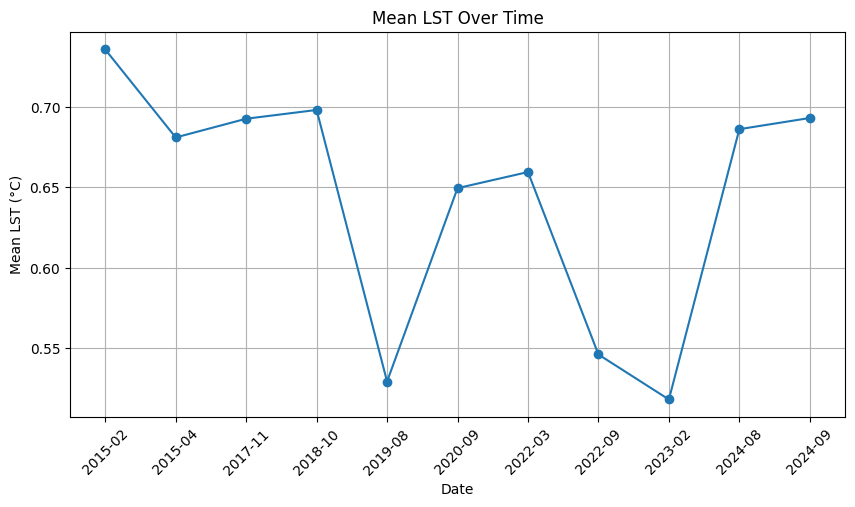

['2013-08', '2014-05', '2014-08', '2016-10', '2017-03', '2017-08', '2021-07', '2024-03']


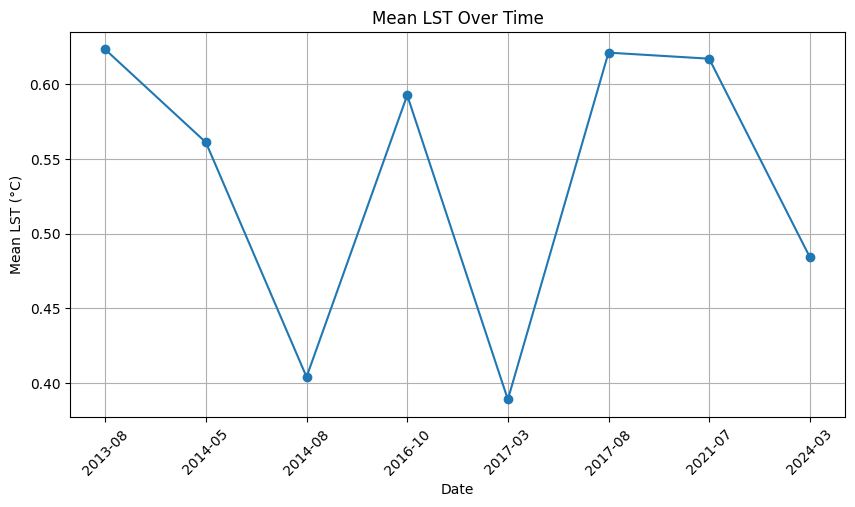

['2013-04', '2014-06', '2015-04', '2015-05', '2015-07', '2016-02', '2016-05', '2017-01', '2017-05', '2017-08', '2018-02', '2018-04', '2018-07', '2019-07', '2020-06', '2021-04', '2022-01', '2022-07', '2023-04', '2024-04']


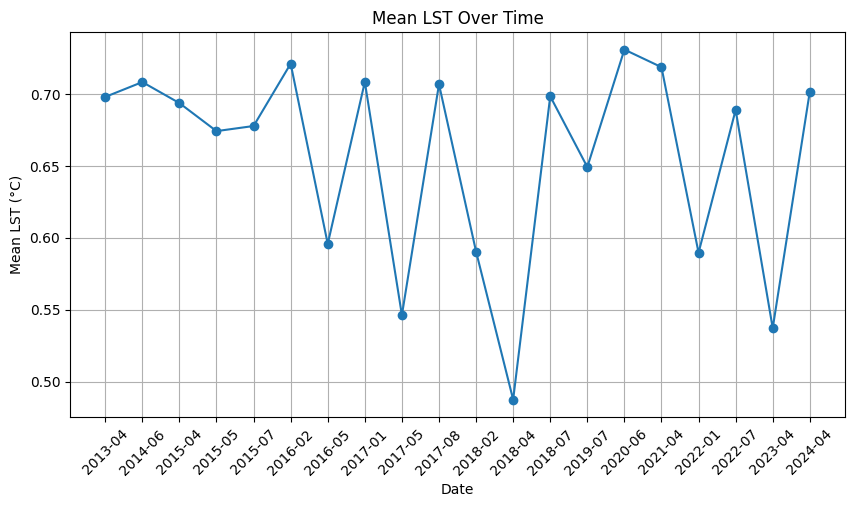

['2013-05', '2015-03', '2015-07', '2016-01', '2016-12', '2018-02', '2018-12', '2019-07', '2019-08', '2023-01']


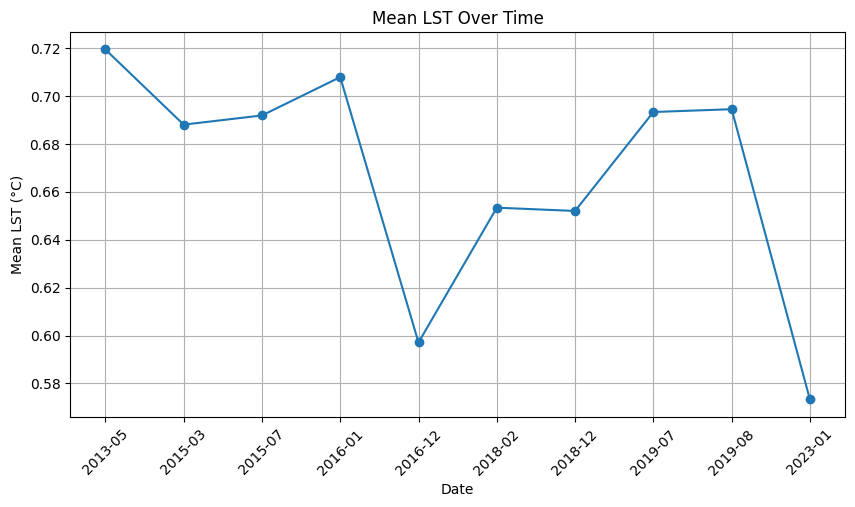

['2013-05', '2014-06', '2014-10', '2015-02', '2015-04', '2015-06', '2016-02', '2016-06', '2016-10', '2017-02', '2017-04', '2017-11', '2018-02', '2018-08', '2018-11', '2018-12', '2019-01', '2019-03', '2019-06', '2019-08', '2019-10', '2020-04', '2020-09', '2021-08', '2021-12', '2022-01', '2022-05', '2022-10', '2023-01', '2023-02', '2024-05', '2024-07']


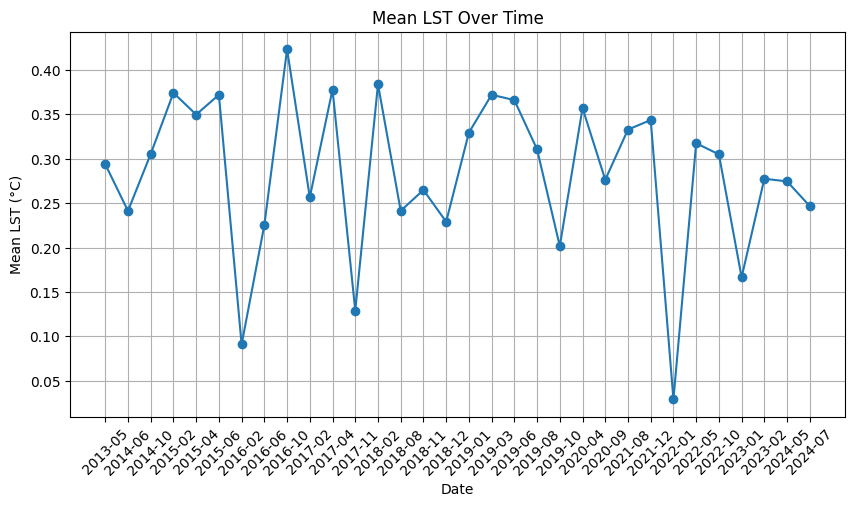

['2013-03', '2013-08', '2013-12', '2014-02', '2014-05', '2015-05', '2015-10', '2016-07', '2016-11', '2017-01', '2017-06', '2017-10', '2018-01', '2018-03', '2018-04', '2018-05', '2018-07', '2019-07', '2019-09', '2019-11', '2020-01', '2020-07', '2021-07', '2022-02', '2022-08', '2022-10', '2023-04', '2023-07', '2023-11', '2024-03']


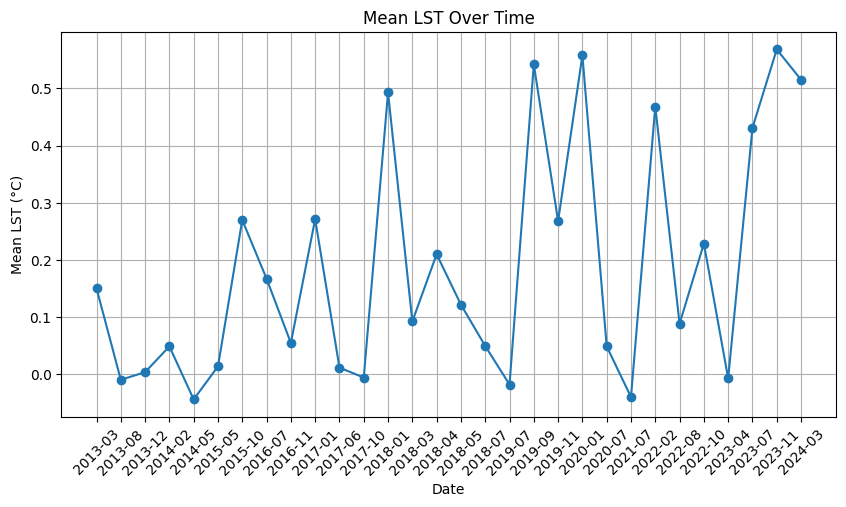

['2013-09', '2016-07', '2017-11', '2018-01', '2019-05', '2019-09', '2020-06', '2021-05', '2023-06']


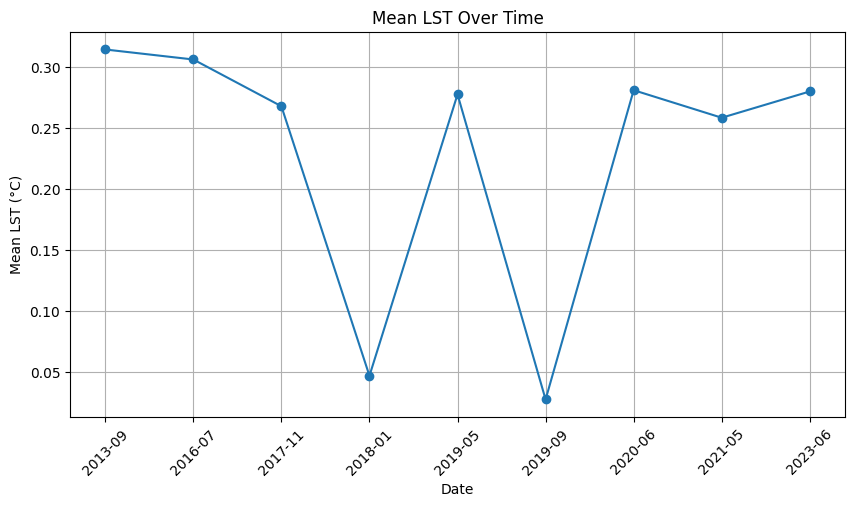

['2013-08', '2014-05', '2014-09', '2014-11', '2015-07', '2015-10', '2016-01', '2016-02', '2016-04', '2016-06', '2016-08', '2016-10', '2016-11', '2017-02', '2017-06', '2017-09', '2017-10', '2017-12', '2018-02', '2018-09', '2020-01', '2020-02', '2020-07', '2020-10', '2020-11', '2021-03', '2021-04', '2021-10', '2021-12', '2022-01', '2022-02', '2022-05', '2022-06', '2022-07', '2022-09', '2023-01', '2023-07', '2023-09', '2024-04', '2024-06', '2024-07']


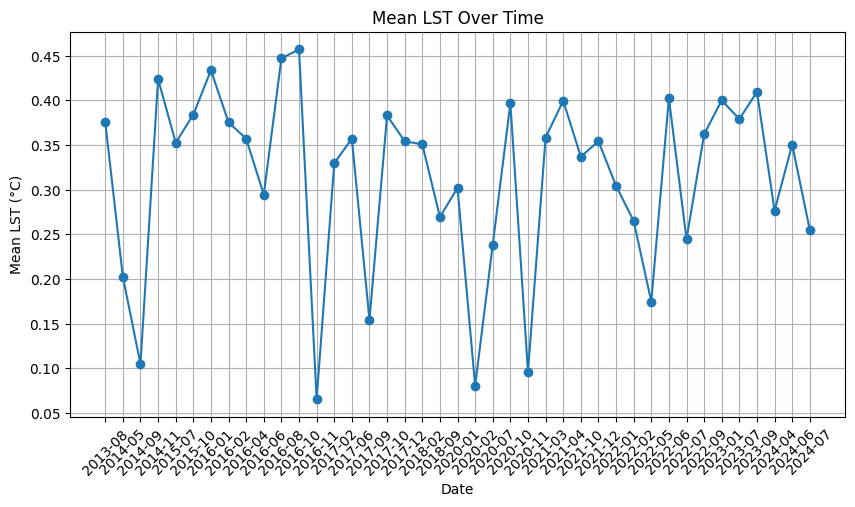

['2014-03', '2014-08', '2015-10', '2016-06', '2016-12', '2017-05', '2017-12', '2018-07', '2019-01', '2019-06', '2019-11', '2020-03', '2021-02', '2021-08', '2022-09', '2022-10', '2023-01', '2024-07', '2024-08']


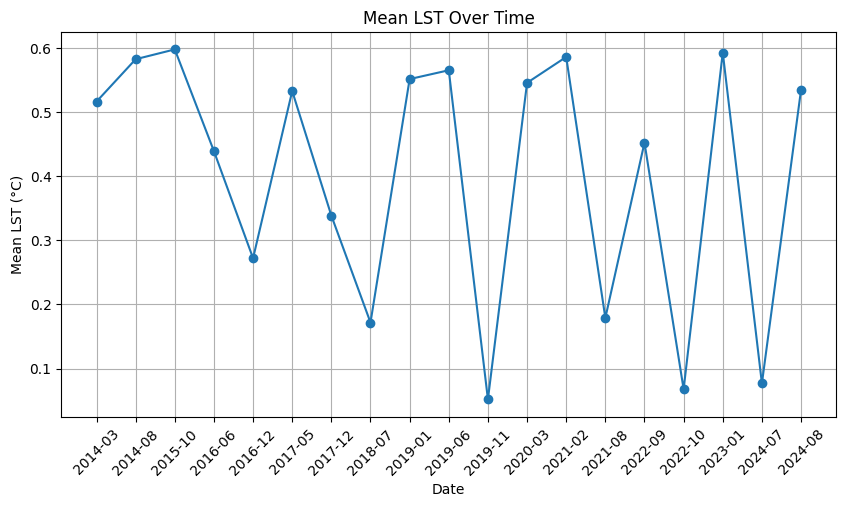

['2013-04', '2013-09', '2015-02', '2015-04', '2015-05', '2015-06', '2016-01', '2016-04', '2017-01', '2017-02', '2017-04', '2017-10', '2020-02', '2020-12', '2021-01', '2021-12', '2022-05', '2022-08', '2022-09', '2023-09', '2024-08']


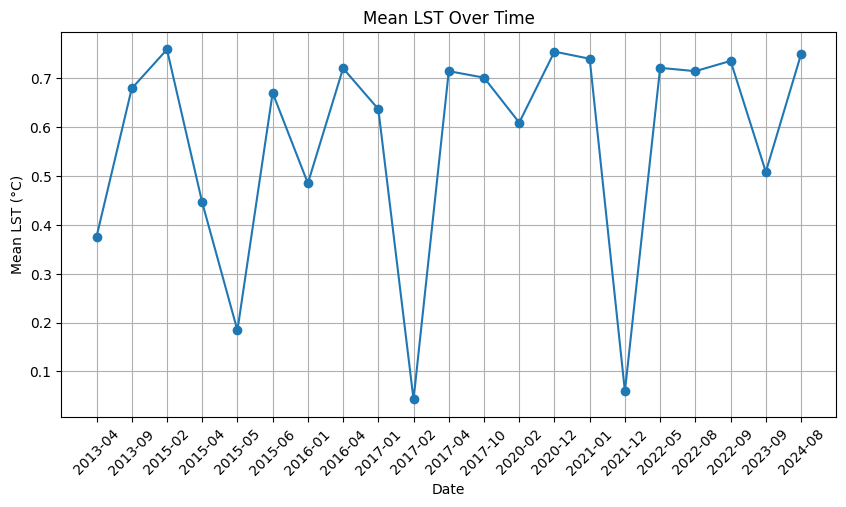

['2013-09', '2013-12', '2017-05', '2019-10', '2021-09', '2022-07', '2023-05']


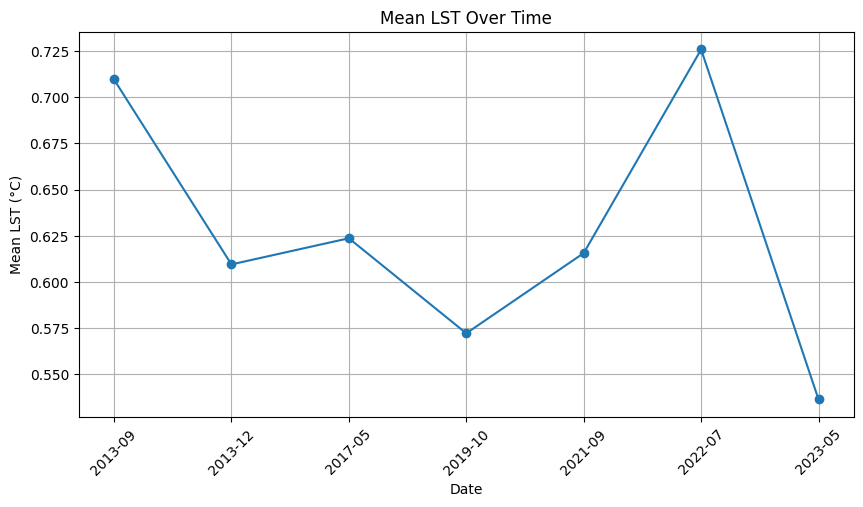

['2013-04', '2014-06', '2014-10', '2015-04', '2015-05', '2016-02', '2016-05', '2016-06', '2019-02', '2019-06', '2019-09', '2022-10', '2022-12']


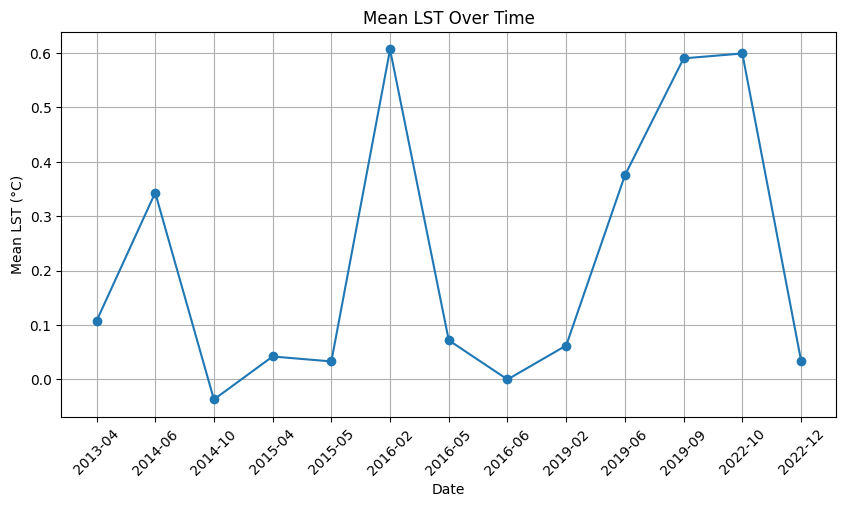

['2013-07', '2014-10', '2015-04', '2015-05', '2015-07', '2015-08', '2016-08', '2017-01', '2017-04', '2017-09', '2017-11', '2018-02', '2018-03', '2019-07', '2019-10', '2019-12', '2021-11', '2022-08', '2022-09', '2023-03', '2023-07', '2023-10', '2023-12', '2024-01', '2024-04', '2024-07']


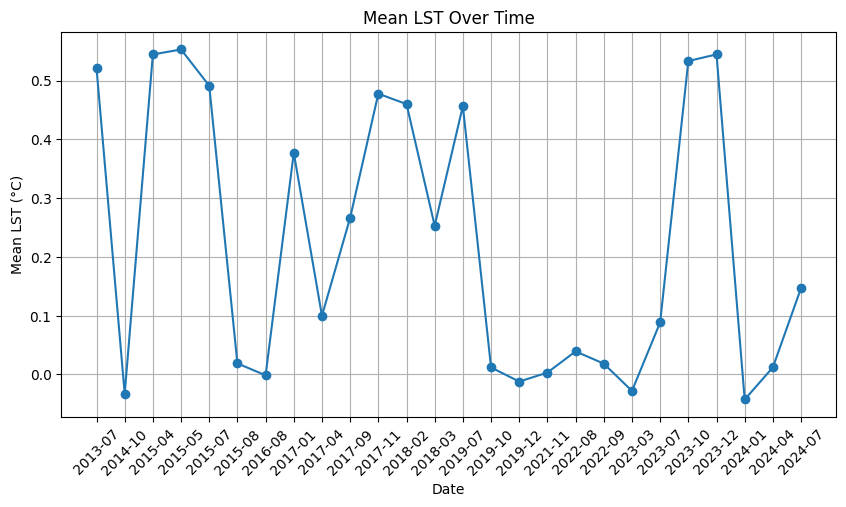

['2013-03', '2013-05', '2013-09', '2014-01', '2014-03', '2016-06', '2016-10', '2017-02', '2017-10', '2018-03', '2018-04', '2018-05', '2018-06', '2018-11', '2019-02', '2019-05', '2019-09', '2019-10', '2020-01', '2020-03', '2020-10', '2020-12', '2021-06', '2021-09', '2022-01', '2022-05', '2022-06', '2023-04', '2023-05', '2023-07', '2023-08', '2024-02', '2024-03', '2024-06', '2024-08']


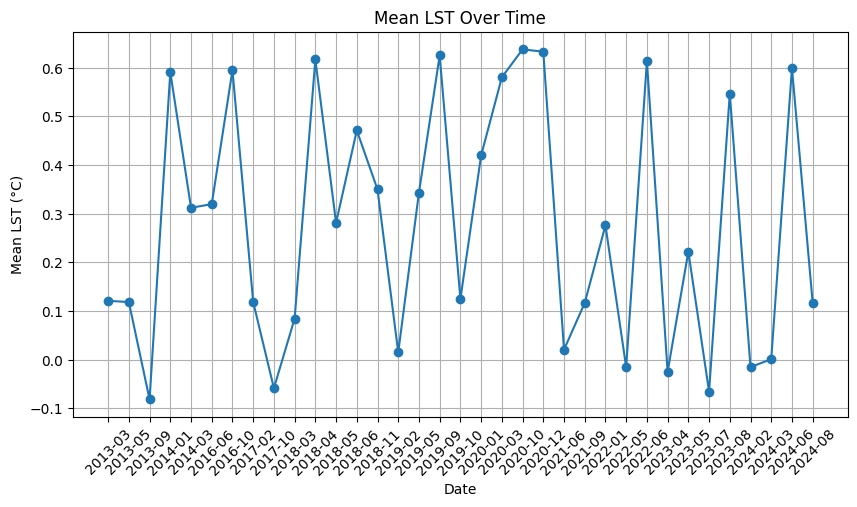

['2014-12', '2015-02', '2015-04', '2015-06', '2015-10', '2018-11', '2019-11', '2020-09', '2020-12', '2021-02', '2021-12', '2022-04', '2022-06', '2022-08', '2022-09', '2023-02', '2024-02', '2024-07']


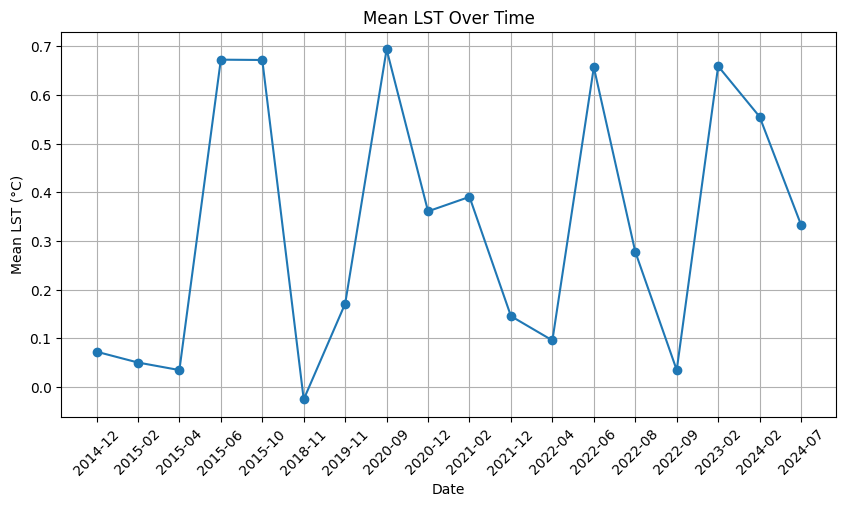

['2014-12', '2015-05', '2015-11', '2017-06', '2021-04', '2021-05', '2021-12', '2024-09']


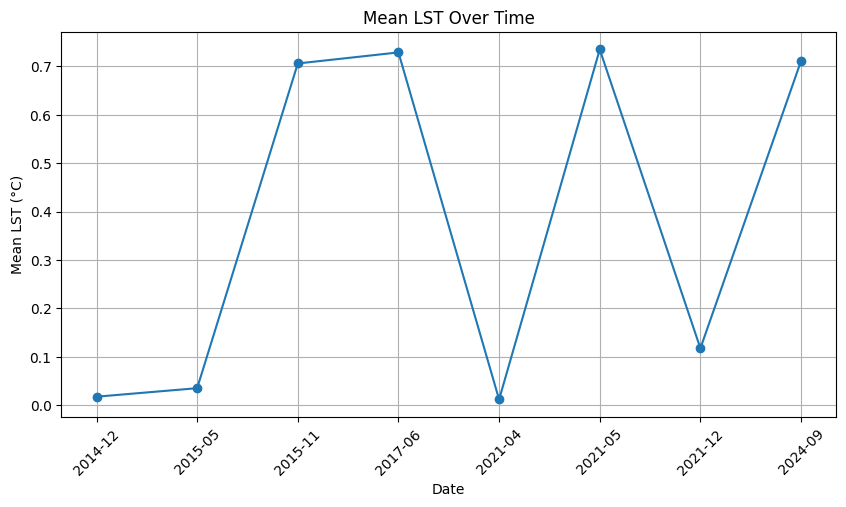

In [44]:


for i,(k, imgs) in enumerate(data.items()):
    dates = []
    mean_lst_values = []
    if len(imgs)>0:
        for j,img in enumerate(imgs):
            date = times[i][j]
            dates.append(date)
            
            mean_lst = np.mean(img)
            mean_lst_values.append(mean_lst)

        
        print(dates)
        sorted_dates, sorted_means = zip(*sorted(zip(dates, mean_lst_values)))
    
        # Plot the mean LST over time
        plt.figure(figsize=(10, 5))
        plt.plot(sorted_dates, sorted_means, marker='o')
        plt.xlabel("Date")
        plt.ylabel("Mean LST (°C)")
        plt.title("Mean LST Over Time")
        plt.xticks(rotation=45)
        plt.grid()
        plt.show()
    

## Clustering

In [6]:
lat, lon = get_lat_lon(labels)

In [7]:
rivers_folder = '../data/external/shp/river_cells_oficial'
rivs, x_coords, y_coords, z_coords = get_rivers_altitude(rivers_folder,filt=filter_alt)

In [8]:
data = pd.DataFrame({
    'river_name': rivs,
    'x_mean': [np.mean(coords) for coords in x_coords],
    'y_mean': [np.mean(coords) for coords in y_coords],
    'z_mean': [np.mean(coords) for coords in z_coords],
    'z_std': [np.std(coords) for coords in z_coords]
})

In [9]:
scaler = StandardScaler()
features = ['x_mean', 'y_mean', 'z_mean', 'z_std']
data_scaled = scaler.fit_transform(data[features])

In [10]:
kmeans = KMeans(n_clusters=3, random_state=42)
data['cluster'] = kmeans.fit_predict(data_scaled)

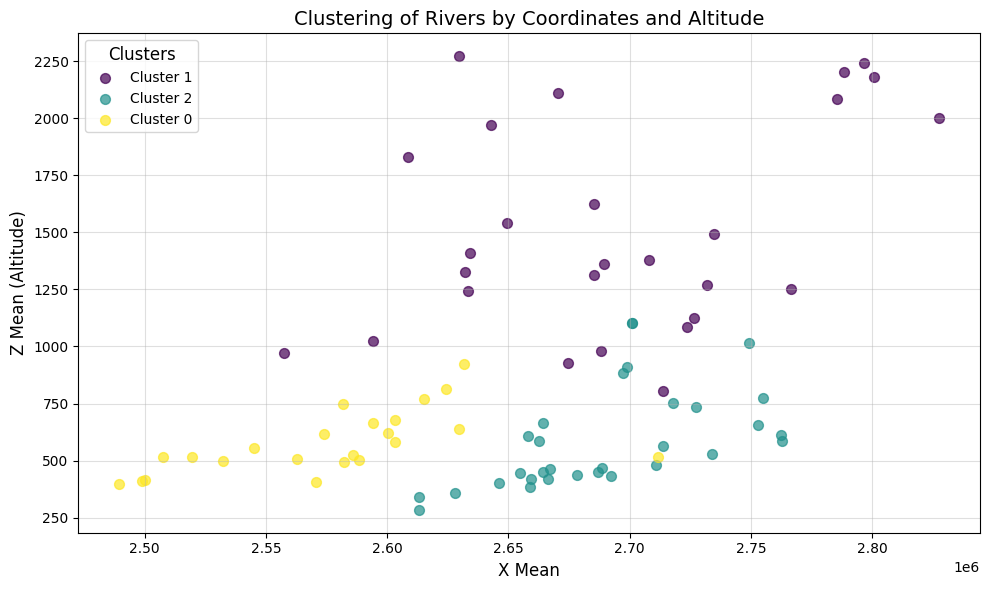

In [11]:

# Get unique clusters
clusters = data['cluster'].unique()
colors = plt.cm.viridis(np.linspace(0, 1, len(clusters)))

# Create the scatter plot
plt.figure(figsize=(10, 6))
for cluster, color in zip(clusters, colors):
    cluster_data = data[data['cluster'] == cluster]
    plt.scatter(
        cluster_data['x_mean'],
        cluster_data['z_mean'],
        label=f'Cluster {cluster}',
        color=color,
        s=50,
        alpha=0.7
    )

# Add labels and title
plt.xlabel('X Mean', fontsize=12)
plt.ylabel('Z Mean (Altitude)', fontsize=12)
plt.title('Clustering of Rivers by Coordinates and Altitude', fontsize=14)

# Add legend
plt.legend(title='Clusters', fontsize=10, title_fontsize=12, loc='best')

# Add grid and show plot
plt.grid(alpha=0.4)
plt.tight_layout()
#plt.savefig("../plots/clusters.png")
plt.show()


In [12]:
data

,river_name,x_mean,y_mean,z_mean,z_std,cluster
0,cell_37,2.634302e+06,1.126087e+06,1407.912820,475.428692,1
1,cell_8,2.754987e+06,1.235254e+06,775.058834,329.676656,2
2,cell_33,2.594237e+06,1.191394e+06,665.478815,90.379434,0
3,cell_9,2.489617e+06,1.115771e+06,396.220703,30.800577,0
4,cell_42,2.796671e+06,1.166087e+06,2243.596100,303.644251,1
...,...,...,...,...,...,...
76,cell_29,2.670296e+06,1.153902e+06,2110.260424,343.443958,1
77,cell_47,2.581592e+06,1.228223e+06,747.247681,138.208816,0
78,cell_4,2.734580e+06,1.181946e+06,1493.389214,449.083702,1
79,cell_22,2.582045e+06,1.211575e+06,493.489637,76.743138,0


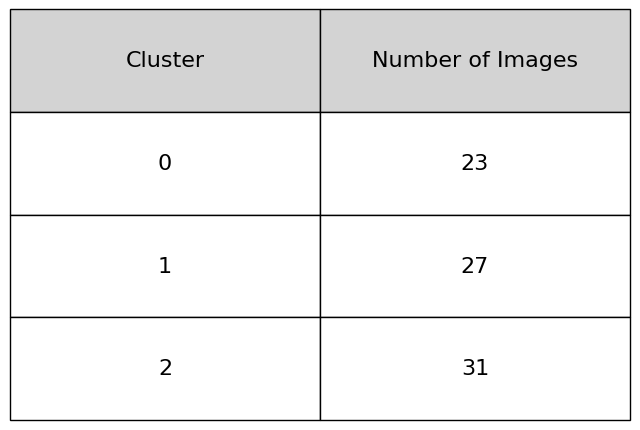

In [13]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.table import Table

# Count the number of data points per cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# Create a DataFrame for the table
table_data = pd.DataFrame({
    'Cluster': cluster_counts.index,
    'Number of Images': cluster_counts.values
})

# Create a figure
fig, ax = plt.subplots(figsize=(8, 4))
ax.set_axis_off()

# Create the table
tbl = Table(ax, bbox=[0, 0, 1, 1])

# Add the header row
col_labels = list(table_data.columns)
for i, label in enumerate(col_labels):
    tbl.add_cell(-1, i, 1, 0.4, text=label, loc='center', facecolor='lightgray', edgecolor='black')# fontsize=12)
    tbl._cells[(-1, i)].get_text().set_fontsize(16)

# Add the data rows
for row_idx, (index, row) in enumerate(table_data.iterrows()):
    for col_idx, value in enumerate(row):
        tbl.add_cell(row_idx, col_idx, 1, 0.4, text=value, loc='center', edgecolor='black')#, fontsize=10)
        tbl._cells[(row_idx, col_idx)].get_text().set_fontsize(16)

# Auto-adjust cell dimensions
tbl.auto_set_font_size(False)
tbl.set_fontsize(16)
tbl.scale(1.2, 1.5)

# Add the table to the plot
ax.add_table(tbl)

# Set a title
#plt.title("Number of Images per Cluster", fontsize=14, fontweight='bold', pad=20)

# Save and show the table
#plt.savefig("../plots/cluster_table.png", bbox_inches='tight')
plt.show()


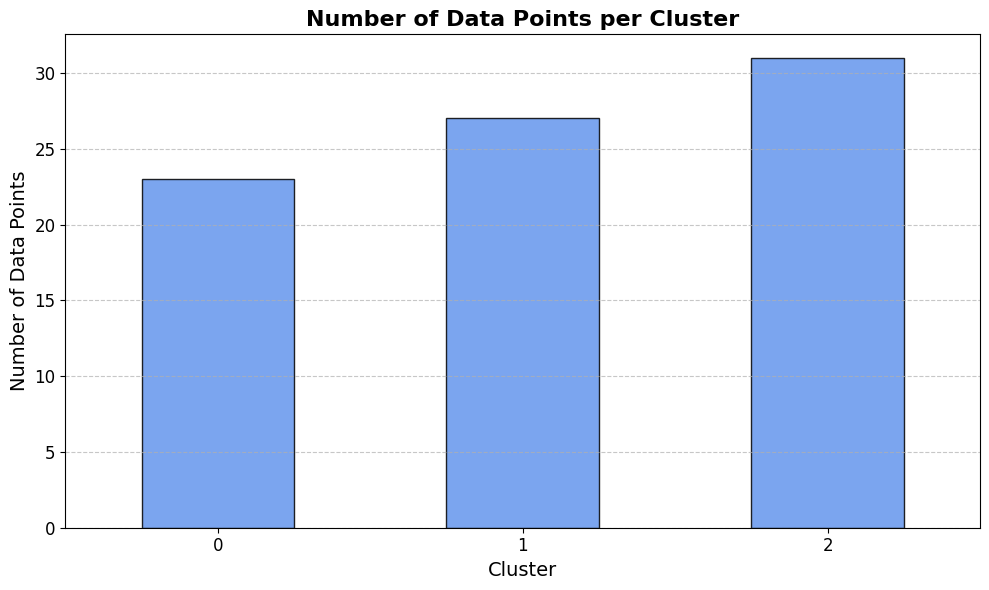

In [14]:
# Count the number of data points per cluster
cluster_counts = data['cluster'].value_counts().sort_index()

# Create the bar chart
plt.figure(figsize=(10, 6))
cluster_counts.plot(
    kind='bar',
    color='cornflowerblue',
    edgecolor='black',
    alpha=0.85
)

# Add labels and title
plt.xlabel('Cluster', fontsize=14)
plt.ylabel('Number of Data Points', fontsize=14)
plt.title('Number of Data Points per Cluster', fontsize=16, fontweight='bold')

# Customize ticks
plt.xticks(fontsize=12, rotation=0)
plt.yticks(fontsize=12)

# Add grid lines for better readability
plt.grid(axis='y', linestyle='--', alpha=0.7)

# Show the plot
plt.tight_layout()
plt.show()


## Balanced split

In [15]:
ordered_clusters=[]
for lab in labels:
    cl=data[data.river_name==lab].cluster.values[0]
    ordered_clusters.append(cl)


In [16]:
len(ordered_clusters)

1307

In [17]:
split_df = pd.DataFrame({
    'label': labels,
    'date': total_times['lst'],
    'cluster': ordered_clusters
})
split_df['index'] = split_df.index

In [18]:
import pandas as pd
import numpy as np
import math
import json
import os

# Directory to save the splits
output_dir = "../data/external/splits/"
os.makedirs(output_dir, exist_ok=True)

# Function to map dates to seasons
def map_season(date):
    month = pd.to_datetime(date).month
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'

# Add a season column to split_df
split_df['season'] = split_df['date'].apply(map_season)
split_df['year'] = pd.to_datetime(split_df['date']).dt.year

# Number of splits to generate
n_splits = 5

for split_id in range(n_splits):
    train_indices, val_indices, test_indices = [], [], []

    # Change the seed for reproducibility
    seed = split_id + 42

    # Group by cluster, season, and year
    grouped = split_df.groupby(['cluster', 'season', 'year'])

    # Calculate global proportions
    total_rows = len(split_df)
    target_train = int(0.6 * total_rows)
    target_val = int(0.2 * total_rows)
    target_test = total_rows - target_train - target_val

    # Initial split by group
    for _, group in grouped:
        group = group.sample(frac=1, random_state=seed).reset_index(drop=True)

        # Calculate sizes for train, val, and test
        n = len(group)
        n_train = math.floor(0.6 * n)
        n_val = math.floor(0.2 * n)
        n_test = n - n_train - n_val

        train_indices.extend(group['index'][:n_train])
        val_indices.extend(group['index'][n_train:n_train + n_val])
        test_indices.extend(group['index'][n_train + n_val:])

    # Adjust splits to match exact global proportions
    def redistribute(indices, target_size, source1, source2):
        while len(indices) < target_size:
            if source1:
                indices.append(source1.pop())
            elif source2:
                indices.append(source2.pop())

    # Adjust train
    redistribute(train_indices, target_train, val_indices, test_indices)
    # Adjust validation
    redistribute(val_indices, target_val, test_indices, train_indices)
    # Adjust test
    redistribute(test_indices, target_test, train_indices, val_indices)

    # Validate final split sizes
    total_assigned = len(train_indices) + len(val_indices) + len(test_indices)
    assert total_assigned == total_rows, f"Mismatch in total rows: {total_assigned} != {total_rows}"
    # Validate representation
    train_clusters = split_df.loc[train_indices, 'cluster'].unique()
    val_clusters = split_df.loc[val_indices, 'cluster'].unique()
    test_clusters = split_df.loc[test_indices, 'cluster'].unique()

    train_seasons = split_df.loc[train_indices, 'season'].unique()
    val_seasons = split_df.loc[val_indices, 'season'].unique()
    test_seasons = split_df.loc[test_indices, 'season'].unique()

    train_years = split_df.loc[train_indices, 'year'].unique()
    val_years = split_df.loc[val_indices, 'year'].unique()
    test_years = split_df.loc[test_indices, 'year'].unique()

    print(f"Split {split_id + 1}:")
    print(f"  Train Clusters={train_clusters}, Seasons={train_seasons}, Years={train_years}")
    print(f"  Val Clusters={val_clusters}, Seasons={val_seasons}, Years={val_years}")
    print(f"  Test Clusters={test_clusters}, Seasons={test_seasons}, Years={test_years}")

    print(f"Split {split_id + 1}: Train={len(train_indices)}, Val={len(val_indices)}, Test={len(test_indices)}")

    # Save the indices for each split
    indices = {
        'train': train_indices,
        'val': val_indices,
        'test': test_indices
    }

    with open(os.path.join(output_dir, f"split_{split_id + 1}_indices.json"), 'w') as f:
        json.dump(indices, f)

    print(f"Saved split {split_id + 1} with Train={len(train_indices)}, Val={len(val_indices)}, Test={len(test_indices)}")


Split 1:
  Train Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Val Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Test Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
Split 1: Train=784, Val=261, Test=262
Saved split 1 with Train=784, Val=261, Test=262
Split 2:
  Train Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Val Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
  Test Clusters=[0 1 2], Seasons=['Autumn' 'Spring' 'Summer' 'Winter'], Years=[2013 2014 2015 2016 2017 2018 2019 2020 2021 2022 2023 2024]
Split 2: Train=784, Val=261, Test=262
Saved split 2 with

### Check splits

In [19]:
# Adapt input shapes
inputs_d = [total_data[inp] for inp in inputs]
expanded_images = []
for img in inputs_d:
    if img.ndim == 3:  # Case where image is (n, 256, 256) (single-channel)
        expanded_images.append(np.expand_dims(img, axis=-1))  # Expand to add an extra channel
    elif img.ndim == 4:  # Case where image already has multiple channels (n, 256, 256, c)
        expanded_images.append(img)  # Leave the image as it is
combined_input = np.concatenate(expanded_images, axis=-1) # Concatenate all images along the last axis (channels)
input_data = combined_input # The final combined input is stored in input_data
print('Final shape', input_data.shape)

Final shape (1307, 64, 64, 4)


In [54]:
# Seleccionar el split a cargar
split_num = 1  
split='stratified'
filt_alt = False
train_index, validation_index, test_index = get_split_index(split, input_data, data_targets, labels, split_num, filt_alt)
    
validation_input = input_data[validation_index, :] / 255.0  # Normalize inputs
validation_target = data_targets[validation_index]
test_input = input_data[test_index, :] / 255.0  # Normalize inputs
test_target = data_targets[test_index]
train_input = input_data[train_index, :] / 255.0  # Normalize inputs
train_target = data_targets[train_index]
# Comprobar las formas
print("Val data shape:", validation_input.shape)
print("Train data shape:", train_input.shape)
print("Test data shape:", test_input.shape)


yes !!!!!!!!!!
Val data shape: (267, 64, 64, 4)
Train data shape: (803, 64, 64, 4)
Test data shape: (269, 64, 64, 4)


In [55]:
import json
from collections import defaultdict
from datetime import datetime

# Example: List of all dates and indices
dates = total_times['lst']
indices = list(range(len(dates)))  # Indices corresponding to dates

# Directory where split indices are stored
input_dir = "../data/external/splits/"
split_indices_files = ["split_1_indices.json", "split_2_indices.json", "split_3_indices.json", "split_4_indices.json", "split_5_indices.json"]  # Example split files

# Dictionary to store the summary
split_season_year_summary = defaultdict(dict)
last_t=None
last_v=None
# Process each split
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']
    if last_t == train_indices and last_v == train_indices :
        print('iguals')
        
    last_t=train_indices
    last_v=val_indices
    

    # Map indices to dates
    train_dates = [dates[i] for i in train_indices]
    val_dates = [dates[i] for i in val_indices]
    test_dates = [dates[i] for i in test_indices]

    # Analyze each set (Train, Validation, Test)
    for subset_name, subset_dates in [('Train', train_dates), ('Validation', val_dates), ('Test', test_dates)]:
        # Map dates to seasons and years
        seasons = [map_season(date) for date in subset_dates]
        years = [datetime.strptime(date, "%Y-%m").year for date in subset_dates]

        # Count occurrences
        season_counts = {season: seasons.count(season) for season in set(seasons)}
        year_counts = {year: years.count(year) for year in set(years)}

        # Store the summary
        split_season_year_summary[split_name][subset_name] = {
            'season_counts': season_counts,
            'year_counts': year_counts
        }

# Display the summary
for split_name, summary in split_season_year_summary.items():
    print(f"\n--- {split_name} ---")
    for subset_name, counts in summary.items():
        print(f"\n{subset_name}:")
        print(f"  Seasons: {counts['season_counts']}")
        print(f"  Years: {counts['year_counts']}")



--- split_1 ---

Train:
  Seasons: {'Winter': 186, 'Spring': 217, 'Summer': 206, 'Autumn': 194}
  Years: {2016: 74, 2017: 73, 2018: 78, 2019: 75, 2020: 66, 2021: 60, 2022: 67, 2023: 71, 2024: 54, 2013: 46, 2014: 64, 2015: 75}

Validation:
  Seasons: {'Winter': 63, 'Spring': 71, 'Summer': 72, 'Autumn': 61}
  Years: {2016: 23, 2017: 21, 2018: 27, 2019: 26, 2020: 22, 2021: 22, 2022: 24, 2023: 24, 2024: 19, 2013: 15, 2014: 20, 2015: 24}

Test:
  Seasons: {'Winter': 63, 'Spring': 63, 'Summer': 72, 'Autumn': 71}
  Years: {2016: 24, 2017: 20, 2018: 21, 2019: 26, 2020: 22, 2021: 20, 2022: 21, 2023: 21, 2024: 23, 2013: 21, 2014: 22, 2015: 28}

--- split_2 ---

Train:
  Seasons: {'Winter': 186, 'Spring': 217, 'Summer': 206, 'Autumn': 194}
  Years: {2016: 74, 2017: 73, 2018: 78, 2019: 75, 2020: 66, 2021: 60, 2022: 67, 2023: 71, 2024: 54, 2013: 46, 2014: 64, 2015: 75}

Validation:
  Seasons: {'Winter': 63, 'Spring': 71, 'Summer': 72, 'Autumn': 61}
  Years: {2016: 23, 2017: 21, 2018: 27, 2019: 26,


--- split_1 ---


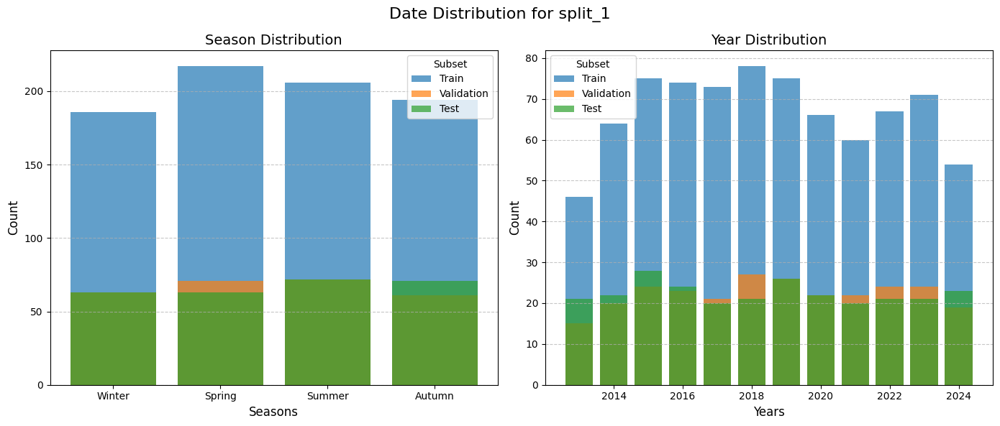


--- split_2 ---


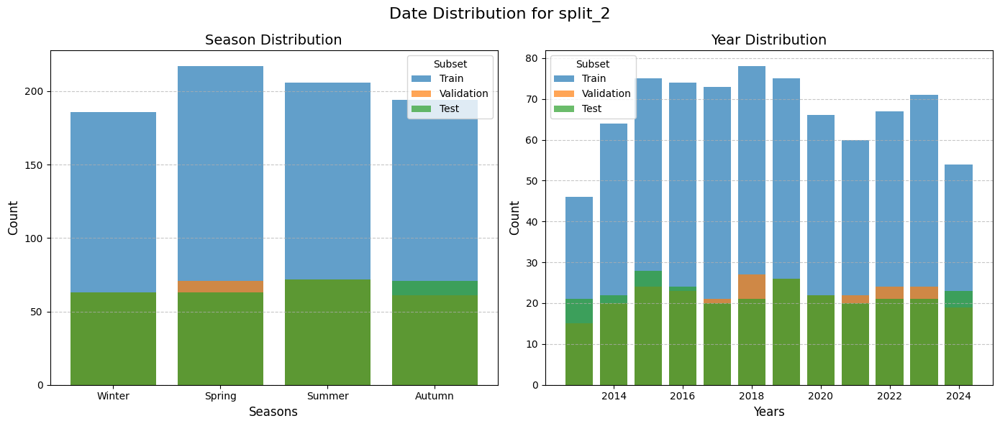


--- split_3 ---


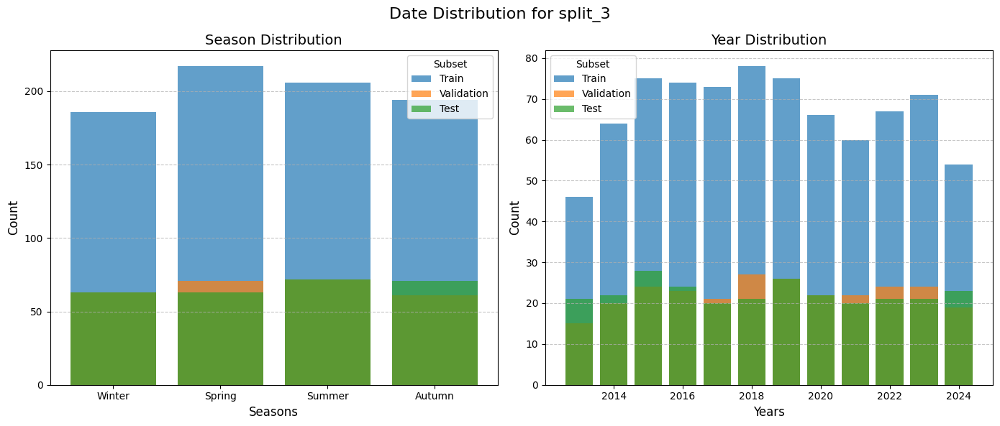


--- split_4 ---


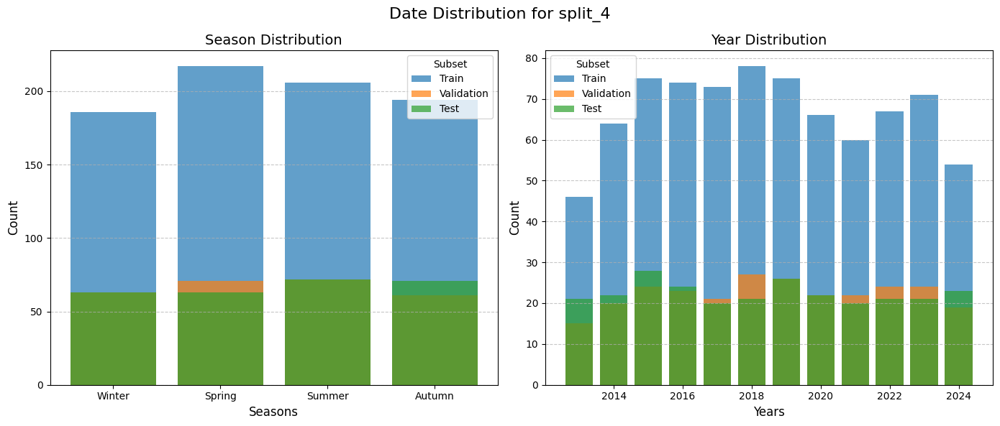


--- split_5 ---


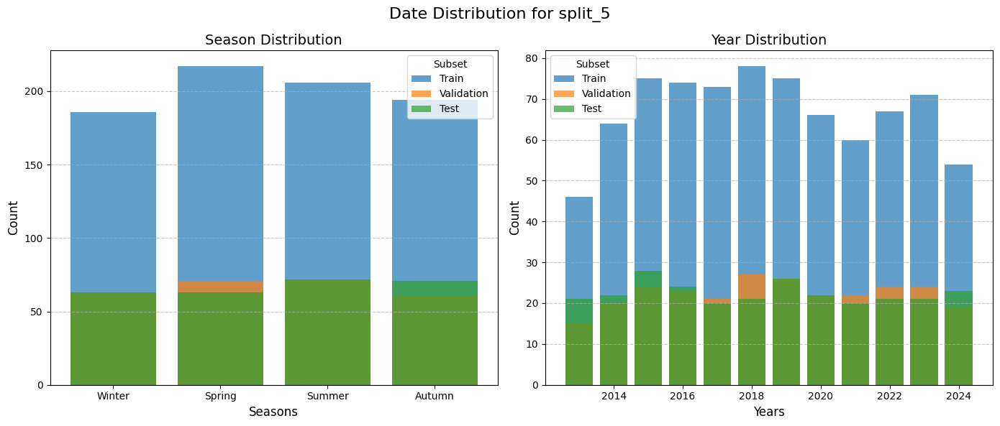

In [56]:
import matplotlib.pyplot as plt

# Visualize season and year distributions for each split
for split_name, summary in split_season_year_summary.items():
    print(f"\n--- {split_name} ---")
    
    # Create subplots for seasons and years
    fig, axes = plt.subplots(1, 2, figsize=(14, 6))
    fig.suptitle(f"Date Distribution for {split_name}", fontsize=16)

    # Plot for seasons
    for subset_name, counts in summary.items():
        season_counts = counts['season_counts']
        seasons = list(season_counts.keys())
        values = list(season_counts.values())
        
        axes[0].bar(seasons, values, label=subset_name, alpha=0.7)

    axes[0].set_title("Season Distribution", fontsize=14)
    axes[0].set_xlabel("Seasons", fontsize=12)
    axes[0].set_ylabel("Count", fontsize=12)
    axes[0].legend(title="Subset", fontsize=10)
    axes[0].grid(axis='y', linestyle='--', alpha=0.7)

    # Plot for years
    for subset_name, counts in summary.items():
        year_counts = counts['year_counts']
        years = list(year_counts.keys())
        values = list(year_counts.values())
        
        axes[1].bar(years, values, label=subset_name, alpha=0.7)

    axes[1].set_title("Year Distribution", fontsize=14)
    axes[1].set_xlabel("Years", fontsize=12)
    axes[1].set_ylabel("Count", fontsize=12)
    axes[1].legend(title="Subset", fontsize=10)
    axes[1].grid(axis='y', linestyle='--', alpha=0.7)

    # Adjust layout and show plots
    plt.tight_layout()
    plt.subplots_adjust(top=0.88)
    plt.savefig(f"../plots/date_distribution_{split_name}.png")
    plt.show()


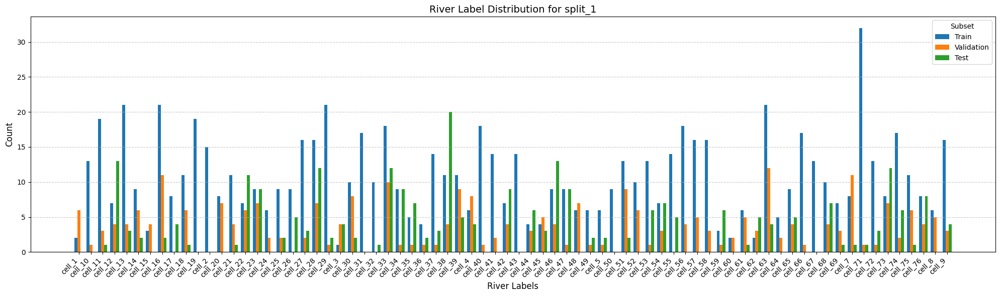

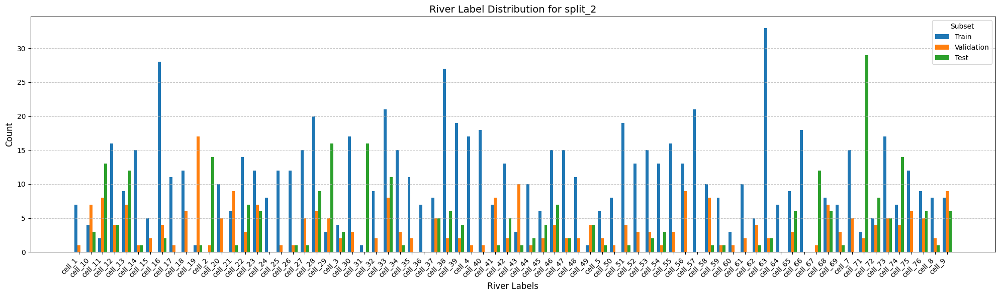

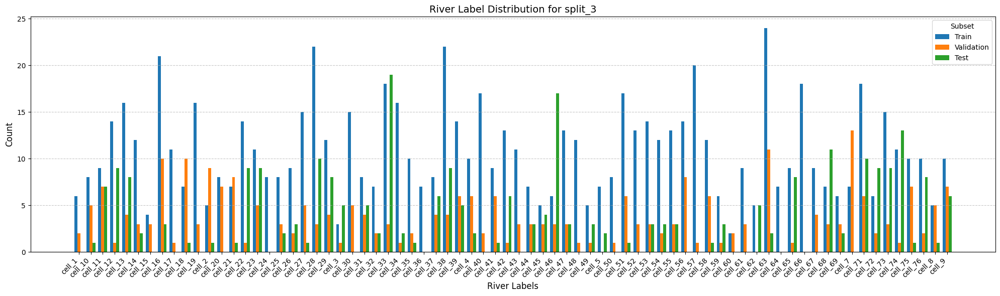

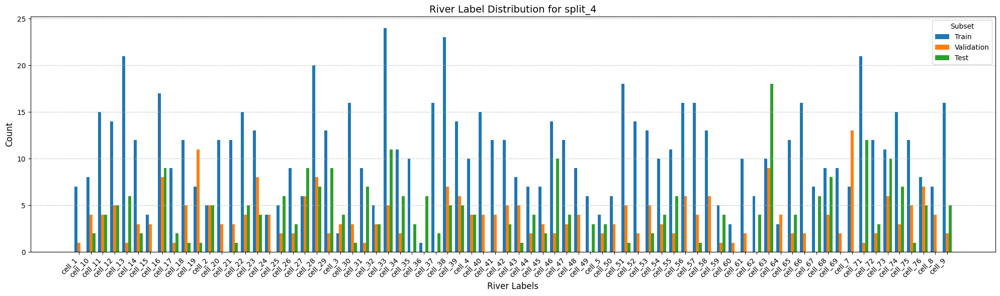

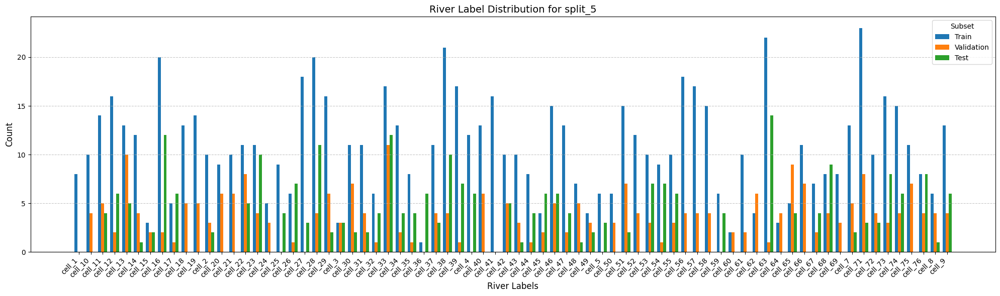

In [57]:
river_labels = labels
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']

    # Get the river labels for each subset
    train_labels = [river_labels[i] for i in train_indices]
    val_labels = [river_labels[i] for i in val_indices]
    test_labels = [river_labels[i] for i in test_indices]

    # Count occurrences of each river label in each subset
    train_counts = Counter(train_labels)
    val_counts = Counter(val_labels)
    test_counts = Counter(test_labels)

    # Get all unique river labels
    all_labels = sorted(set(river_labels))

    # Prepare data for plotting
    train_values = [train_counts[label] for label in all_labels]
    val_values = [val_counts[label] for label in all_labels]
    test_values = [test_counts[label] for label in all_labels]

    # Plot the distribution
    fig, ax = plt.subplots(figsize=(20, 6))
    x = range(len(all_labels))

    ax.bar(x, train_values, width=0.25, label="Train", align="center")
    ax.bar([p + 0.25 for p in x], val_values, width=0.25, label="Validation", align="center")
    ax.bar([p + 0.5 for p in x], test_values, width=0.25, label="Test", align="center")

    # Customize the plot
    ax.set_title(f"River Label Distribution for {split_name}", fontsize=14)
    ax.set_xlabel("River Labels", fontsize=12)
    ax.set_ylabel("Count", fontsize=12)
    ax.set_xticks([p + 0.25 for p in x])
    ax.set_xticklabels(all_labels, rotation=45, ha="right")
    ax.legend(title="Subset", fontsize=10)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()
    

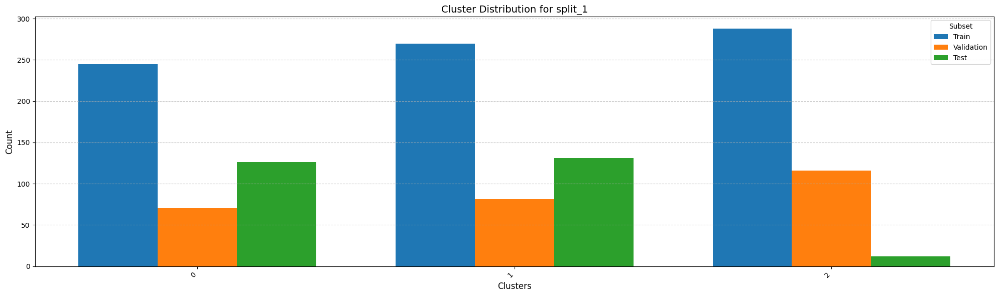

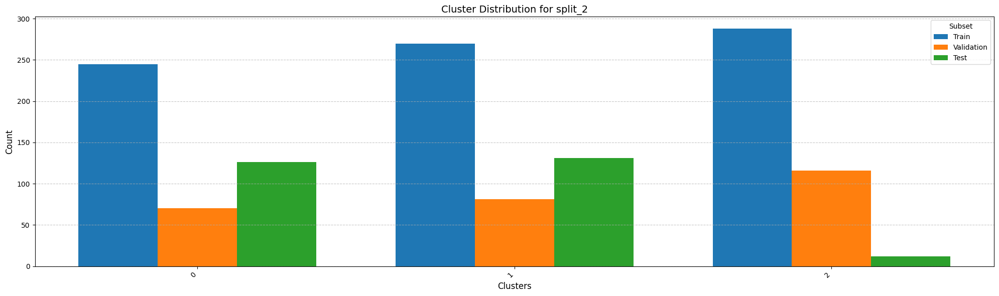

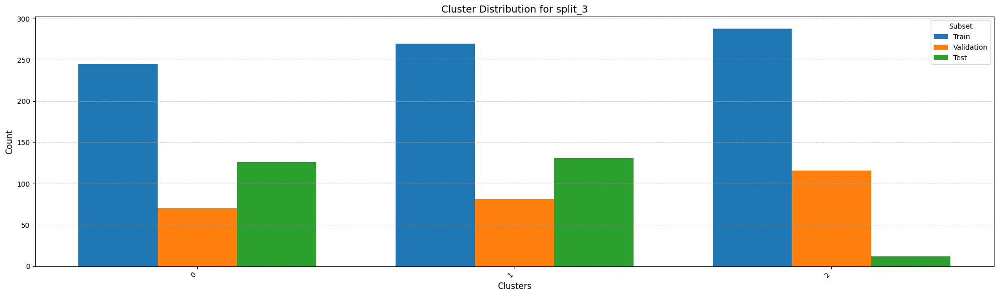

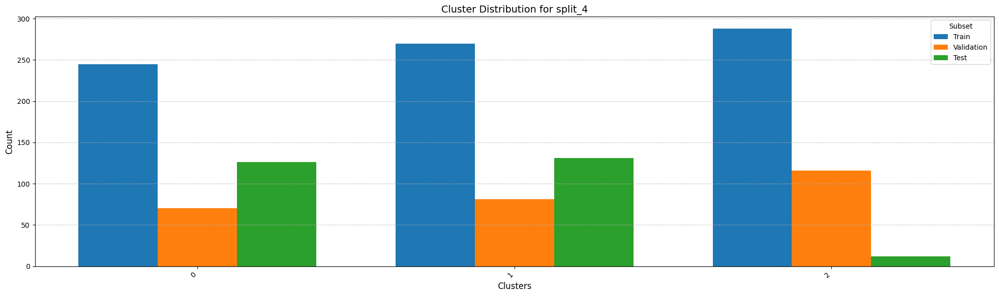

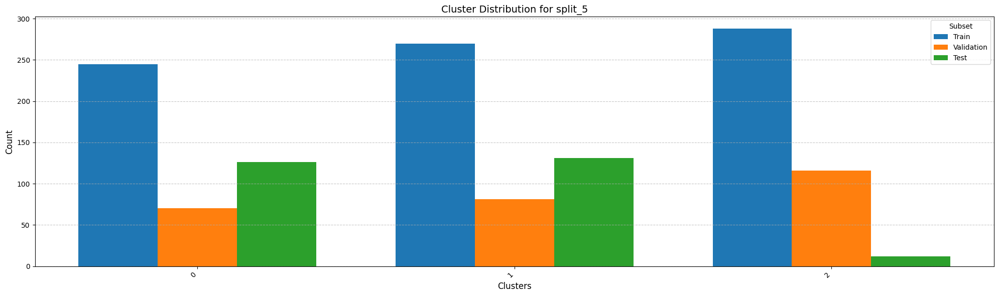

In [58]:
for split_file in split_indices_files:
    split_name = split_file.split('_indices')[0]

    # Load indices for the split
    with open(f"{input_dir}/{split_file}", 'r') as f:
        split_indices = json.load(f)

    # Extract train, validation, and test indices
    train_indices = split_indices['train']
    val_indices = split_indices['val']
    test_indices = split_indices['test']

    # Get the river labels for each subset
    train_labels = [ordered_clusters[i] for i in train_indices]
    val_labels = [ordered_clusters[i] for i in val_indices]
    test_labels = [ordered_clusters[i] for i in test_indices]

    # Count occurrences of each river label in each subset
    train_counts = Counter(train_labels)
    val_counts = Counter(val_labels)
    test_counts = Counter(test_labels)

    # Get all unique river labels
    all_labels = sorted(set(ordered_clusters))

    # Prepare data for plotting
    train_values = [train_counts[label] for label in all_labels]
    val_values = [val_counts[label] for label in all_labels]
    test_values = [test_counts[label] for label in all_labels]

    # Plot the distribution
    fig, ax = plt.subplots(figsize=(20, 6))
    x = range(len(all_labels))

    ax.bar(x, train_values, width=0.25, label="Train", align="center")
    ax.bar([p + 0.25 for p in x], val_values, width=0.25, label="Validation", align="center")
    ax.bar([p + 0.5 for p in x], test_values, width=0.25, label="Test", align="center")

    # Customize the plot
    ax.set_title(f"Cluster Distribution for {split_name}", fontsize=14)
    ax.set_xlabel("Clusters", fontsize=12)
    ax.set_ylabel("Count", fontsize=12)
    ax.set_xticks([p + 0.25 for p in x])
    ax.set_xticklabels(all_labels, rotation=45, ha="right")
    ax.legend(title="Subset", fontsize=10)
    ax.grid(axis='y', linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.savefig(f"../plots/cluster_dist_{split_name}.png")
    plt.show()
    

## Visualization of all variables

Index: 1, Label: cell_67
lst range: Min = 0.0, Max = 250.0
ndvi range: Min = -0.010694282129406929, Max = 0.5930615663528442
altitude range: Min = 370.42672966442, Max = 421.05482340703446
slope range: Min = 0.25141054780391375, Max = 1.41806509759782
direction range: Min = 1.0, Max = 210.36631797630483


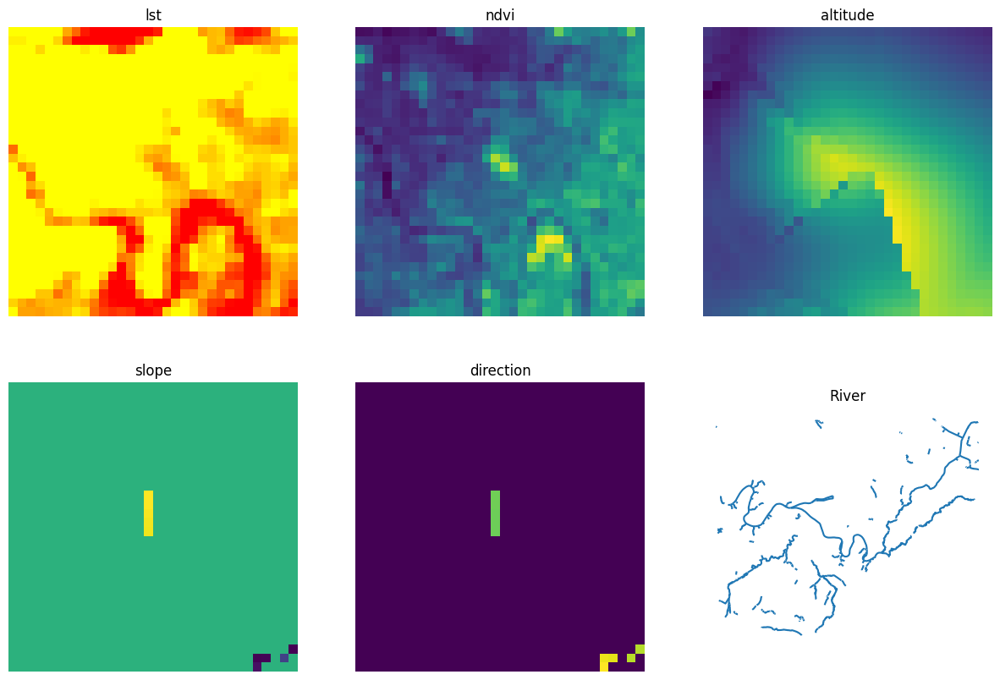



Index: 2, Label: cell_67
lst range: Min = 0.0, Max = 214.0
ndvi range: Min = 0.020905153825879097, Max = 0.7934971451759338
altitude range: Min = 370.42672966442, Max = 421.05482340703446
slope range: Min = 0.25141054780391375, Max = 1.41806509759782
direction range: Min = 1.0, Max = 210.36631797630483


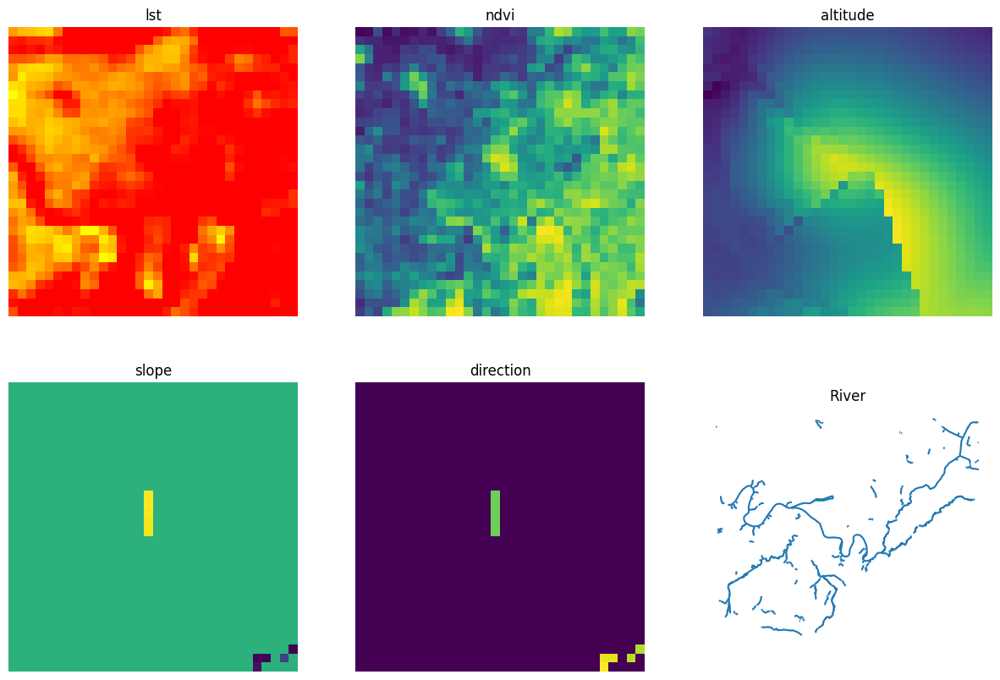



Index: 3, Label: cell_67
lst range: Min = 0.0, Max = 205.0
ndvi range: Min = -0.05432945117354393, Max = 0.7939263582229614
altitude range: Min = 370.42672966442, Max = 421.05482340703446
slope range: Min = 0.25141054780391375, Max = 1.41806509759782
direction range: Min = 1.0, Max = 210.36631797630483


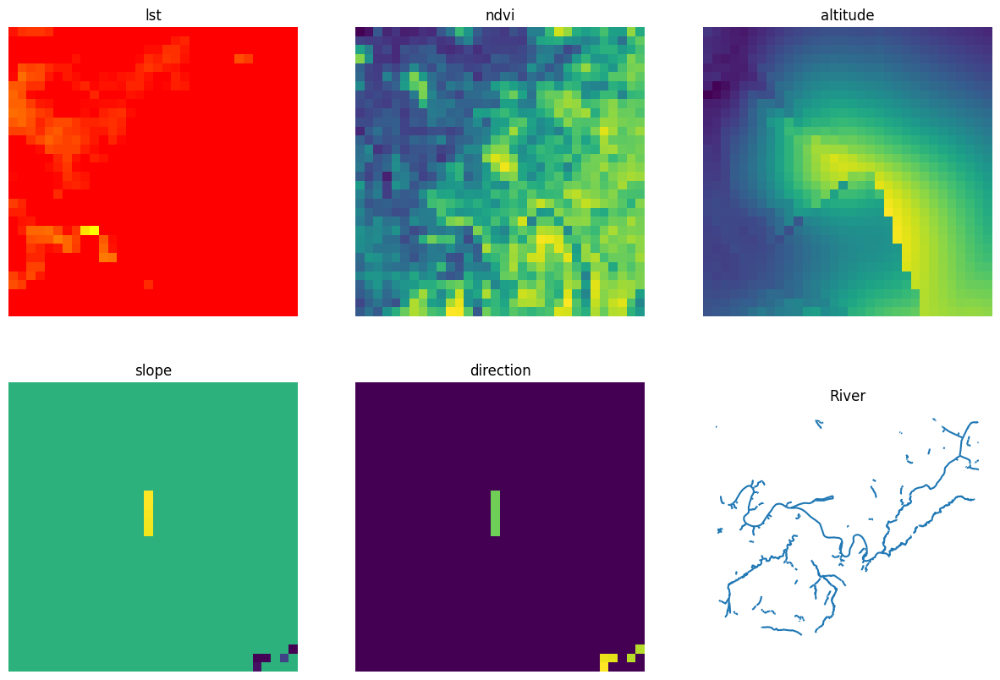



Index: 4, Label: cell_67
lst range: Min = 0.0, Max = 165.0
ndvi range: Min = 0.08873917907476425, Max = 0.7064801454544067
altitude range: Min = 370.42672966442, Max = 421.05482340703446
slope range: Min = 0.25141054780391375, Max = 1.41806509759782
direction range: Min = 1.0, Max = 210.36631797630483


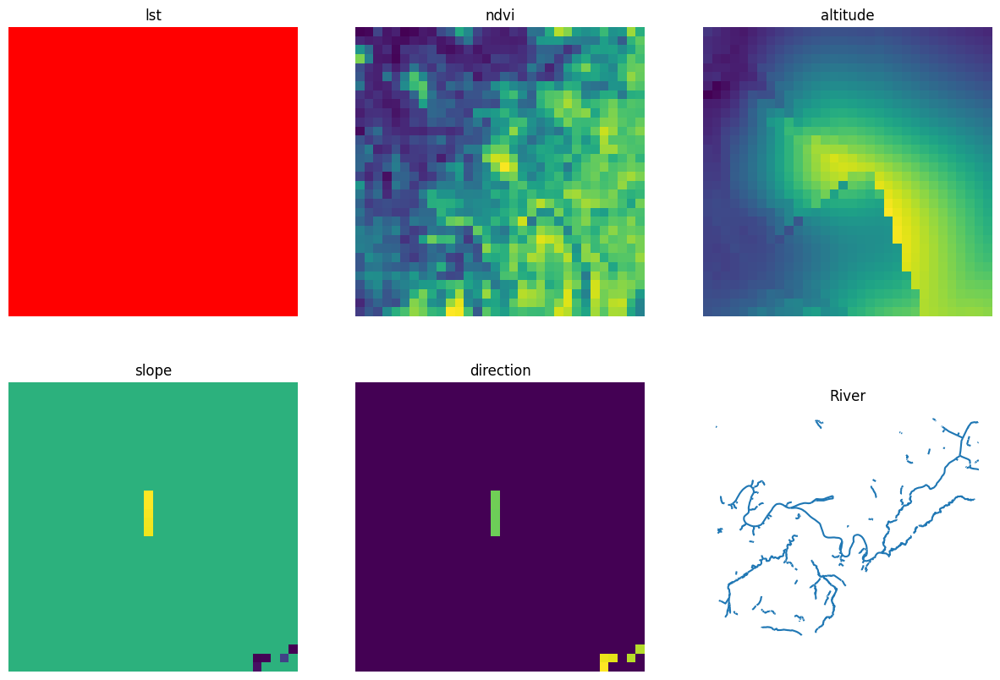

In [13]:
import matplotlib.pyplot as plt
import numpy as np
#inputs = ['lst','ndvi','altitude','slope','direction']
# Loop through the first 5 elements
for i in range(1, 5):
    # Print label and check spatial bounds and CRS
    print(f"Index: {i}, Label: {labels[i]}")
    riu = labels[i]
    
    # Gather data for visualization and print ranges
    data = [total_data[k][i] for k in inputs]
    for k, var_data in zip(inputs, data):
        var_min, var_max = np.min(var_data), np.max(var_data)
        print(f"{k} range: Min = {var_min}, Max = {var_max}")

    # Set up the figure and axes for a 2x3 grid
    fig, axs  plt.subplots(2, 3, figsize=(15, 10))  # Adjust figsize as needed
    
    # Loop through each subplot and display the data
    for j, ax in enumerate(axs.flat):
        if j == 5:
            # Plot river cell for the last subplot
            river_cells[riu].plot(ax=ax)
        elif inputs[j] == 'lst':
            # Plot LST data with clipping
            ax.imshow(np.clip(data[j] * (6 / 255), 0, 1), cmap='viridis')
        else:
            # Plot other data without clipping
            ax.imshow(data[j], cmap='viridis')
        
        # Set title and turn off axis for a cleaner look
        ax.set_title(f"{inputs[j]}" if j != 5 else 'River')
        ax.axis("off")

    # Show the plot
    plt.show()
    
    # Print a separator for clarity between iterations
    print("\n" + "="*40 + "\n")


## Correlation analysis

In [22]:
dir_path = '../data/external/raster_masks/'
files = os.listdir(dir_path)
river_masks = {}
river_masks_expanded = {}
raster_metas = {}
for raster in files:
    cl_int=raster.split('bw_cell_')[-1].split('.')[0]
    cc = raster.split('bw_')[-1].split('.')[0]
    raster_path = os.path.join(dir_path, raster)
    rast,meta = load_raster(raster_path,False)
    river_masks[cc]=rast
    river_mask_expanded = np.expand_dims(rast, axis=-1)  # Expande para tener forma (height, width, 1)
    river_mask_expanded = np.repeat(river_mask_expanded, total_data['lst'].shape[-1], axis=-1)  # Expande a (height, width, 3)
    river_masks_expanded[cc] = river_mask_expanded
    raster_metas[cc]=meta

In [23]:
from collections import Counter
imgs_per_river = Counter(labels)
imgs_per_river

Counter({'cell_63': 36,
         'cell_28': 35,
         'cell_71': 34,
         'cell_38': 34,
         'cell_33': 32,
         'cell_46': 27,
         'cell_73': 27,
         'cell_13': 26,
         'cell_74': 25,
         'cell_23': 25,
         'cell_51': 25,
         'cell_22': 24,
         'cell_12': 24,
         'cell_11': 23,
         'cell_9': 23,
         'cell_16': 23,
         'cell_56': 22,
         'cell_68': 21,
         'cell_76': 21,
         'cell_57': 21,
         'cell_27': 21,
         'cell_29': 20,
         'cell_7': 20,
         'cell_42': 20,
         'cell_40': 20,
         'cell_66': 20,
         'cell_47': 20,
         'cell_39': 20,
         'cell_19': 19,
         'cell_58': 19,
         'cell_18': 19,
         'cell_75': 19,
         'cell_53': 19,
         'cell_55': 19,
         'cell_37': 18,
         'cell_34': 18,
         'cell_4': 18,
         'cell_31': 17,
         'cell_72': 17,
         'cell_65': 17,
         'cell_54': 17,
         'cell_14':

In [24]:
source_dir = '../data/preprocessed'
data = ['lst','wt','ndvi']
all_ds = {k: [] for k in data}
dates_rivs = {riv:[] for riv in river_cells.keys()}
for d in data:
    dicc={}
    source_path = os.path.join(source_dir,d)
    for subdir, dirs, files in os.walk(source_path):
        for file in files:
            if file.endswith('.csv'):
                print('entro', d, file.split('.')[0])
                if d != 'wt' and file.split('.')[0] in labels:
                    dicc[subdir.split('/')[-1]] = pd.read_csv(f'{subdir}/{file}',index_col=0)
                elif d == 'wt':
                    df = pd.read_csv(f'{subdir}/{file}',index_col=0)
                    for i,r in df.iterrows():
                        if r.Cell not in dicc and r.Cell in labels:  
                            dicc[r.Cell] = [r.WaterTemp]
                        elif r.Cell in dicc :
                            dicc[r.Cell].append(r.WaterTemp)
                        dates_rivs[r.Cell].append(r.Date)
                        
    all_ds[d]=dicc

entro lst cell_67
entro lst cell_2
entro lst cell_31
entro lst cell_19
entro lst cell_29
entro lst cell_71
entro lst cell_49
entro lst cell_43
entro lst cell_10
entro lst cell_13
entro lst cell_41
entro lst cell_21
entro lst cell_11
entro lst cell_58
entro lst cell_56
entro lst cell_74
entro lst cell_37
entro lst cell_62
entro lst cell_72
entro lst cell_65
entro lst cell_8
entro lst cell_68
entro lst cell_9
entro lst cell_18
entro lst cell_69
entro lst cell_3
entro lst cell_46
entro lst cell_23
entro lst cell_28
entro lst cell_33
entro lst cell_54
entro lst cell_76
entro lst cell_20
entro lst cell_22
entro lst cell_59
entro lst cell_38
entro lst cell_7
entro lst cell_75
entro lst cell_12
entro lst cell_48
entro lst cell_42
entro lst cell_14
entro lst cell_73
entro lst cell_51
entro lst cell_17
entro lst cell_45
entro lst cell_1
entro lst cell_30
entro lst cell_60
entro lst cell_15
entro lst cell_52
entro lst cell_53
entro lst cell_26
entro lst cell_61
entro lst cell_35
entro lst cell_4

### River zones

In [29]:
from scipy.stats import pearsonr
import numpy as np
import matplotlib.cm as cm

results = []
# Iterar sobre los ríos
for a, river in enumerate(np.unique(labels)): 
    # Inicializar listas para guardar las medias y correlaciones
    lst_means = []
    ndvi_means = []
    water_temps = []
    
    # Iterar sobre las fechas (filas)
    for n, (i, row) in enumerate(all_ds['lst'][river].iterrows()):
        # Calcular la media de LST y NDVI para la fecha (asumiendo valores espaciales en cada fila)
        lst_mean = all_ds['lst'][river].loc[i].mean()
        ndvi_mean = all_ds['ndvi'][river].loc[i].mean()
        water_temp = all_ds['wt'][river][n]  # Obtener el único valor de WT para esta fecha
        
        # Guardar las medias para esta fecha
        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp)
    
    # Calcular las correlaciones finales entre las medias de las fechas
    if len(lst_means) > 1 and len(ndvi_means) > 1:  # Evitar errores si hay pocas fechas
        corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
        corr_temp_water, _ = pearsonr(lst_means, water_temps)
        corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
        results.append({
            'River': river,
            'Correlation_LST_NDVI': corr_temp_ndvi,
            'Correlation_LST_WT': corr_temp_water,
            'Correlation_NDVI_WT': corr_ndvi_water
        })
        
    else:
        print(f'River {river} has insufficient data for correlation analysis.')
results_df = pd.DataFrame(results)

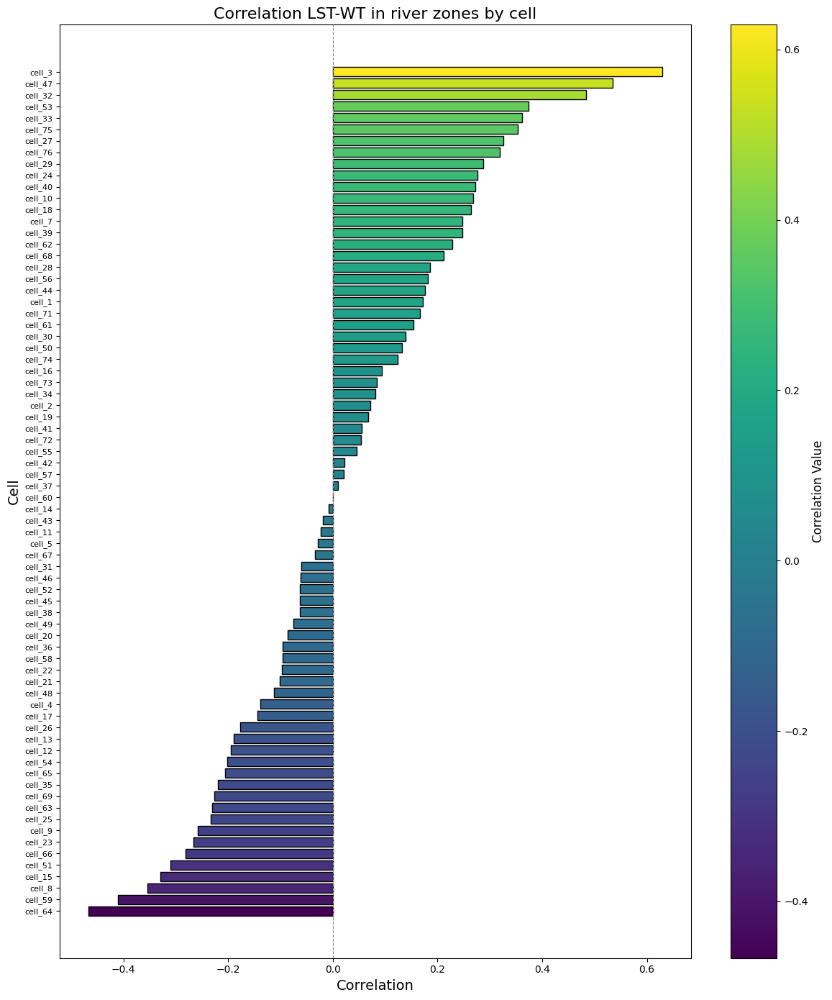

In [40]:
results_df_sorted = results_df.sort_values('Correlation_LST_WT')

# Normalize the correlation values for the colormap
norm = Normalize(vmin=results_df_sorted['Correlation_LST_WT'].min(), 
                 vmax=results_df_sorted['Correlation_LST_WT'].max())
colors = cm.viridis(norm(results_df_sorted['Correlation_LST_WT']))

# Plot horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 14))
bars = ax.barh(
    results_df_sorted['River'], 
    results_df_sorted['Correlation_LST_WT'], 
    color=colors, 
    edgecolor='black'
)

# Add colorbar with correct linkage
sm = cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])  # ScalarMappable necesita un array para funcionar
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Correlation Value', fontsize=12)

# Add guide line at 0
ax.axvline(0, color='gray', linestyle='--', linewidth=0.8)

# Configure labels and title
ax.set_title('Correlation LST-WT in river zones by cell', fontsize=16)
ax.set_xlabel('Correlation', fontsize=14)
ax.set_ylabel('Cell', fontsize=14)

# Reduce font size of y-axis labels
ax.tick_params(axis='y', labelsize=8)

# Adjust layout
plt.tight_layout()
plt.savefig('../plots/wt_lst_corr_riv.png')
plt.show()

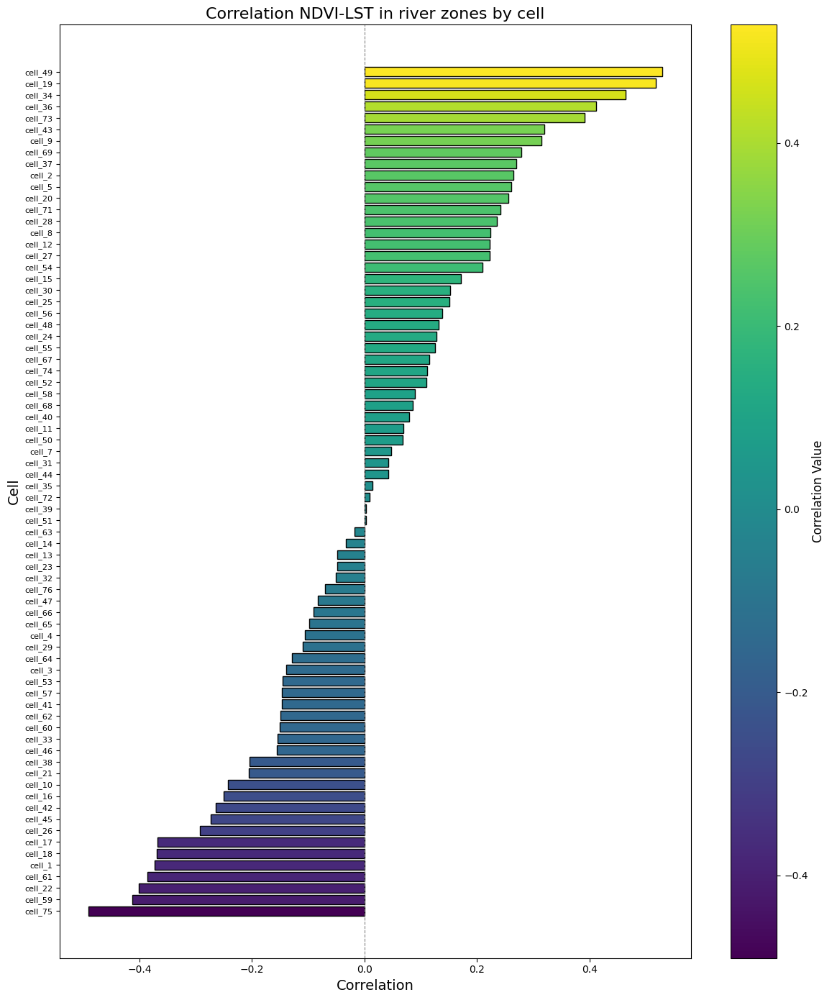

In [34]:
results_df_sorted = results_df.sort_values('Correlation_LST_NDVI')

# Normalize the correlation values for the colormap
norm = Normalize(vmin=results_df_sorted['Correlation_LST_NDVI'].min(), 
                 vmax=results_df_sorted['Correlation_LST_NDVI'].max())
colors = cm.viridis(norm(results_df_sorted['Correlation_LST_NDVI']))

# Plot horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 14))
bars = ax.barh(
    results_df_sorted['River'], 
    results_df_sorted['Correlation_LST_NDVI'], 
    color=colors, 
    edgecolor='black'
)

# Add colorbar with correct linkage
sm = cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])  # ScalarMappable necesita un array para funcionar
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Correlation Value', fontsize=12)

# Add guide line at 0
ax.axvline(0, color='gray', linestyle='--', linewidth=0.8)

# Configure labels and title
ax.set_title('Correlation NDVI-LST in river zones by cell', fontsize=16)
ax.set_xlabel('Correlation', fontsize=14)
ax.set_ylabel('Cell', fontsize=14)

# Reduce font size of y-axis labels
ax.tick_params(axis='y', labelsize=8)

# Adjust layout
plt.tight_layout()
plt.savefig('../plots/ndvi_lst_corr_riv.png')
plt.show()

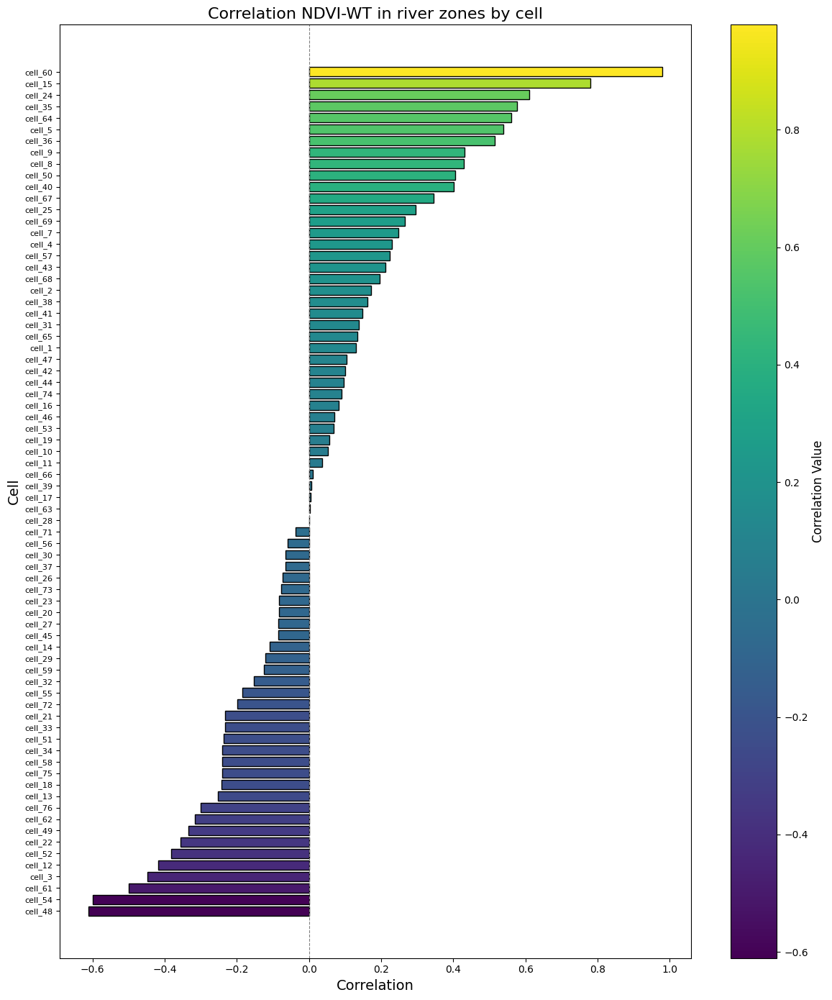

In [31]:
results_df_sorted = results_df.sort_values('Correlation_NDVI_WT')

# Normalize the correlation values for the colormap
norm = Normalize(vmin=results_df_sorted['Correlation_NDVI_WT'].min(), 
                 vmax=results_df_sorted['Correlation_NDVI_WT'].max())
colors = cm.viridis(norm(results_df_sorted['Correlation_NDVI_WT']))

# Plot horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 14))
bars = ax.barh(
    results_df_sorted['River'], 
    results_df_sorted['Correlation_NDVI_WT'], 
    color=colors, 
    edgecolor='black'
)

# Add colorbar with correct linkage
sm = cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])  # ScalarMappable necesita un array para funcionar
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Correlation Value', fontsize=12)

# Add guide line at 0
ax.axvline(0, color='gray', linestyle='--', linewidth=0.8)

# Configure labels and title
ax.set_title('Correlation NDVI-WT in river zones by cell', fontsize=16)
ax.set_xlabel('Correlation', fontsize=14)
ax.set_ylabel('Cell', fontsize=14)

# Reduce font size of y-axis labels
ax.tick_params(axis='y', labelsize=8)

# Adjust layout
plt.tight_layout()
plt.savefig('../plots/ndvi_wt_corr_riv.png')
plt.show()

### Image mean

In [48]:
from scipy.stats import pearsonr
import numpy as np
results = []

start=0
for riv, num in imgs_per_river.items():
    lst_means = []
    ndvi_means = []
    water_temps = []
    for n in range(num):
        lst_mean = np.mean(total_data['lst'][start+n])
        ndvi_mean = np.mean(total_data['ndvi'][start+n])
        water_temp_mean = all_ds['wt'][riv][n]
        print(lst_mean, water_temp_mean)

        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp_mean)

    start += num
    
    corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
    corr_temp_water, _ = pearsonr(lst_means, water_temps)
    corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
    results.append({
        'River': riv,
        'Correlation_LST_NDVI': corr_temp_ndvi,
        'Correlation_LST_WT': corr_temp_water,
        'Correlation_NDVI_WT': corr_ndvi_water
    })
    
results_df = pd.DataFrame(results)

80.46502697219451 12.22
77.94749748582642 5.91
63.59219693702956 10.48
49.77043035129706 11.84
43.84676552563906 7.41
3.2239162096132836 11.78
36.45554864530762 12.02
31.870052829384804 7.56
55.46405052393675 12.43
59.9804412368685 5.73
12.395043367519975 5.24
65.45770875178277 10.74
70.89131831936538 6.34
25.24763515094916 12.63
17.739525347948074 1.44
38.45752109090487 14.46
25.938928872346878 2.44
30.585458238919575 12.43
18.28076335787773 4.0
10.863459597031275 0.86
3.9332338124513626 10.91
50.451298673947655 1.57
9.983496606349945 3.8
43.39498154819012 8.56
7.6371166457732516 5.02
52.04560869932175 1.32
13.63982224961122 2.79
28.593598569432896 9.45
11.091938902934393 9.76
56.7308954000473 1.28
58.19188732902209 12.98
24.603420446316402 4.21
39.28708694378535 2.05
26.80273860692978 13.76
38.404724369446434 1.63
38.25357783834139 12.0
39.56074996789297 4.52
26.080344756444294 12.62
13.266336262226105 7.11
10.773048748572668 1.79
60.421091149250664 11.77
54.033980955680214 3.37
44.7

In [24]:
results_df

,River,Correlation_LST_NDVI,Correlation_LST_WT,Correlation_NDVI_WT
0,cell_67,0.059181,-0.068208,0.320778
1,cell_2,0.317420,0.069308,0.177812
2,cell_31,0.063532,-0.145646,0.232462
3,cell_19,0.567718,0.100434,0.026816
4,cell_29,-0.145767,0.140863,-0.038252
...,...,...,...,...
69,cell_25,0.145967,-0.024186,0.333873
70,cell_27,0.028694,0.375985,-0.214032
71,cell_16,-0.100025,0.048393,0.080304
72,cell_4,0.053439,-0.229944,0.144543


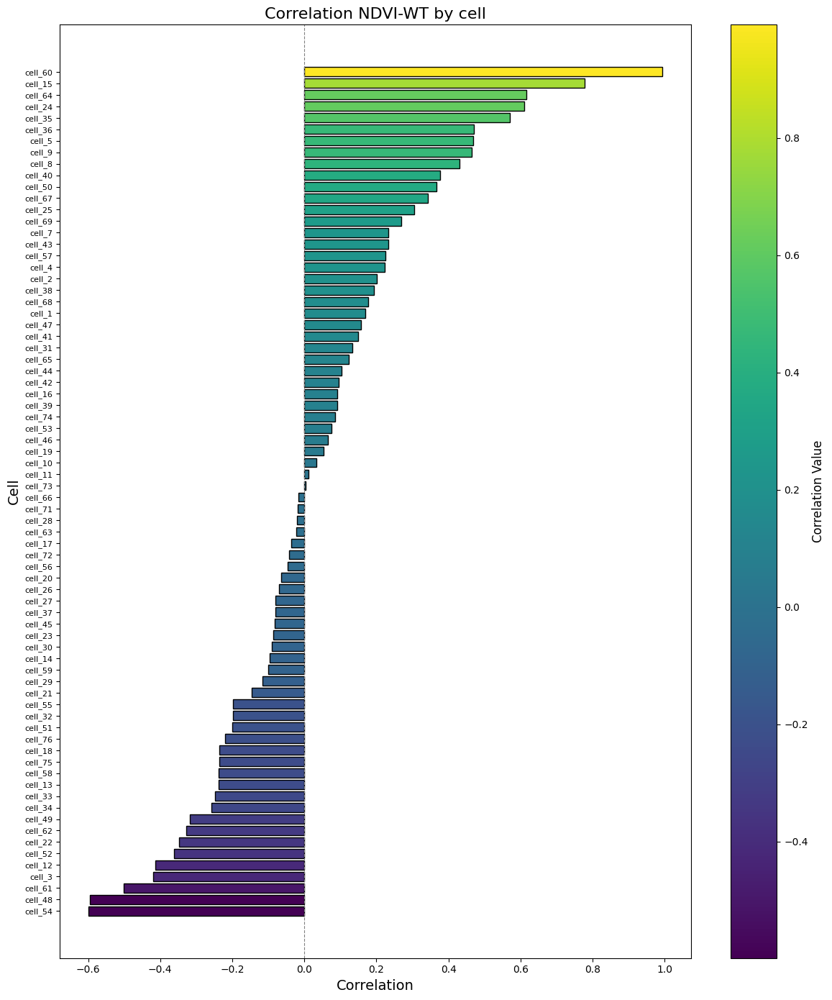

In [49]:
results_df_sorted = results_df.sort_values('Correlation_NDVI_WT')

# Normalize the correlation values for the colormap
norm = Normalize(vmin=results_df_sorted['Correlation_NDVI_WT'].min(), 
                 vmax=results_df_sorted['Correlation_NDVI_WT'].max())
colors = cm.viridis(norm(results_df_sorted['Correlation_NDVI_WT']))

# Plot horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 14))
bars = ax.barh(
    results_df_sorted['River'], 
    results_df_sorted['Correlation_NDVI_WT'], 
    color=colors, 
    edgecolor='black'
)

# Add colorbar with correct linkage
sm = cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])  # ScalarMappable necesita un array para funcionar
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Correlation Value', fontsize=12)

# Add guide line at 0
ax.axvline(0, color='gray', linestyle='--', linewidth=0.8)

# Configure labels and title
ax.set_title('Correlation NDVI-WT by cell', fontsize=16)
ax.set_xlabel('Correlation', fontsize=14)
ax.set_ylabel('Cell', fontsize=14)

# Reduce font size of y-axis labels
ax.tick_params(axis='y', labelsize=8)

# Adjust layout
plt.tight_layout()
plt.show()

### Area around river

In [37]:
def plot_neighbors(neighbors_around_river,cell_gdf,cell):
    # Paso 1: Convertir índices lineales a coordenadas (x, y)
    neighbor_coords = []
    for neighbor_index in neighbors_around_river:
        row, col = np.unravel_index(neighbor_index, array.shape)  # Índices 2D
        x, y = transform * (col + 0.5, row + 0.5)  # Transformar índices a coordenadas espaciales
        neighbor_coords.append((x, y))
    
    # Paso 2: Crear un GeoDataFrame para los vecinos
    neighbors_gdf = gpd.GeoDataFrame(
        geometry=[Point(coord) for coord in neighbor_coords],
        crs=cell_gdf.crs  # Asegúrate de usar el mismo CRS que cell_gdf
    )
    
    # Paso 3: Crear el plot
    fig, ax = plt.subplots(figsize=(10, 10))
    
    # Plotear geometrías del río
    cell_gdf.plot(ax=ax, color='blue', label='River Geometry')
    
    # Plotear vecinos
    neighbors_gdf.plot(ax=ax, color='red', marker='o', markersize=10, label='Neighboring Pixels')
    
    # Configurar el gráfico
    plt.legend()
    plt.title("River Geometry and Neighboring Pixels")
    plt.xlabel("Longitude")
    plt.ylabel("Latitude")
    plt.grid()
    if cell=='cell_9':
        plt.savefig('../plots/cell_9_adj_neigh.png')
    plt.show()


cell_37
Number of adjacent neighbors: 5091
neighbors


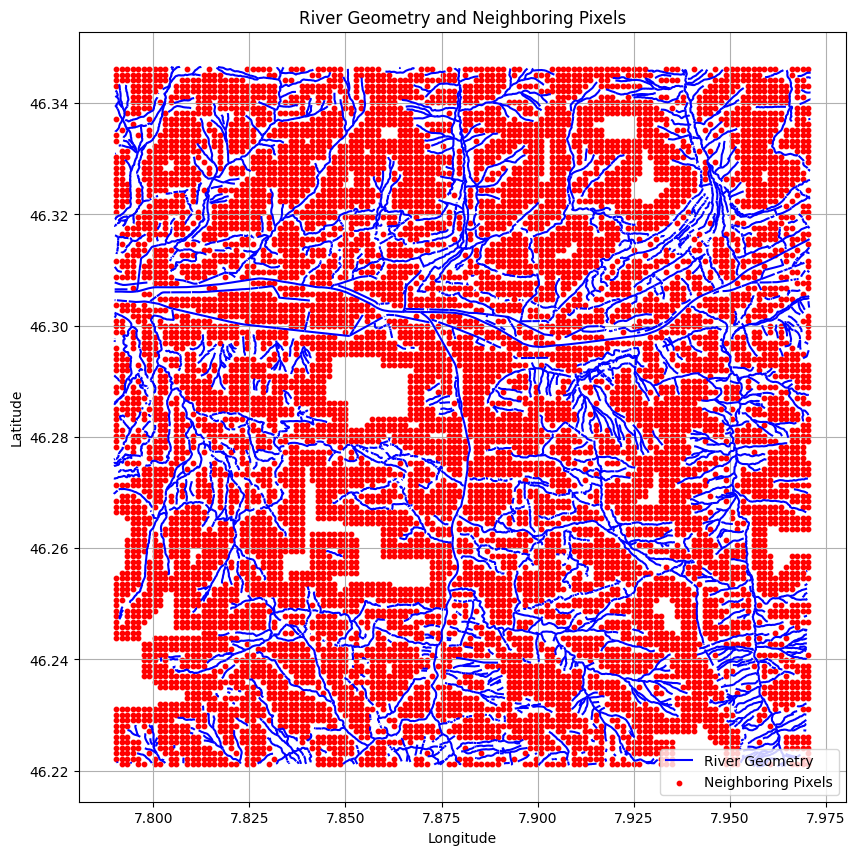


Adjacent Neighbors


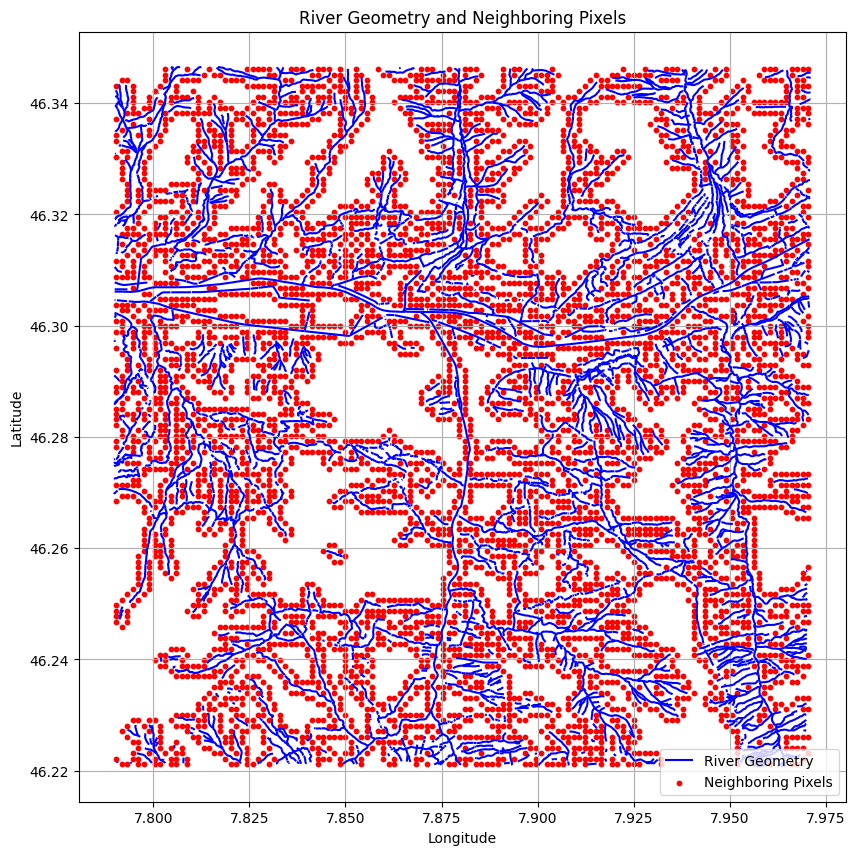

cell_8
Number of adjacent neighbors: 4387
neighbors


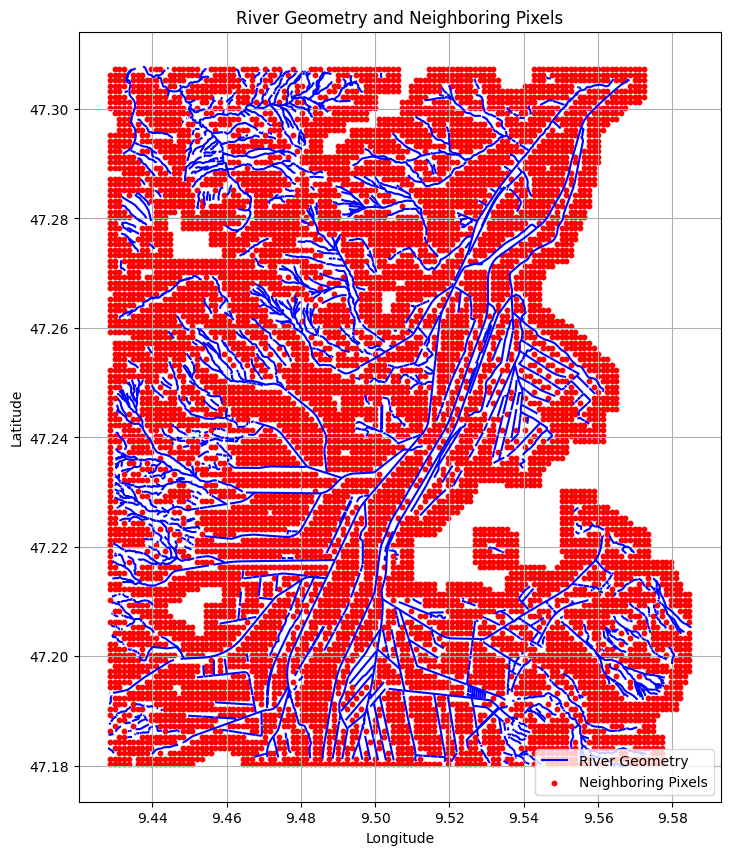


Adjacent Neighbors


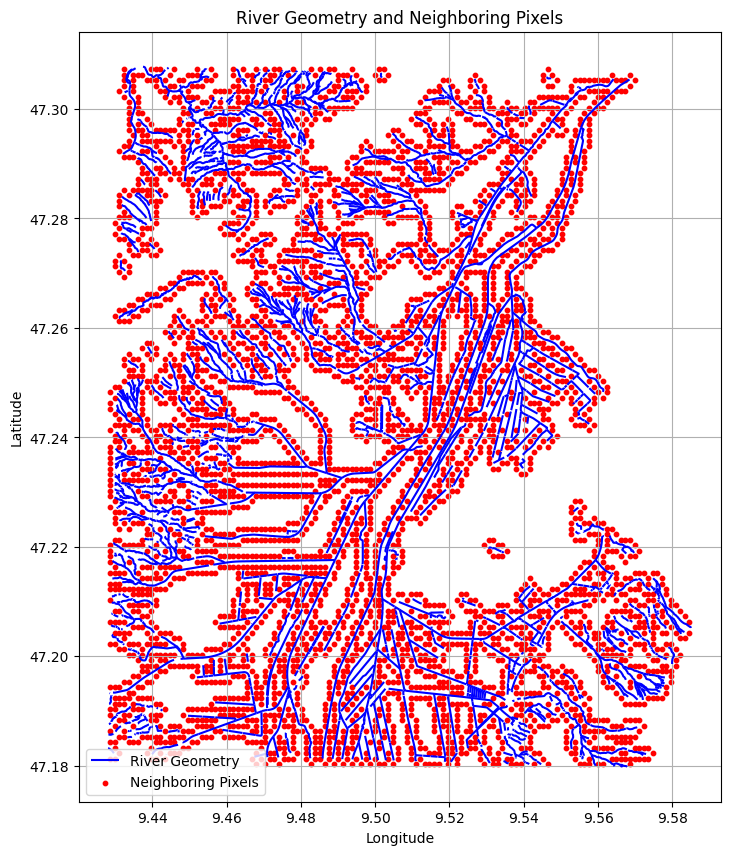

cell_33
Number of adjacent neighbors: 3483
neighbors


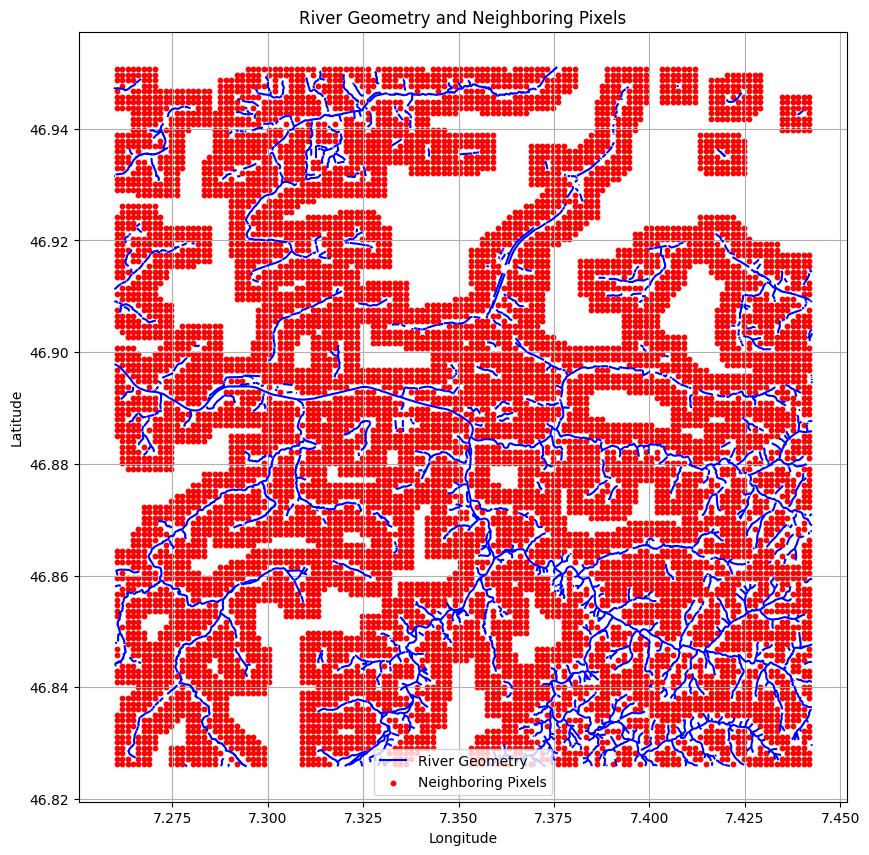


Adjacent Neighbors


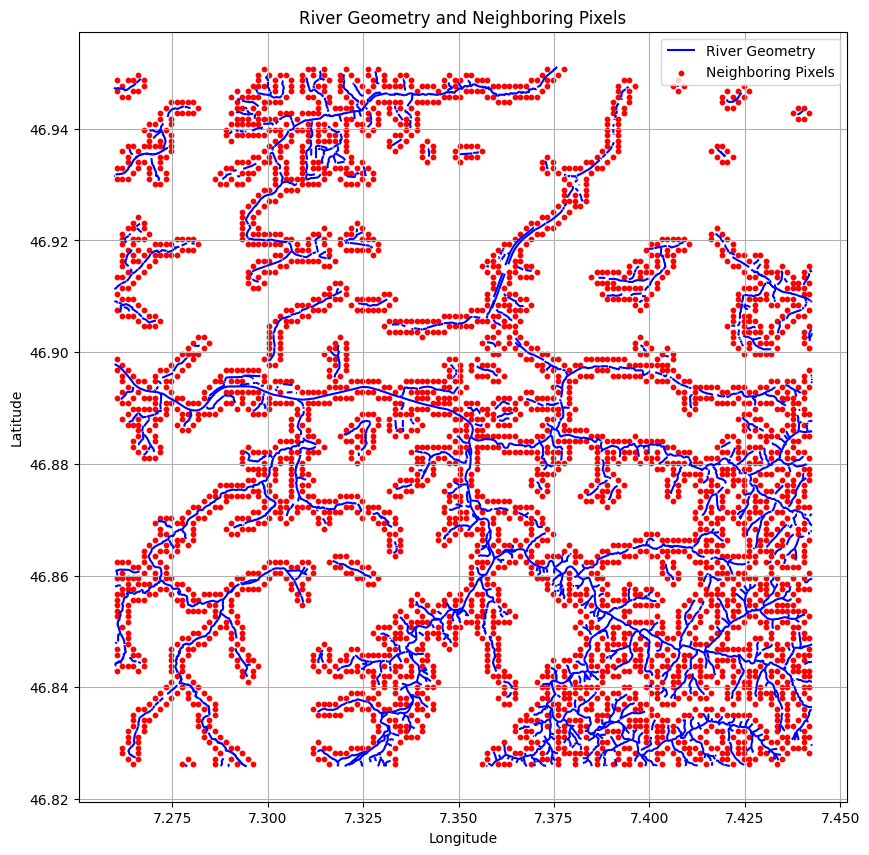

cell_9
Number of adjacent neighbors: 1818
neighbors


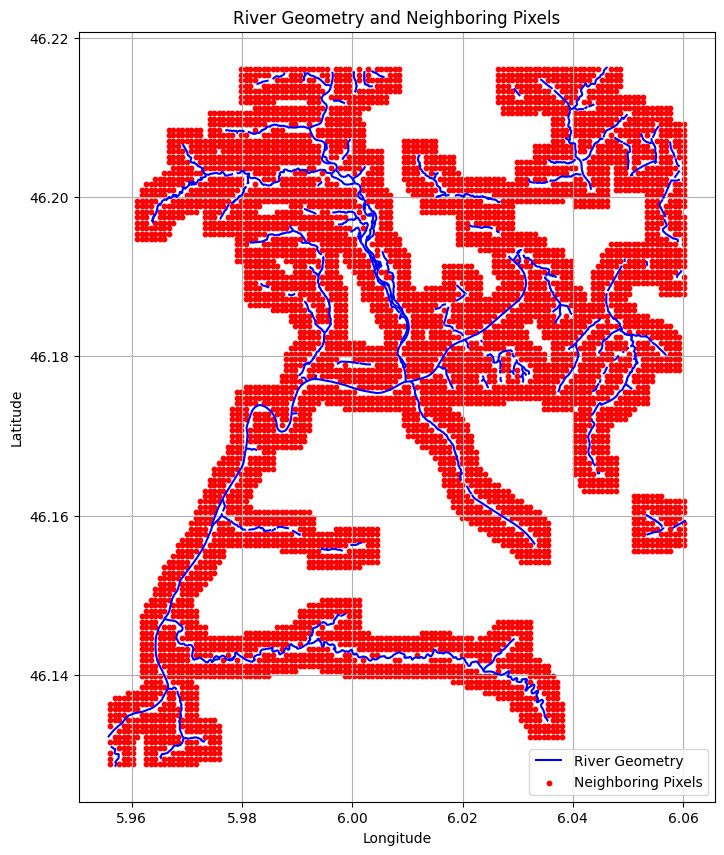


Adjacent Neighbors


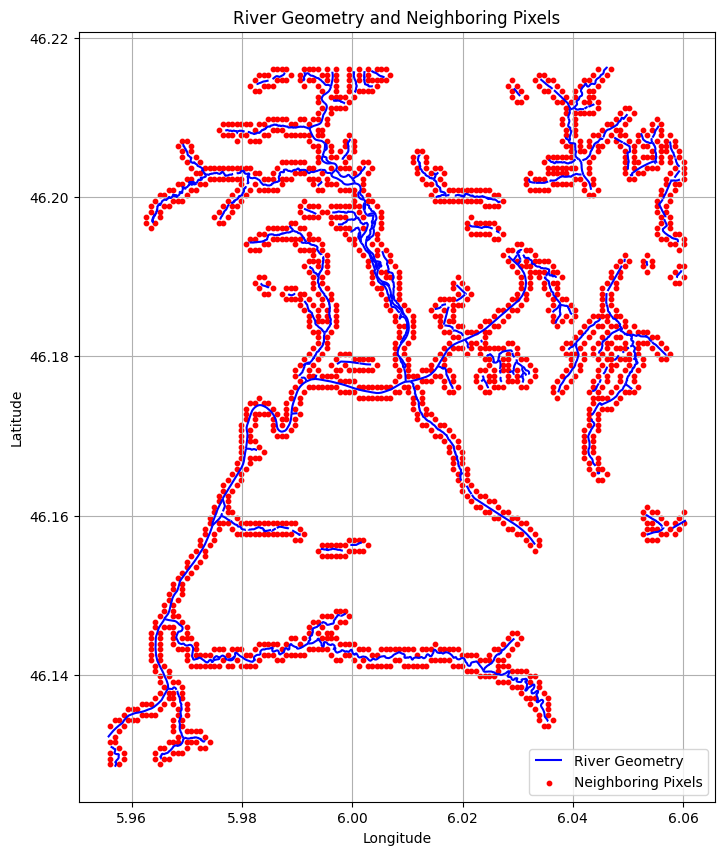

cell_42
Number of adjacent neighbors: 4529
neighbors


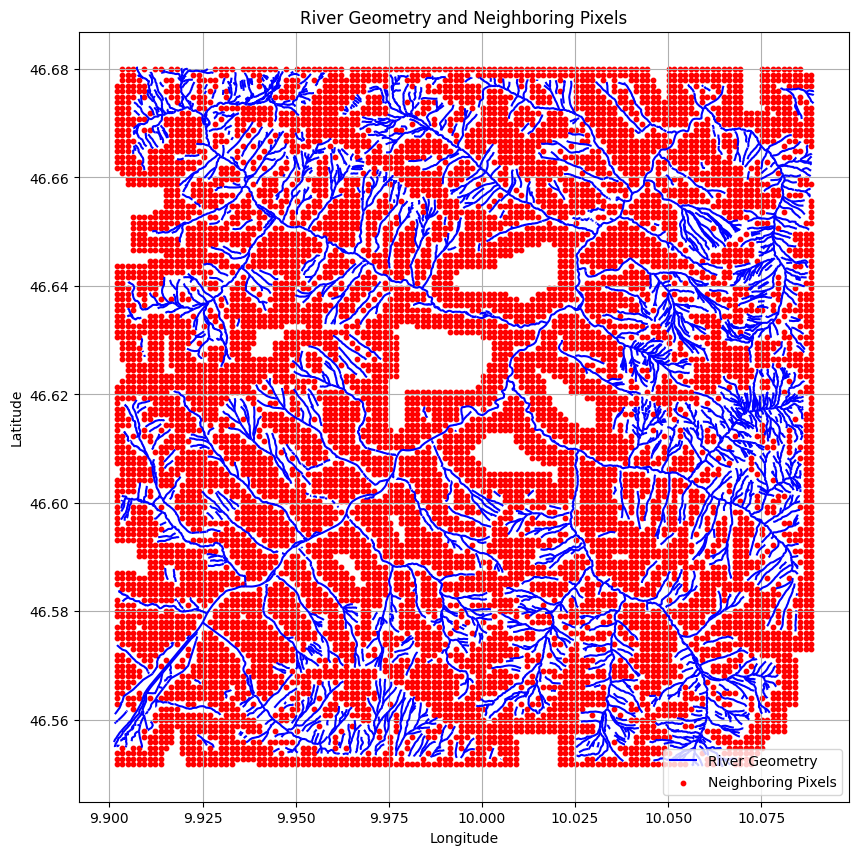


Adjacent Neighbors


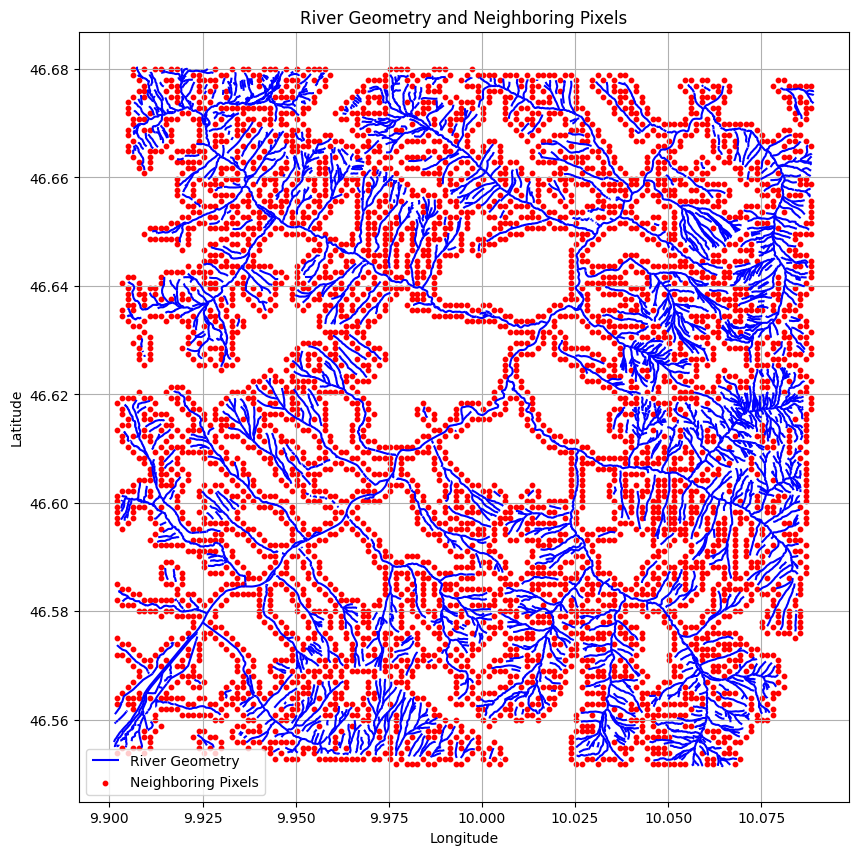

cell_78
Number of adjacent neighbors: 3256
neighbors


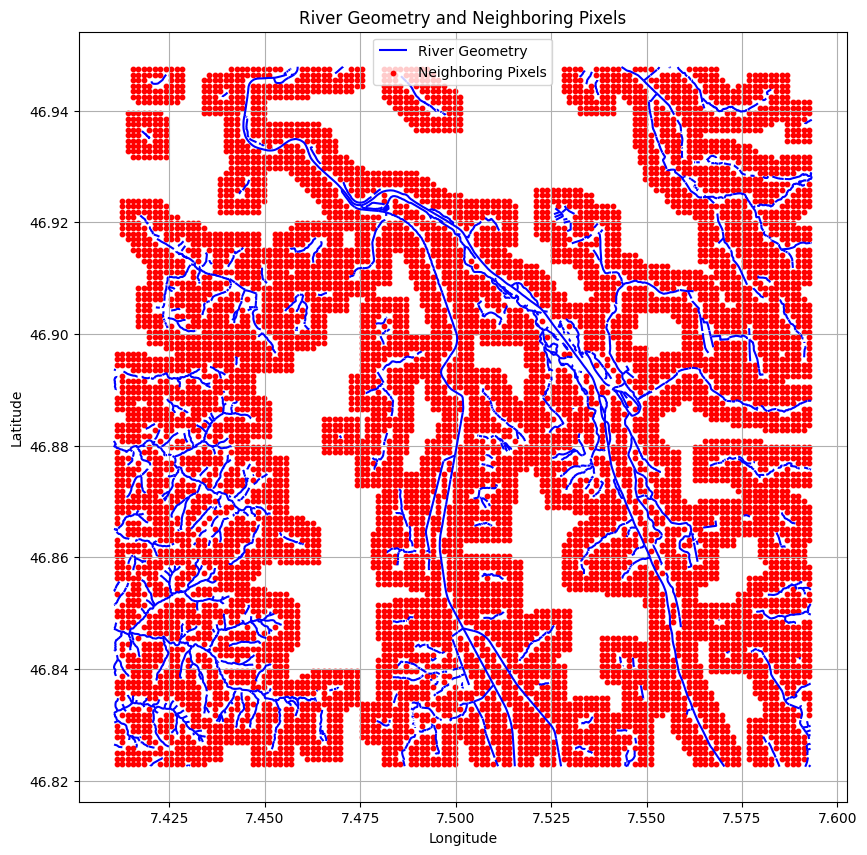


Adjacent Neighbors


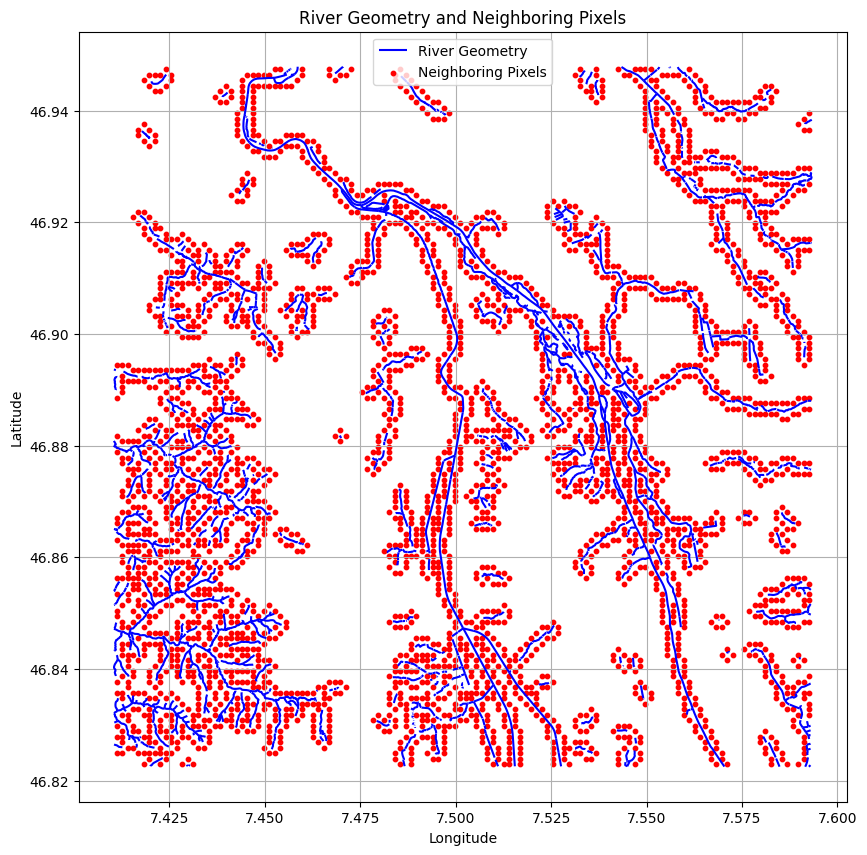

cell_6
Number of adjacent neighbors: 2403
neighbors


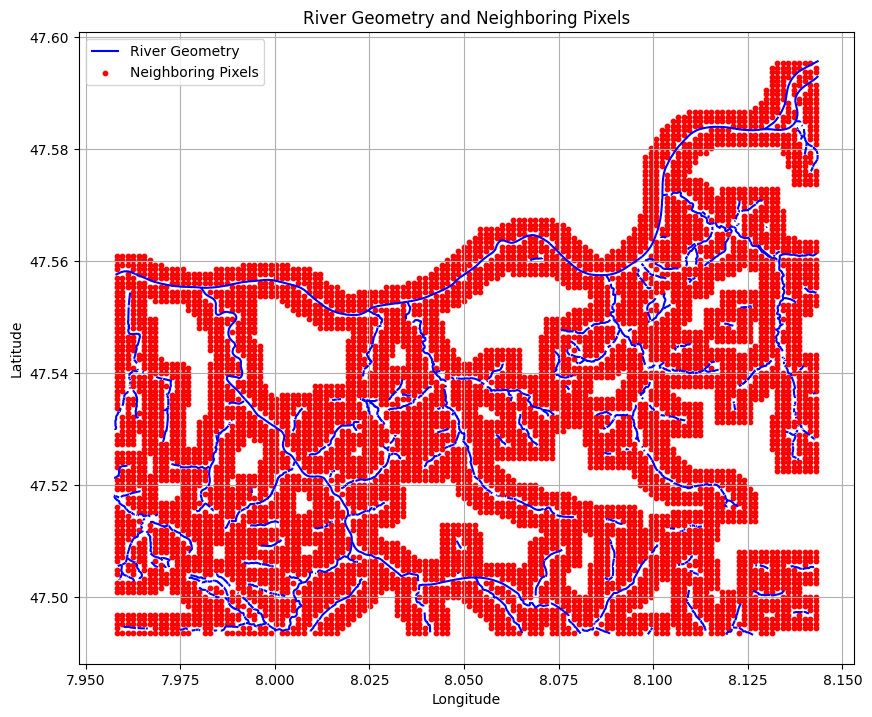


Adjacent Neighbors


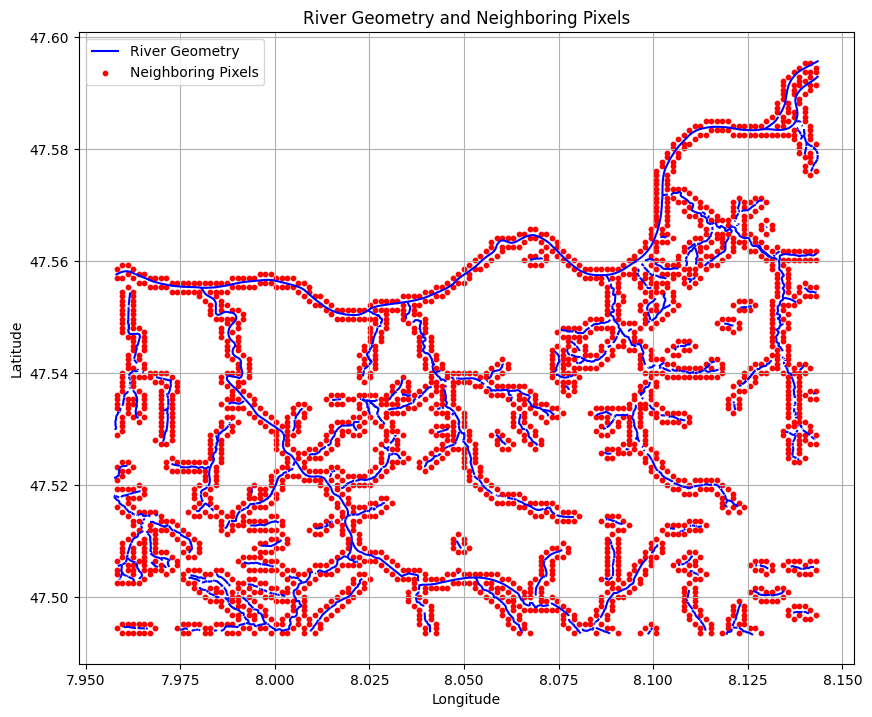

cell_46
Number of adjacent neighbors: 2045
neighbors


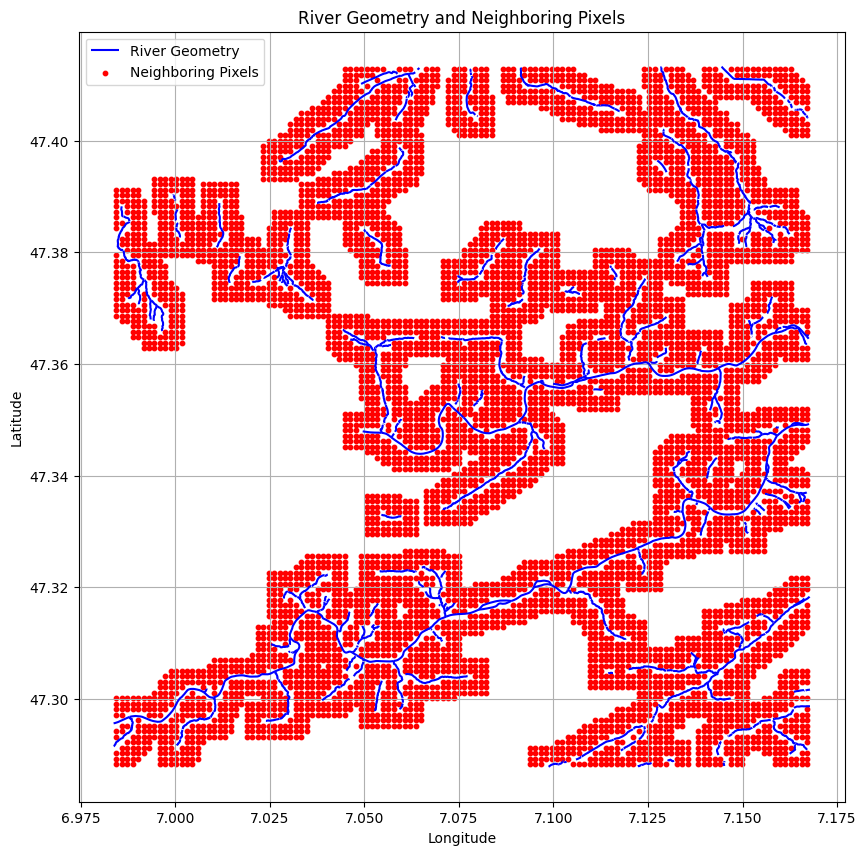


Adjacent Neighbors


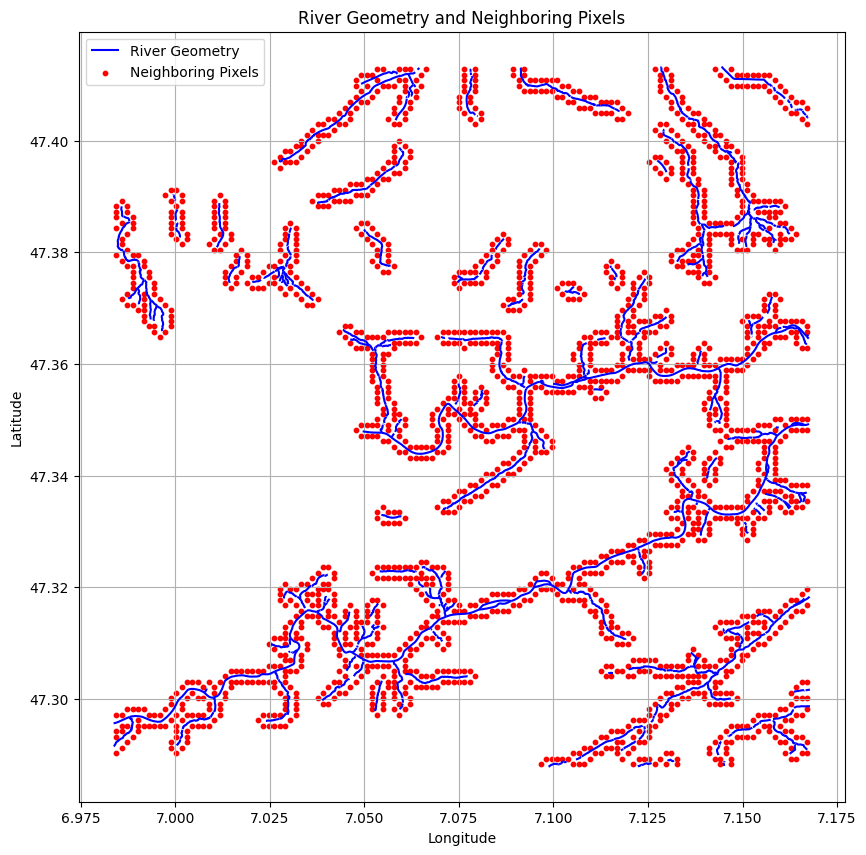

cell_31
Number of adjacent neighbors: 4608
neighbors


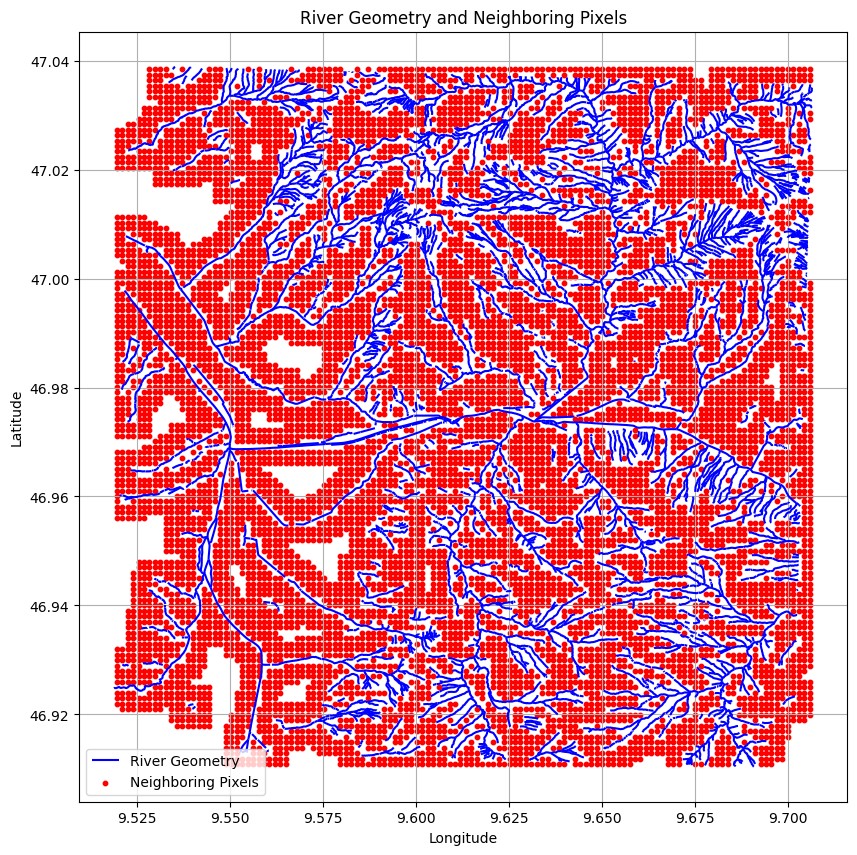


Adjacent Neighbors


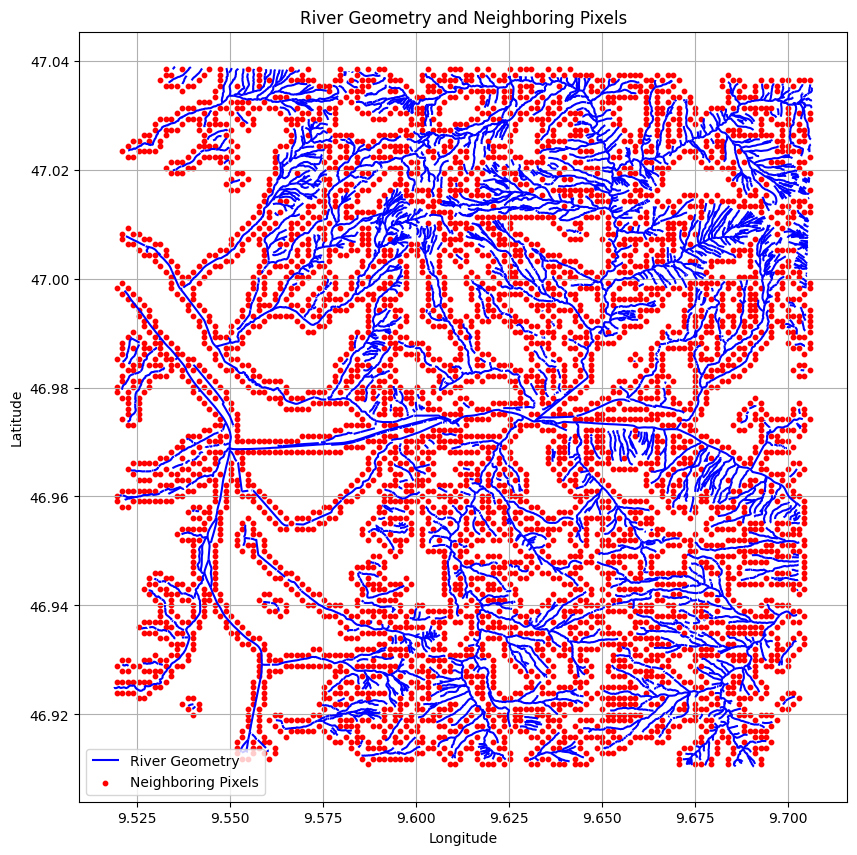

cell_59
Number of adjacent neighbors: 2462
neighbors


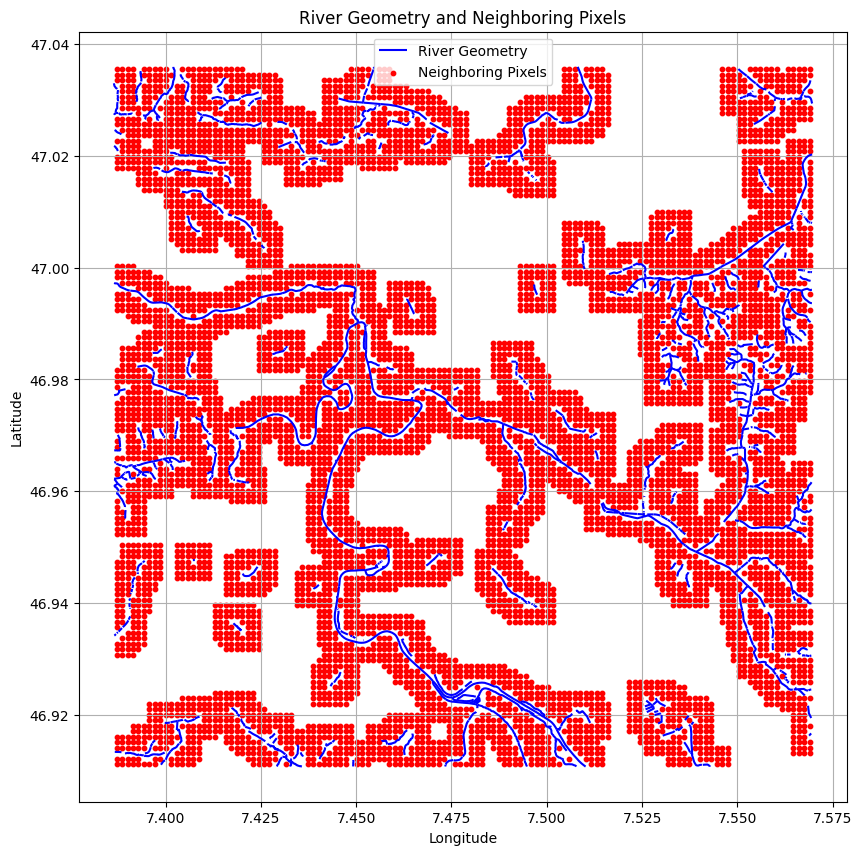


Adjacent Neighbors


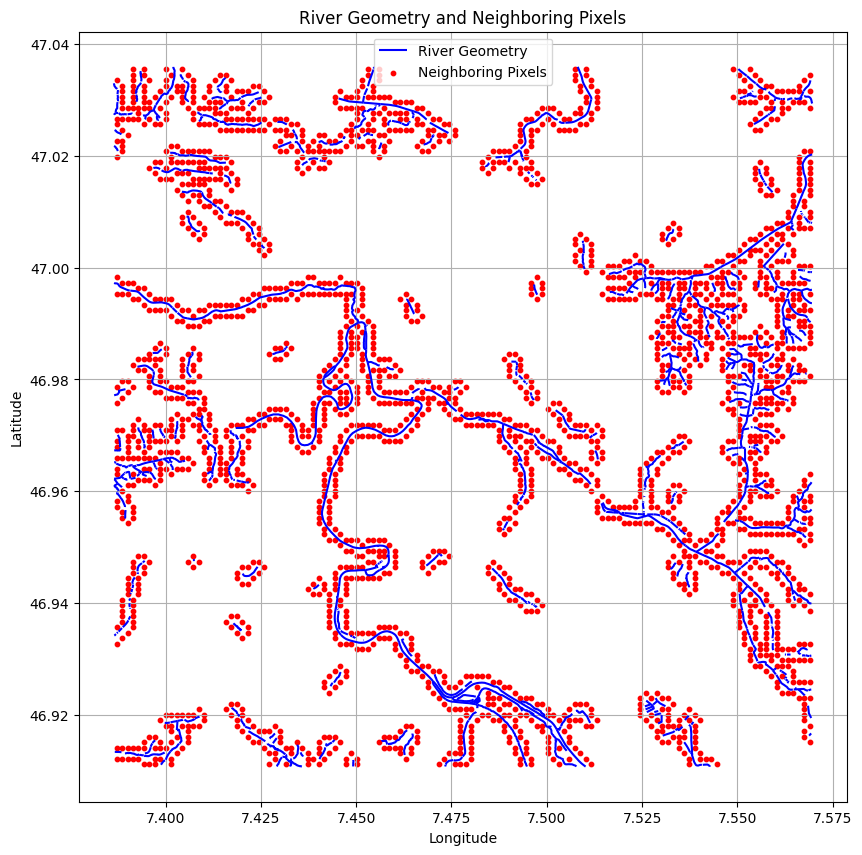

cell_63
Number of adjacent neighbors: 2019
cell_11
Number of adjacent neighbors: 2490
cell_36
Number of adjacent neighbors: 6119
cell_65
Number of adjacent neighbors: 4508
cell_56
Number of adjacent neighbors: 2057
cell_12
Number of adjacent neighbors: 3876
cell_72
Number of adjacent neighbors: 1949
cell_24
Number of adjacent neighbors: 5472
cell_38
Number of adjacent neighbors: 2588
cell_80
Number of adjacent neighbors: 2952
cell_25
Number of adjacent neighbors: 4384
cell_21
Number of adjacent neighbors: 3014
cell_68
Number of adjacent neighbors: 4361
cell_32
Number of adjacent neighbors: 3736
cell_10
Number of adjacent neighbors: 3059
cell_61
Number of adjacent neighbors: 4193
cell_17
Number of adjacent neighbors: 2741
cell_14
Number of adjacent neighbors: 2777
cell_18
Number of adjacent neighbors: 2145
cell_1
Number of adjacent neighbors: 3190
cell_71
Number of adjacent neighbors: 3412
cell_45
Number of adjacent neighbors: 4479
cell_23
Number of adjacent neighbors: 4115
cell_28
Numb

KeyboardInterrupt: 

In [39]:
river_inds = {}
adj_neighbors = {}
c=0
for cell, riv in river_cells.items():
    print(cell)
    cell_gdf = riv
    x_min, y_min, x_max, y_max = cell_gdf.total_bounds
    target_width, target_height = 128, 128
    transform = from_bounds(x_min, y_min, x_max, y_max, target_width, target_height)
    
    array = rasterize(
    [(geom, 1) for geom in cell_gdf.geometry],
    out_shape=(target_height, target_width),
    transform=transform,
    fill=0,  # Valor para áreas fuera de las geometrías
    dtype="float32"
    )
    river_indices = np.nonzero(array.reshape(-1))[0]
    buffer_size = 3
    height, width = array.shape

    rows, cols = np.unravel_index(river_indices, (height, width)) 

    neighbor_indices = set()
    for row, col in zip(rows, cols):
        for i in range(-buffer_size, buffer_size + 1):
            for j in range(-buffer_size, buffer_size + 1):
                neighbor_row, neighbor_col = row + i, col + j
                
                if 0 <= neighbor_row < height and 0 <= neighbor_col < width:
                    neighbor_index = np.ravel_multi_index((neighbor_row, neighbor_col), (height, width))
                    neighbor_indices.add(neighbor_index)
    
    neighbor_indices = list(neighbor_indices)

    neighbors_around_river = [idx for idx in neighbor_indices if idx not in river_indices]
    
    river_inds[cell] = neighbors_around_river
    
    # Adjacent neighbors
    height, width = array.shape
    
    # Convertir los índices del río (1D) a coordenadas (2D)
    river_rows, river_cols = np.unravel_index(river_indices, (height, width))
    
    # Inicializar un conjunto para guardar vecinos únicos
    adjacent_neighbors = set()
    
    # Direcciones posibles (adyacentes): arriba, abajo, izquierda, derecha
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1)]
    
    # Encontrar vecinos adyacentes
    for row, col in zip(river_rows, river_cols):
        for d_row, d_col in directions:
            neighbor_row, neighbor_col = row + d_row, col + d_col
            
            # Verificar que el vecino esté dentro de los límites del raster
            if 0 <= neighbor_row < height and 0 <= neighbor_col < width:
                # Convertir a índice 1D
                neighbor_index = np.ravel_multi_index((neighbor_row, neighbor_col), (height, width))
                
                # Asegurarse de que no es parte del río
                if neighbor_index not in river_indices:
                    adjacent_neighbors.add(neighbor_index)
    
    # Convertir el conjunto a una lista o array
    adjacent_neighbors = list(adjacent_neighbors)
    adj_neighbors[cell] = adjacent_neighbors
    
    print(f"Number of adjacent neighbors: {len(adjacent_neighbors)}")

    if c<10:
        print('neighbors')
        plot_neighbors(neighbors_around_river,cell_gdf, cell)
        print('\nAdjacent Neighbors')
        plot_neighbors(adjacent_neighbors,cell_gdf,cell)
        
    
    c+=1

In [51]:
from scipy.stats import pearsonr
import numpy as np
results = []

start=0
lst_images = {riv:[] for riv in imgs_per_river.keys()}
ndvi_images = {riv:[] for riv in imgs_per_river.keys()}
for i, (riv, num) in enumerate(imgs_per_river.items()):
    lst_means = []
    ndvi_means = []
    water_temps = []
    for n in range(num):
        neigh_mean = []
        image = total_data['lst'][start+n][:,:,0]
        neighbors = adj_neighbors[riv]
        neigh_values_lst = image.flatten()[neighbors]
        lst_mean = np.mean(neigh_values_lst)
        lst_images[riv].append(image)

        image = total_data['ndvi'][start+n]
        neighbors = adj_neighbors[riv]
        neigh_values_ndvi = image.flatten()[neighbors]
        ndvi_mean = np.mean(neigh_values_ndvi)
        ndvi_images[riv].append(image)
        
        water_temp_mean = all_ds['wt'][riv][n]
        print(lst_mean, water_temp_mean)

        lst_means.append(lst_mean)
        ndvi_means.append(ndvi_mean)
        water_temps.append(water_temp_mean)

    start += num
    
    corr_temp_ndvi, _ = pearsonr(lst_means, ndvi_means)
    corr_temp_water, _ = pearsonr(lst_means, water_temps)
    corr_ndvi_water, _ = pearsonr(ndvi_means, water_temps)
    results.append({
        'River': riv,
        'Correlation_LST_NDVI': corr_temp_ndvi,
        'Correlation_LST_WT': corr_temp_water,
        'Correlation_NDVI_WT': corr_ndvi_water
    })
    
results_df = pd.DataFrame(results)

200.22076711549863 12.22
197.7148892538888 5.91
179.16412355611612 10.48
149.01398562337016 11.84
136.03157024593145 7.41
10.515331603668548 11.78
109.26739468417325 12.02
100.16953099428953 7.56
161.39227546440375 12.43
171.91747556413924 5.73
39.487469620757054 5.24
183.3038883628426 10.74
189.28408566150037 6.34
70.53329113397953 12.63
44.99555454877748 1.44
108.96757306052706 14.46
70.70709723953196 2.44
89.97618720604038 12.43
55.60572789137366 4.0
31.10001136753981 0.86
8.942779300177918 10.91
146.40790999110413 1.57
21.641308428604145 3.8
126.71366158090825 8.56
22.280693664894834 5.02
149.52793958248927 1.32
38.24900602837426 2.79
80.39607102868253 9.45
30.171627892388237 9.76
153.93115912543402 1.28
165.39728450775146 12.98
71.16617245144315 4.21
116.4871941672431 2.05
79.767319255405 13.76
112.95090696546767 1.63
115.43175103929308 12.0
118.78035301632352 4.52
73.20801427629259 12.62
35.13749758402506 7.11
30.703818533155655 1.79
171.70310921139188 11.77
153.6343665652805 3.3

In [12]:
results_df.sort_values('Correlation_NDVI_WT')

,River,Correlation_LST_NDVI,Correlation_LST_WT,Correlation_NDVI_WT
30,cell_54,0.190878,-0.215145,-0.595082
39,cell_48,0.094613,-0.091416,-0.585363
53,cell_61,-0.420234,0.158978,-0.498267
25,cell_3,-0.092379,0.651407,-0.413395
38,cell_12,0.228180,-0.251489,-0.402150
...,...,...,...,...
54,cell_35,-0.016571,-0.321369,0.558674
59,cell_64,-0.390803,-0.641360,0.596780
73,cell_24,0.132865,0.330544,0.608696
49,cell_15,0.156868,-0.332535,0.789053


In [53]:
import pandas as pd

# Assuming results_df is already defined
df = results_df

# Find the top 5 rivers with the highest and lowest correlation for each column
results = {}
for col in ["Correlation_LST_NDVI", "Correlation_LST_WT", "Correlation_NDVI_WT"]:
    # Sort the DataFrame by the column to get top 5 and bottom 5
    top_5 = df.nlargest(5, col)[["River", col]]  # Top 5 highest correlations
    bottom_5 = df.nsmallest(5, col)[["River", col]]  # Top 5 lowest correlations

    results[col] = {
        "Top 5": top_5,
        "Bottom 5": bottom_5,
    }

# Find rivers with the highest overall absolute correlation
df["Overall_Abs_Correlation"] = df[["Correlation_LST_NDVI", "Correlation_LST_WT", "Correlation_NDVI_WT"]].abs().mean(axis=1)
overall_top_5 = df.nlargest(5, "Overall_Abs_Correlation")

# Display the results
print("Rivers with the highest and lowest correlation for each column:")
for col, res in results.items():
    print(f"\n{col}:")
    print("  Top 5 highest correlations:")
    print(res["Top 5"].to_string(index=False))
    print("  Top 5 lowest correlations:")
    print(res["Bottom 5"].to_string(index=False))

print("\nRivers with the highest overall absolute correlation:")
print(overall_top_5[["River", "Overall_Abs_Correlation"]].to_string(index=False))


Rivers with the highest and lowest correlation for each column:

Correlation_LST_NDVI:
  Top 5 highest correlations:
  River  Correlation_LST_NDVI
cell_19              0.526437
cell_49              0.513690
cell_36              0.470319
cell_34              0.450362
cell_73              0.437730
  Top 5 lowest correlations:
  River  Correlation_LST_NDVI
cell_75             -0.423222
cell_61             -0.420234
cell_59             -0.411126
cell_22             -0.393408
cell_64             -0.390803

Correlation_LST_WT:
  Top 5 highest correlations:
  River  Correlation_LST_WT
 cell_3            0.651407
cell_32            0.501094
cell_47            0.424971
cell_53            0.384918
cell_76            0.337375
  Top 5 lowest correlations:
  River  Correlation_LST_WT
cell_64           -0.641360
cell_59           -0.445611
 cell_8           -0.385949
cell_15           -0.332535
cell_35           -0.321369

Correlation_NDVI_WT:
  Top 5 highest correlations:
  River  Correlation_NDVI_

In [54]:
# Helper function to format a LaTeX table
def generate_latex_table(title, top_5, bottom_5, column_name):
    latex = f"""
\\begin{{table}}[h!]
\\centering
\\caption{{Top 5 highest and lowest correlations for {column_name}.}}
\\label{{tab:{column_name.lower().replace(" ", "_")}}}
\\begin{{tabular}}{{|c|c|}}
\\hline
\\textbf{{Top 5 Highest Correlations}} & \\textbf{{Top 5 Lowest Correlations}} \\\\
\\hline
"""
    for i in range(5):
        highest = f"{top_5.iloc[i]['River']} ({top_5.iloc[i][column_name]:.4f})"
        lowest = f"{bottom_5.iloc[i]['River']} ({bottom_5.iloc[i][column_name]:.4f})"
        latex += f"{highest} & {lowest} \\\\\n"
    latex += "\\hline\n\\end{tabular}\n\\end{table}\n"
    return latex

# Generate LaTeX tables for each column
latex_output = ""
for col, res in results.items():
    top_5 = res["Top 5"]
    bottom_5 = res["Bottom 5"]
    latex_output += generate_latex_table(f"Correlations for {col}", top_5, bottom_5, col)

# Table for overall absolute correlation
overall_latex = f"""
\\begin{{table}}[h!]
\\centering
\\caption{{Top 5 rivers with the highest overall absolute correlation.}}
\\label{{tab:overall_absolute_correlation}}
\\begin{{tabular}}{{|c|c|}}
\\hline
\\textbf{{River}} & \\textbf{{Overall Absolute Correlation}} \\\\
\\hline
"""
for i in range(5):
    row = overall_top_5.iloc[i]
    overall_latex += f"{row['River']} & {row['Overall_Abs_Correlation']:.4f} \\\\\n"
overall_latex += "\\hline\n\\end{tabular}\n\\end{table}\n"

# Combine all LaTeX tables
latex_output += overall_latex

# Print the LaTeX code
print(latex_output)



\begin{table}[h!]
\centering
\caption{Top 5 highest and lowest correlations for Correlation_LST_NDVI.}
\label{tab:correlation_lst_ndvi}
\begin{tabular}{|c|c|}
\hline
\textbf{Top 5 Highest Correlations} & \textbf{Top 5 Lowest Correlations} \\
\hline
cell_19 (0.5264) & cell_75 (-0.4232) \\
cell_49 (0.5137) & cell_61 (-0.4202) \\
cell_36 (0.4703) & cell_59 (-0.4111) \\
cell_34 (0.4504) & cell_22 (-0.3934) \\
cell_73 (0.4377) & cell_64 (-0.3908) \\
\hline
\end{tabular}
\end{table}

\begin{table}[h!]
\centering
\caption{Top 5 highest and lowest correlations for Correlation_LST_WT.}
\label{tab:correlation_lst_wt}
\begin{tabular}{|c|c|}
\hline
\textbf{Top 5 Highest Correlations} & \textbf{Top 5 Lowest Correlations} \\
\hline
cell_3 (0.6514) & cell_64 (-0.6414) \\
cell_32 (0.5011) & cell_59 (-0.4456) \\
cell_47 (0.4250) & cell_8 (-0.3859) \\
cell_53 (0.3849) & cell_15 (-0.3325) \\
cell_76 (0.3374) & cell_35 (-0.3214) \\
\hline
\end{tabular}
\end{table}

\begin{table}[h!]
\centering
\caption{T

In [55]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.patches import Circle
from matplotlib.colors import ListedColormap

def corr_plot(correlation_map, cell, river_masks, highlight="negative"):
    """
    Plot a heatmap of correlations with river overlay and highlight zones with top correlations.
    
    Args:
        correlation_map (np.ndarray): 2D array of correlation values.
        cell (str): Identifier of the river cell.
        river_masks (dict): Dictionary of river masks keyed by cell.
        highlight (str): Either "negative" or "positive" to highlight top correlations.
    """
    # Flatten the correlation map and sort indices
    flat_corr_map = correlation_map.flatten()
    if highlight == "negative":
        sorted_indices = np.argsort(flat_corr_map)  # Sort ascending (lowest first)
        top_indices = sorted_indices[:10]  # Top 10 negative correlations
    elif highlight == "positive":
        sorted_indices = np.argsort(flat_corr_map)[::-1]  # Sort descending (highest first)
        top_indices = sorted_indices[:10]  # Top 10 positive correlations
    else:
        raise ValueError("Invalid value for 'highlight'. Use 'negative' or 'positive'.")
    
    top_positions = np.column_stack(np.unravel_index(top_indices, correlation_map.shape))
    
    # Print correlation values for the selected positions
    print(f"Top 10 {'negative' if highlight == 'negative' else 'positive'} correlations and their positions:")
    for idx, (row, col) in enumerate(top_positions):
        corr_value = correlation_map[row, col]
        print(f"{idx + 1}: Position (Row {row}, Column {col}) - Correlation: {corr_value:.4f}")
    
    # Create a custom colormap for the river mask
    cmap = ListedColormap(['white', 'white'])  # Both colors are white
    river_raster = river_masks[cell]
    
    # Create an alpha mask: 1 for river, 0 for background
    alpha_mask = np.where(river_raster > 0.0, 1.0, 0.0)
    
    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    plt.imshow(correlation_map, cmap="viridis", interpolation="nearest")
    plt.colorbar(label="Correlation (Pearson)")
    
    # Overlay the river areas in white using the alpha mask
    plt.imshow(river_raster, cmap=cmap, alpha=alpha_mask)
    
    # Highlight the selected correlation positions with red circles
    ax = plt.gca()
    for pos in top_positions:
        row, col = pos
        circle = Circle((col, row), radius=3, color='red', fill=False, linewidth=2)
        ax.add_patch(circle)
    
    # Configure the plot
    print(f'\n Cell {cell}')
    plt.title(f"Correlation Heatmap with River Overlay and Top {highlight.capitalize()} Correlations Highlighted")
    plt.xlabel("Raster Columns")
    plt.ylabel("Raster Rows")
    plt.show()


In [60]:
def corr_plot(correlation_map, cell, river_masks, highlight="negative", positions=None):
    """
    Plot a heatmap of correlations with river overlay and highlight zones with top correlations.

    Args:
        correlation_map (np.ndarray): 2D array of correlation values.
        cell (str): Identifier of the river cell.
        river_masks (dict): Dictionary of river masks keyed by cell.
        highlight (str): Either "negative" or "positive" to highlight top correlations.
        positions (list of int): Specific 1D indices (from a flattened map) to consider.
    """
    # Restrict computation to the specified positions, if provided
    if positions is not None:
        # Extract correlation values at the given positions
        values = np.array([correlation_map.flatten()[idx] for idx in positions])
    else:
        # Use the entire flattened correlation map
        values = correlation_map.flatten()
        positions = np.arange(values.size)  # All positions

    # Sort the correlation values based on the highlight type
    if highlight == "negative":
        sorted_indices = np.argsort(values)  # Sort ascending (lowest first)
    elif highlight == "positive":
        sorted_indices = np.argsort(values)[::-1]  # Sort descending (highest first)
    else:
        raise ValueError("Invalid value for 'highlight'. Use 'negative' or 'positive'.")

    # Select the top positions based on the sorted values
    top_indices = sorted_indices[:10]
    top_positions = [positions[idx] for idx in top_indices]
    top_coordinates = np.column_stack(np.unravel_index(top_positions, correlation_map.shape))

    # Print correlation values for the selected positions
    print(f"Top 10 {'negative' if highlight == 'negative' else 'positive'} correlations and their positions:")
    for idx, (row, col) in enumerate(top_coordinates):
        corr_value = correlation_map[row, col]
        print(f"{idx + 1}: Position (Row {row}, Column {col}) - Correlation: {corr_value:.4f}")

    # Create a custom colormap for the river mask
    cmap = ListedColormap(['white', 'white'])  # Both colors are white
    river_raster = river_masks[cell]

    # Create an alpha mask: 1 for river, 0 for background
    alpha_mask = np.where(river_raster > 0.0, 1.0, 0.0)

    # Plot the heatmap
    plt.figure(figsize=(10, 8))
    plt.imshow(correlation_map, cmap="viridis", interpolation="nearest")
    plt.colorbar(label="Correlation (Pearson)")

    # Overlay the river areas in white using the alpha mask
    plt.imshow(river_raster, cmap=cmap, alpha=alpha_mask)

    # Highlight the selected correlation positions with red circles
    ax = plt.gca()
    for row, col in top_coordinates:
        circle = Circle((col, row), radius=3, color='red', fill=False, linewidth=2)
        ax.add_patch(circle)

    # Configure the plot
    print(f'\n Cell {cell}')
    plt.title(f"Correlation Heatmap with River Overlay and Top {highlight.capitalize()} Correlations Highlighted")
    plt.xlabel("Raster Columns")
    plt.ylabel("Raster Rows")
    plt.show()


River                       cell_54
Correlation_LST_NDVI       0.190878
Correlation_LST_WT        -0.215145
Correlation_NDVI_WT       -0.595082
Overall_Abs_Correlation    0.333702
Name: 30, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 57, Column 1) - Correlation: -0.7218
2: Position (Row 71, Column 19) - Correlation: -0.7160
3: Position (Row 4, Column 32) - Correlation: -0.7092
4: Position (Row 88, Column 94) - Correlation: -0.7072
5: Position (Row 120, Column 81) - Correlation: -0.7028
6: Position (Row 67, Column 18) - Correlation: -0.7014
7: Position (Row 67, Column 20) - Correlation: -0.6981
8: Position (Row 41, Column 77) - Correlation: -0.6956
9: Position (Row 74, Column 108) - Correlation: -0.6953
10: Position (Row 32, Column 26) - Correlation: -0.6947

 Cell cell_54


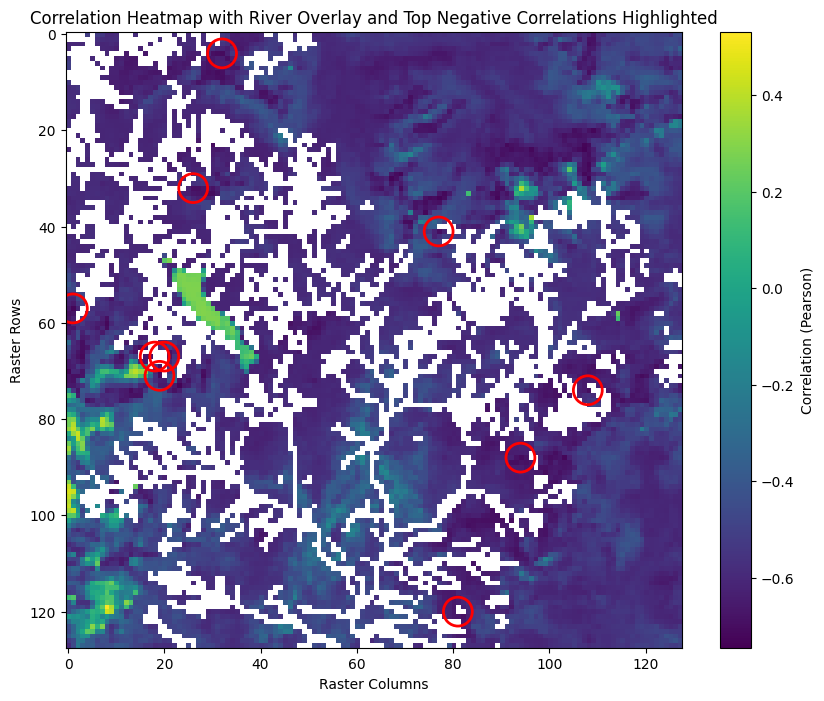

River                       cell_48
Correlation_LST_NDVI       0.094613
Correlation_LST_WT        -0.091416
Correlation_NDVI_WT       -0.585363
Overall_Abs_Correlation    0.257131
Name: 39, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 48, Column 127) - Correlation: -0.7977
2: Position (Row 69, Column 120) - Correlation: -0.7922
3: Position (Row 87, Column 102) - Correlation: -0.7824
4: Position (Row 64, Column 123) - Correlation: -0.7804
5: Position (Row 18, Column 124) - Correlation: -0.7776
6: Position (Row 71, Column 120) - Correlation: -0.7757
7: Position (Row 63, Column 125) - Correlation: -0.7751
8: Position (Row 78, Column 112) - Correlation: -0.7732
9: Position (Row 66, Column 120) - Correlation: -0.7704
10: Position (Row 64, Column 124) - Correlation: -0.7695

 Cell cell_48


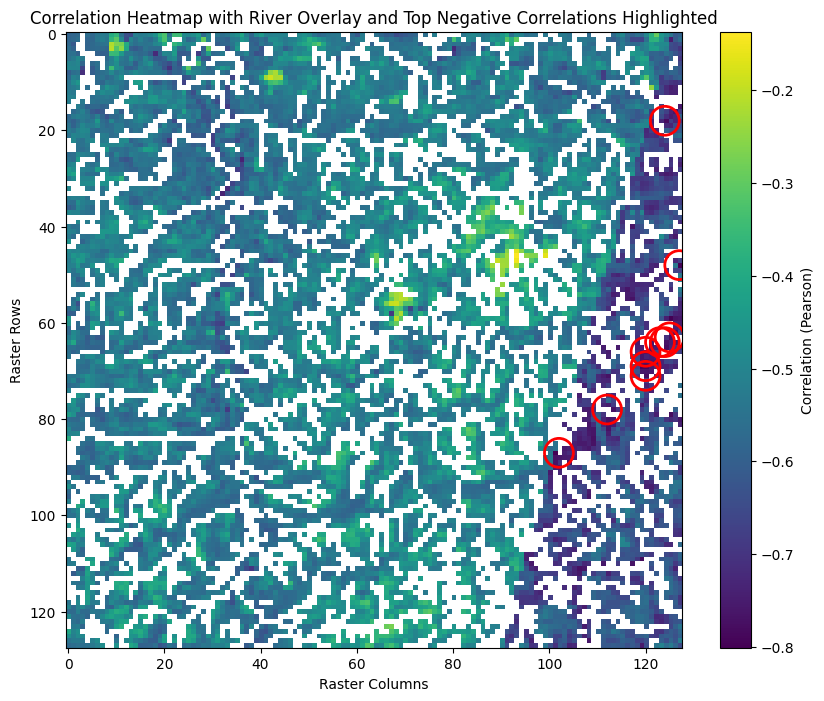

River                       cell_61
Correlation_LST_NDVI      -0.420234
Correlation_LST_WT         0.158978
Correlation_NDVI_WT       -0.498267
Overall_Abs_Correlation     0.35916
Name: 53, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 4, Column 16) - Correlation: -0.7983
2: Position (Row 37, Column 31) - Correlation: -0.7773
3: Position (Row 50, Column 62) - Correlation: -0.7544
4: Position (Row 101, Column 47) - Correlation: -0.7483
5: Position (Row 60, Column 61) - Correlation: -0.7394
6: Position (Row 100, Column 49) - Correlation: -0.7359
7: Position (Row 102, Column 47) - Correlation: -0.7277
8: Position (Row 61, Column 62) - Correlation: -0.7243
9: Position (Row 69, Column 39) - Correlation: -0.7147
10: Position (Row 67, Column 95) - Correlation: -0.7125

 Cell cell_61


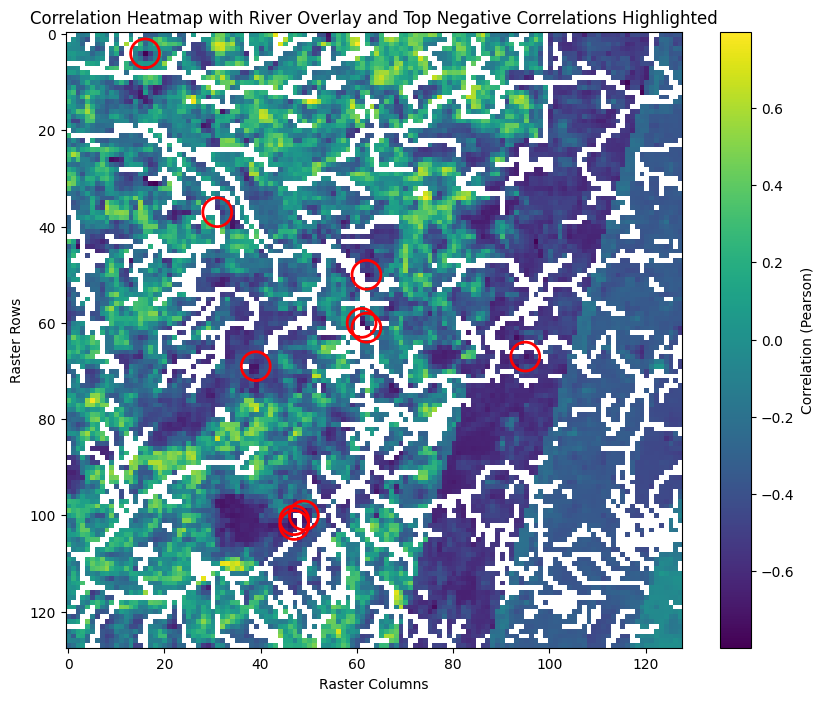

River                        cell_3
Correlation_LST_NDVI      -0.092379
Correlation_LST_WT         0.651407
Correlation_NDVI_WT       -0.413395
Overall_Abs_Correlation    0.385727
Name: 25, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 42, Column 44) - Correlation: -0.8841
2: Position (Row 107, Column 95) - Correlation: -0.8719
3: Position (Row 8, Column 28) - Correlation: -0.8619
4: Position (Row 28, Column 64) - Correlation: -0.8565
5: Position (Row 91, Column 104) - Correlation: -0.8455
6: Position (Row 19, Column 80) - Correlation: -0.8438
7: Position (Row 53, Column 18) - Correlation: -0.8391
8: Position (Row 50, Column 35) - Correlation: -0.8358
9: Position (Row 22, Column 87) - Correlation: -0.8329
10: Position (Row 18, Column 111) - Correlation: -0.8320

 Cell cell_3


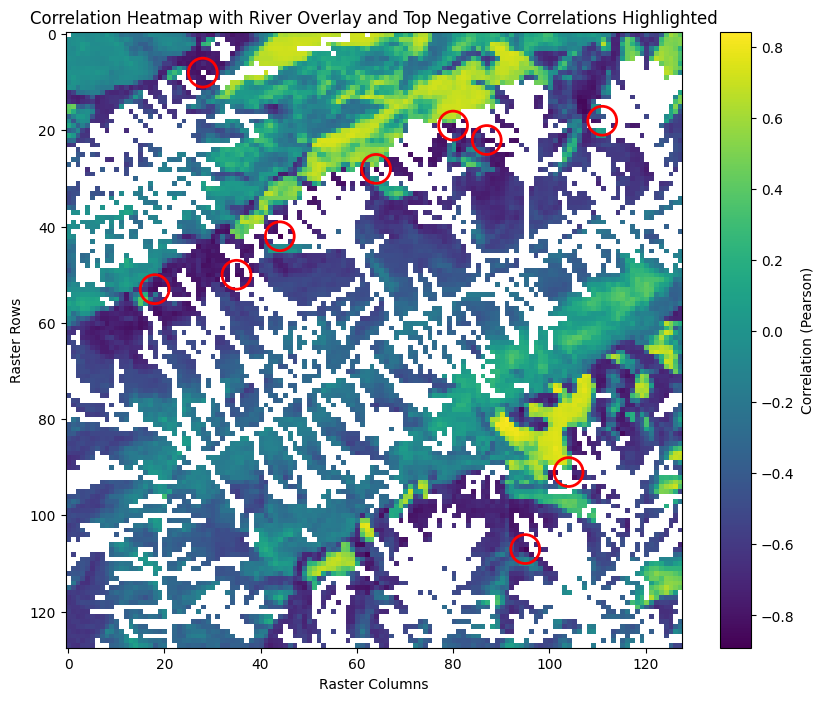

River                       cell_12
Correlation_LST_NDVI        0.22818
Correlation_LST_WT        -0.251489
Correlation_NDVI_WT        -0.40215
Overall_Abs_Correlation     0.29394
Name: 38, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 124, Column 3) - Correlation: -0.7142
2: Position (Row 125, Column 3) - Correlation: -0.7106
3: Position (Row 126, Column 2) - Correlation: -0.7098
4: Position (Row 125, Column 1) - Correlation: -0.7069
5: Position (Row 124, Column 1) - Correlation: -0.7016
6: Position (Row 123, Column 3) - Correlation: -0.6993
7: Position (Row 119, Column 35) - Correlation: -0.6928
8: Position (Row 123, Column 1) - Correlation: -0.6844
9: Position (Row 113, Column 61) - Correlation: -0.6831
10: Position (Row 126, Column 0) - Correlation: -0.6824

 Cell cell_12


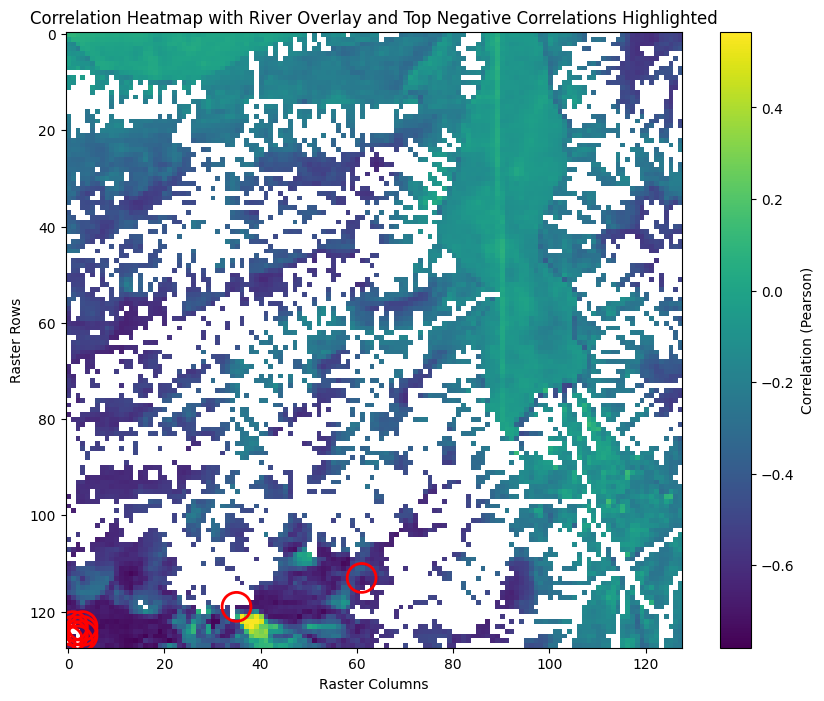

River                       cell_22
Correlation_LST_NDVI      -0.393408
Correlation_LST_WT        -0.094208
Correlation_NDVI_WT       -0.364551
Overall_Abs_Correlation    0.284055
Name: 33, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 92, Column 13) - Correlation: -0.7229
2: Position (Row 90, Column 10) - Correlation: -0.7196
3: Position (Row 92, Column 14) - Correlation: -0.6985
4: Position (Row 106, Column 43) - Correlation: -0.6931
5: Position (Row 124, Column 12) - Correlation: -0.6633
6: Position (Row 31, Column 35) - Correlation: -0.6551
7: Position (Row 90, Column 93) - Correlation: -0.6490
8: Position (Row 101, Column 68) - Correlation: -0.6061
9: Position (Row 99, Column 67) - Correlation: -0.6021
10: Position (Row 81, Column 59) - Correlation: -0.5841

 Cell cell_22


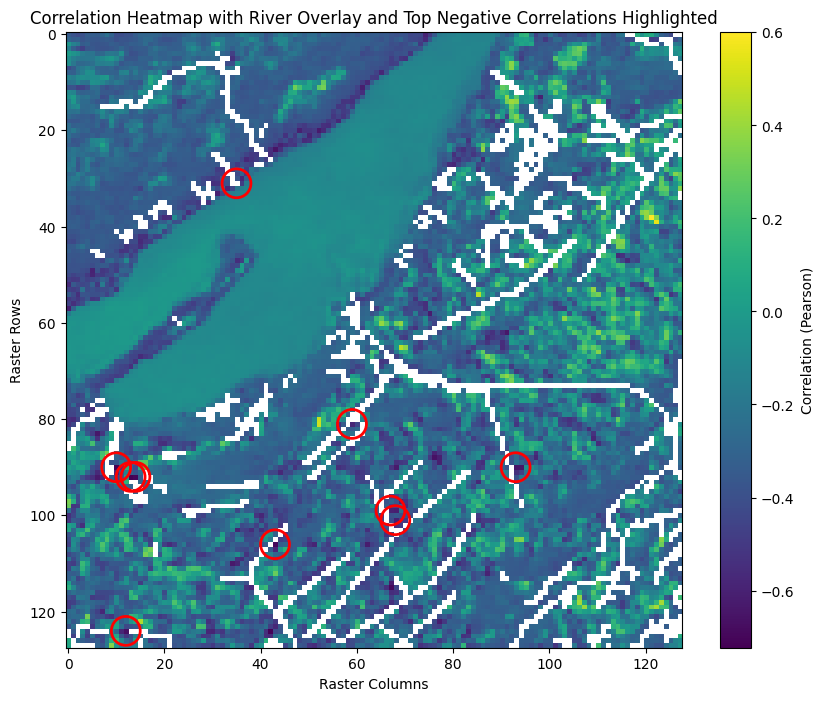

River                       cell_52
Correlation_LST_NDVI       0.115038
Correlation_LST_WT         0.021116
Correlation_NDVI_WT       -0.357032
Overall_Abs_Correlation    0.164395
Name: 50, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 121, Column 37) - Correlation: -0.5213
2: Position (Row 127, Column 35) - Correlation: -0.5105
3: Position (Row 116, Column 33) - Correlation: -0.5101
4: Position (Row 1, Column 65) - Correlation: -0.5100
5: Position (Row 1, Column 64) - Correlation: -0.5003
6: Position (Row 126, Column 0) - Correlation: -0.4979
7: Position (Row 57, Column 107) - Correlation: -0.4959
8: Position (Row 66, Column 34) - Correlation: -0.4917
9: Position (Row 120, Column 38) - Correlation: -0.4914
10: Position (Row 119, Column 3) - Correlation: -0.4914

 Cell cell_52


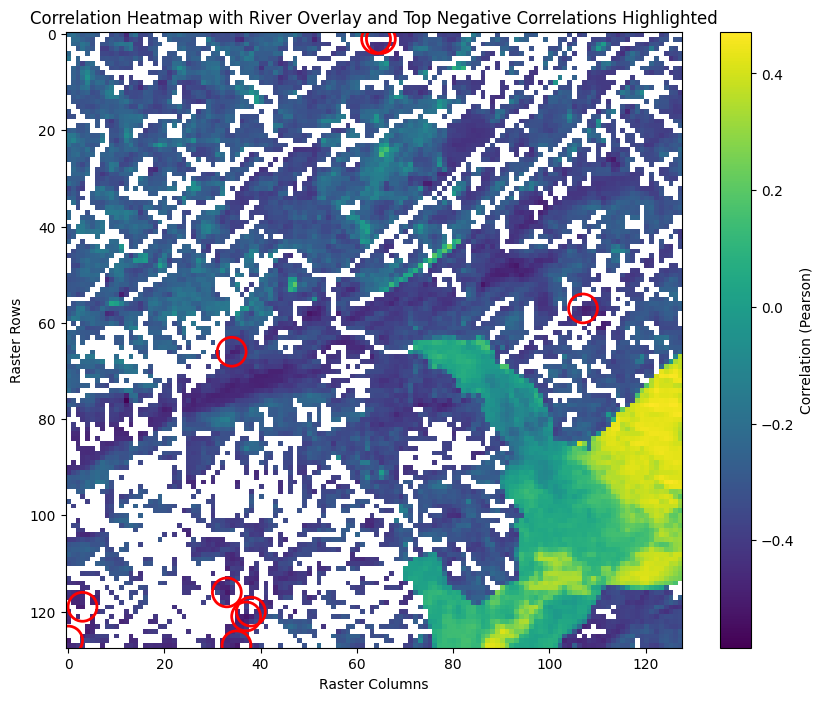

River                       cell_62
Correlation_LST_NDVI       -0.14315
Correlation_LST_WT         0.218093
Correlation_NDVI_WT       -0.335737
Overall_Abs_Correlation    0.232327
Name: 17, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 86, Column 57) - Correlation: -0.7937
2: Position (Row 87, Column 57) - Correlation: -0.7753
3: Position (Row 20, Column 45) - Correlation: -0.7544
4: Position (Row 93, Column 57) - Correlation: -0.7359
5: Position (Row 89, Column 57) - Correlation: -0.7081
6: Position (Row 88, Column 57) - Correlation: -0.7079
7: Position (Row 85, Column 57) - Correlation: -0.6865
8: Position (Row 71, Column 61) - Correlation: -0.6849
9: Position (Row 74, Column 61) - Correlation: -0.6761
10: Position (Row 69, Column 62) - Correlation: -0.6740

 Cell cell_62


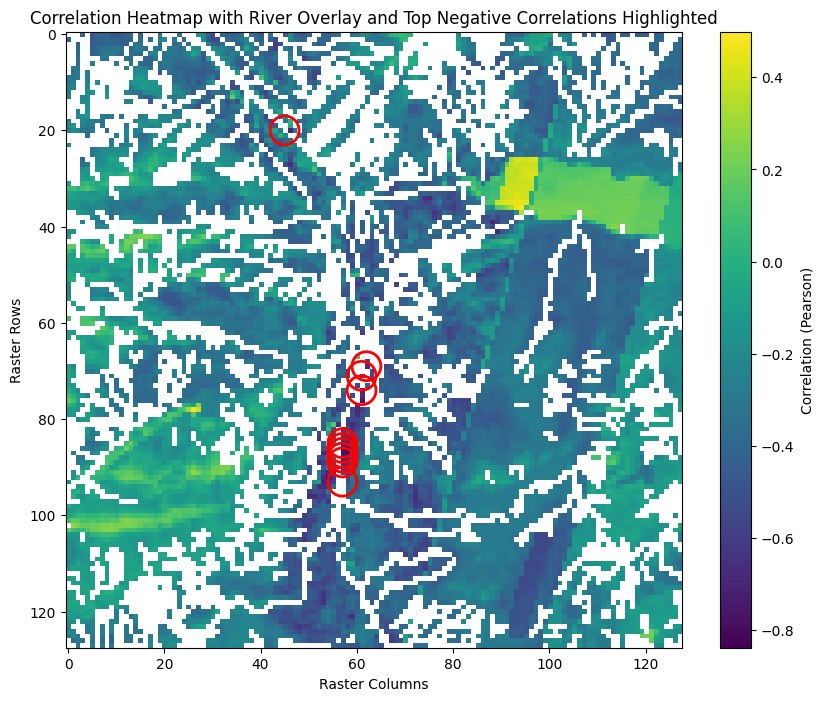

River                       cell_49
Correlation_LST_NDVI        0.51369
Correlation_LST_WT        -0.133749
Correlation_NDVI_WT       -0.326319
Overall_Abs_Correlation    0.324586
Name: 6, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 15, Column 109) - Correlation: -0.7153
2: Position (Row 16, Column 109) - Correlation: -0.7048
3: Position (Row 13, Column 110) - Correlation: -0.6801
4: Position (Row 14, Column 110) - Correlation: -0.6364
5: Position (Row 15, Column 110) - Correlation: -0.6237
6: Position (Row 17, Column 109) - Correlation: -0.5997
7: Position (Row 31, Column 119) - Correlation: -0.5337
8: Position (Row 15, Column 112) - Correlation: -0.5313
9: Position (Row 95, Column 122) - Correlation: -0.5198
10: Position (Row 16, Column 112) - Correlation: -0.5184

 Cell cell_49


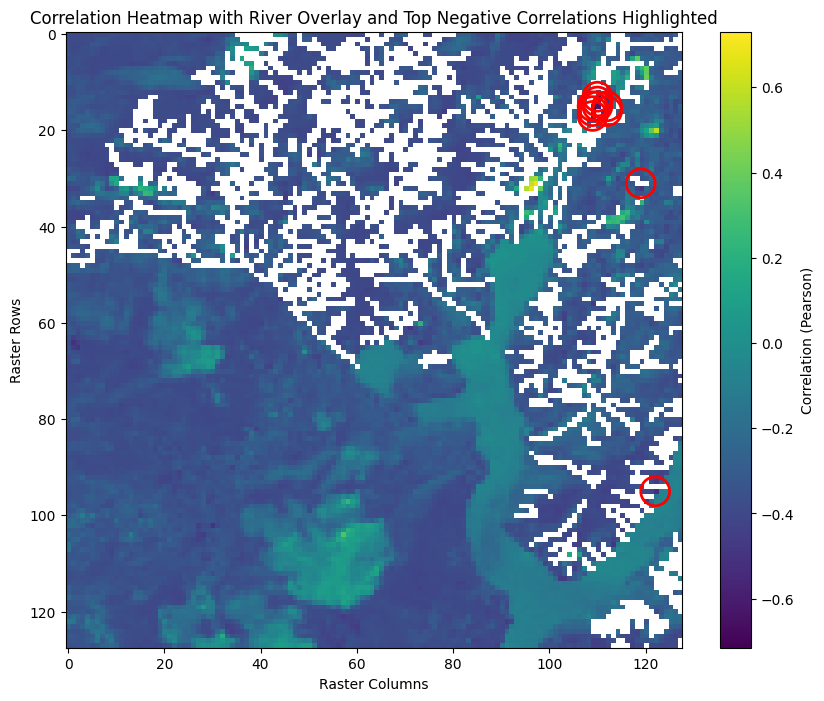

River                       cell_13
Correlation_LST_NDVI      -0.095661
Correlation_LST_WT        -0.190066
Correlation_NDVI_WT       -0.282723
Overall_Abs_Correlation    0.189484
Name: 9, dtype: object
Top 10 negative correlations and their positions:
1: Position (Row 22, Column 122) - Correlation: -0.5800
2: Position (Row 19, Column 113) - Correlation: -0.5791
3: Position (Row 40, Column 124) - Correlation: -0.5787
4: Position (Row 69, Column 32) - Correlation: -0.5727
5: Position (Row 40, Column 122) - Correlation: -0.5695
6: Position (Row 66, Column 59) - Correlation: -0.5668
7: Position (Row 21, Column 118) - Correlation: -0.5649
8: Position (Row 55, Column 67) - Correlation: -0.5575
9: Position (Row 60, Column 18) - Correlation: -0.5571
10: Position (Row 69, Column 33) - Correlation: -0.5540

 Cell cell_13


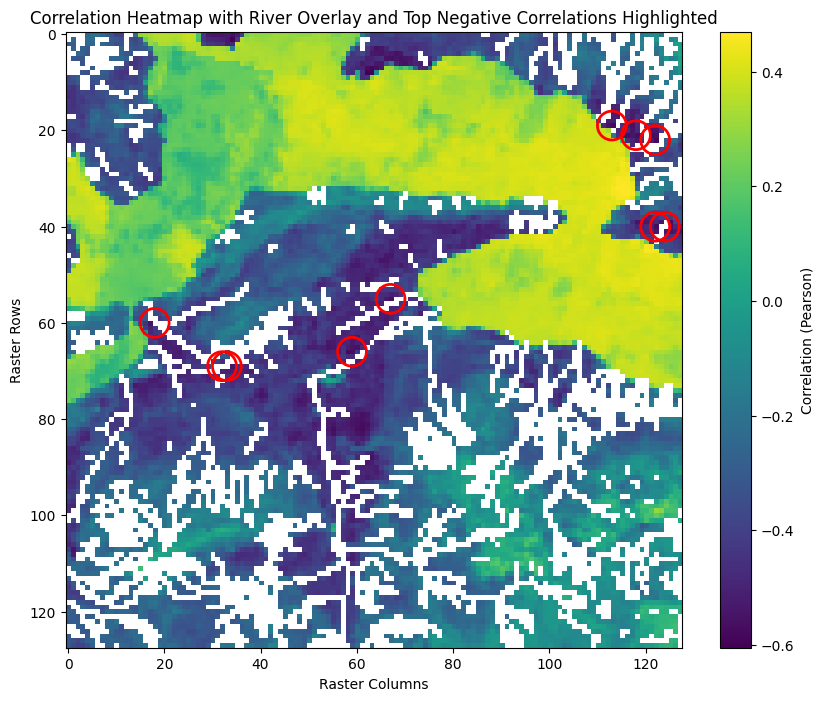

In [61]:
height, width = 128, 128
for i,row in results_df.sort_values('Correlation_NDVI_WT').iloc[:10].iterrows():
    print(row)
    riv = row.River
    num = imgs_per_river[riv]
    time_series_values = np.zeros((height, width, num))
    water_temp_rasters = []
    
    for n in range(num):
        image = lst_images[riv][n]
        lst_values.append(neigh_values_lst)
    
        image = ndvi_images[riv][n]
        time_series_values[:, :, n] = image
        
        water_temp = all_ds['wt'][riv][n]
        raster_water = np.full((height, width), water_temp)
        water_temp_rasters.append(raster_water)
        
    correlation_map = np.full((height, width), np.nan)
    water_temp_rasters = np.array(water_temp_rasters)

    for row in range(height):
        for col in range(width):
            pixel_series_lst = time_series_values[row, col, :]
            pixel_series_water = water_temp_rasters[:, row, col]
            
            if np.count_nonzero(pixel_series_lst) > 1:
                correlation, _ = pearsonr(pixel_series_lst, pixel_series_water)
                correlation_map[row, col] = correlation
                
    corr_plot(correlation_map, riv, river_masks, 'negative', adj_neighbors[riv])
    



River                       cell_60
Correlation_LST_NDVI      -0.050951
Correlation_LST_WT        -0.018514
Correlation_NDVI_WT        0.991933
Overall_Abs_Correlation      0.3538
Name: 48, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 95, Column 69) - Correlation: 0.9997
2: Position (Row 40, Column 35) - Correlation: 0.9997
3: Position (Row 66, Column 65) - Correlation: 0.9996
4: Position (Row 95, Column 67) - Correlation: 0.9995
5: Position (Row 112, Column 40) - Correlation: 0.9994
6: Position (Row 109, Column 44) - Correlation: 0.9994
7: Position (Row 48, Column 29) - Correlation: 0.9992
8: Position (Row 46, Column 50) - Correlation: 0.9991
9: Position (Row 122, Column 22) - Correlation: 0.9991
10: Position (Row 51, Column 70) - Correlation: 0.9991

 Cell cell_60


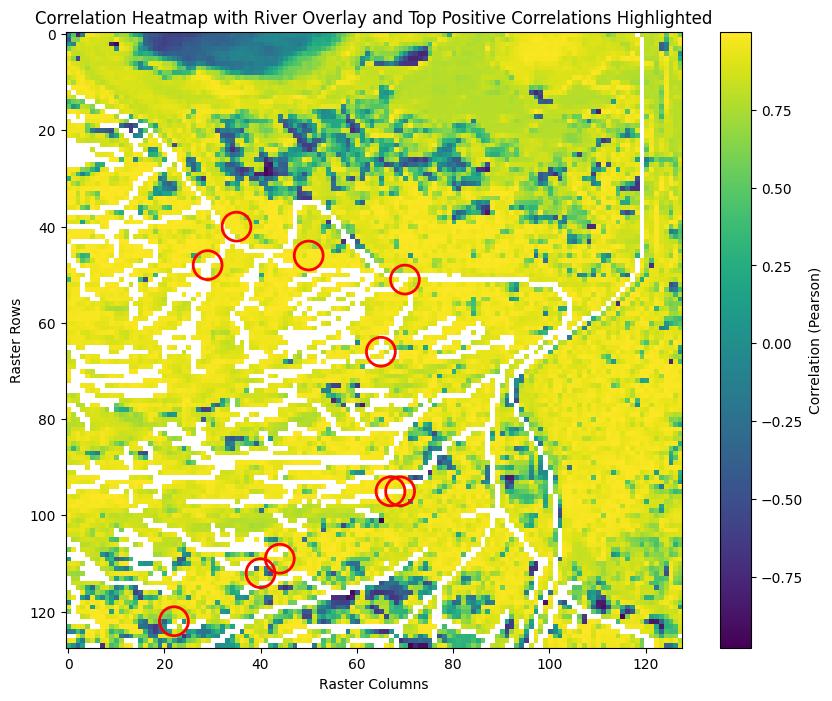

River                       cell_15
Correlation_LST_NDVI       0.156868
Correlation_LST_WT        -0.332535
Correlation_NDVI_WT        0.789053
Overall_Abs_Correlation    0.426152
Name: 49, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 127, Column 106) - Correlation: 0.9550
2: Position (Row 98, Column 74) - Correlation: 0.9369
3: Position (Row 68, Column 113) - Correlation: 0.9282
4: Position (Row 25, Column 89) - Correlation: 0.9251
5: Position (Row 91, Column 74) - Correlation: 0.9229
6: Position (Row 91, Column 45) - Correlation: 0.9169
7: Position (Row 89, Column 93) - Correlation: 0.9159
8: Position (Row 18, Column 91) - Correlation: 0.9148
9: Position (Row 18, Column 89) - Correlation: 0.9128
10: Position (Row 49, Column 97) - Correlation: 0.9085

 Cell cell_15


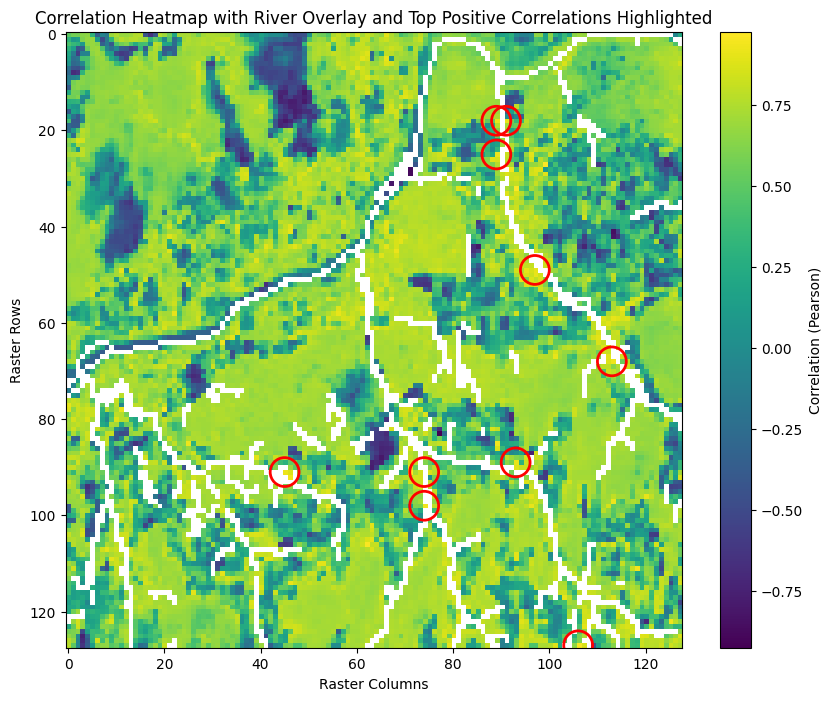

River                       cell_24
Correlation_LST_NDVI       0.132865
Correlation_LST_WT         0.330544
Correlation_NDVI_WT        0.608696
Overall_Abs_Correlation    0.357368
Name: 73, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 87, Column 60) - Correlation: 0.7830
2: Position (Row 30, Column 67) - Correlation: 0.7627
3: Position (Row 87, Column 61) - Correlation: 0.7560
4: Position (Row 32, Column 74) - Correlation: 0.7486
5: Position (Row 13, Column 94) - Correlation: 0.7391
6: Position (Row 26, Column 83) - Correlation: 0.7385
7: Position (Row 126, Column 59) - Correlation: 0.7376
8: Position (Row 126, Column 58) - Correlation: 0.7369
9: Position (Row 53, Column 5) - Correlation: 0.7308
10: Position (Row 46, Column 25) - Correlation: 0.7288

 Cell cell_24


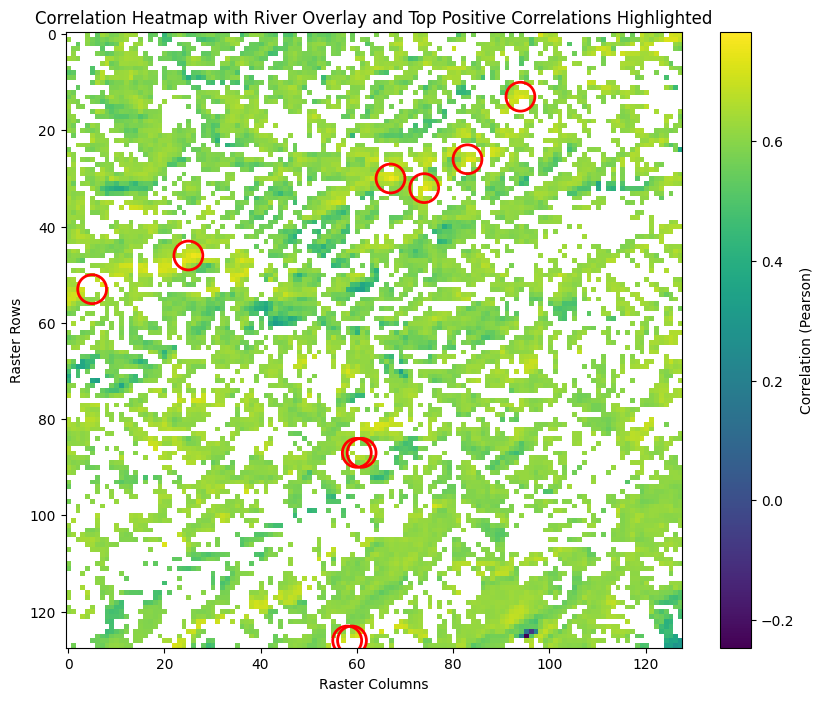

River                       cell_64
Correlation_LST_NDVI      -0.390803
Correlation_LST_WT         -0.64136
Correlation_NDVI_WT         0.59678
Overall_Abs_Correlation    0.542981
Name: 59, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 46, Column 113) - Correlation: 0.9014
2: Position (Row 64, Column 123) - Correlation: 0.8776
3: Position (Row 73, Column 73) - Correlation: 0.8424
4: Position (Row 63, Column 121) - Correlation: 0.8146
5: Position (Row 8, Column 98) - Correlation: 0.8120
6: Position (Row 63, Column 122) - Correlation: 0.8107
7: Position (Row 96, Column 42) - Correlation: 0.7996
8: Position (Row 58, Column 97) - Correlation: 0.7995
9: Position (Row 65, Column 124) - Correlation: 0.7973
10: Position (Row 58, Column 72) - Correlation: 0.7957

 Cell cell_64


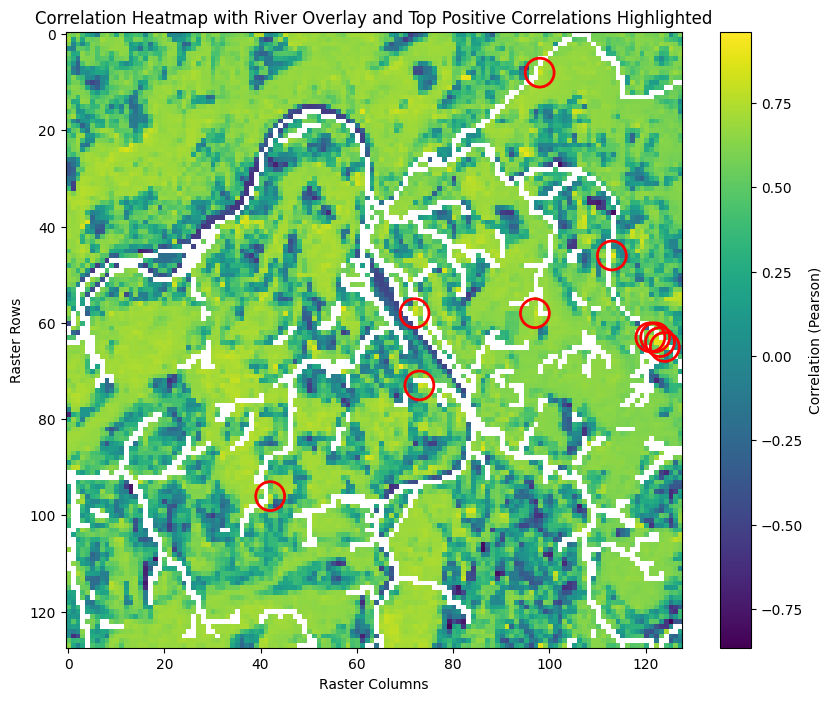

River                       cell_35
Correlation_LST_NDVI      -0.016571
Correlation_LST_WT        -0.321369
Correlation_NDVI_WT        0.558674
Overall_Abs_Correlation    0.298871
Name: 54, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 55, Column 48) - Correlation: 0.7904
2: Position (Row 69, Column 68) - Correlation: 0.7844
3: Position (Row 59, Column 63) - Correlation: 0.7825
4: Position (Row 59, Column 62) - Correlation: 0.7650
5: Position (Row 62, Column 83) - Correlation: 0.7588
6: Position (Row 51, Column 41) - Correlation: 0.7463
7: Position (Row 69, Column 66) - Correlation: 0.7429
8: Position (Row 55, Column 104) - Correlation: 0.7417
9: Position (Row 59, Column 49) - Correlation: 0.7393
10: Position (Row 51, Column 38) - Correlation: 0.7333

 Cell cell_35


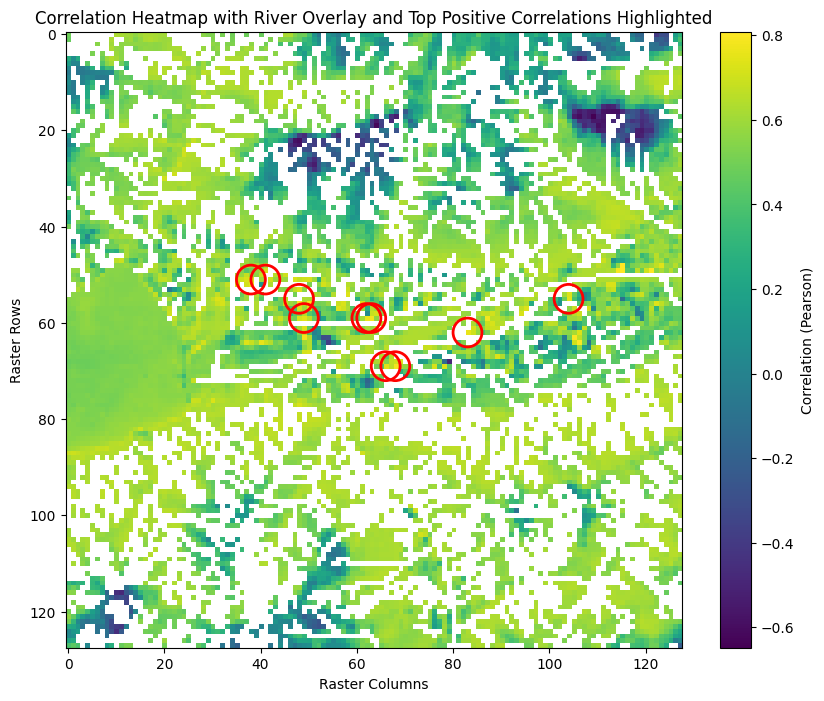

River                       cell_36
Correlation_LST_NDVI       0.470319
Correlation_LST_WT        -0.064669
Correlation_NDVI_WT        0.484462
Overall_Abs_Correlation    0.339817
Name: 68, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 100, Column 111) - Correlation: 0.9773
2: Position (Row 90, Column 58) - Correlation: 0.9750
3: Position (Row 89, Column 71) - Correlation: 0.9723
4: Position (Row 69, Column 83) - Correlation: 0.9713
5: Position (Row 62, Column 93) - Correlation: 0.9691
6: Position (Row 50, Column 88) - Correlation: 0.9686
7: Position (Row 55, Column 58) - Correlation: 0.9686
8: Position (Row 30, Column 68) - Correlation: 0.9678
9: Position (Row 40, Column 82) - Correlation: 0.9666
10: Position (Row 61, Column 93) - Correlation: 0.9631

 Cell cell_36


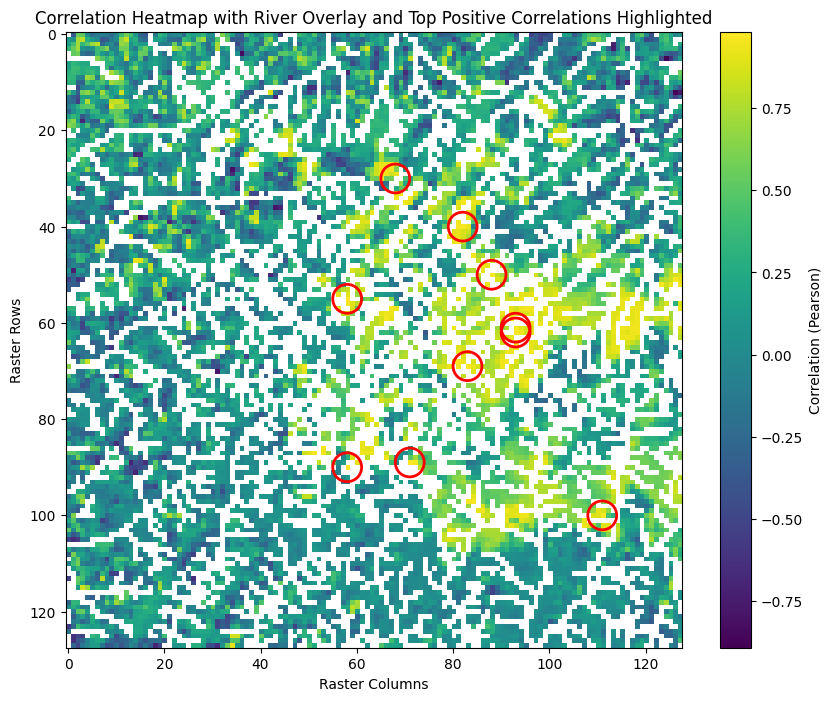

River                        cell_5
Correlation_LST_NDVI       0.280913
Correlation_LST_WT          0.12021
Correlation_NDVI_WT        0.462762
Overall_Abs_Correlation    0.287962
Name: 61, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 10, Column 85) - Correlation: 0.8583
2: Position (Row 79, Column 58) - Correlation: 0.8282
3: Position (Row 115, Column 72) - Correlation: 0.7879
4: Position (Row 25, Column 120) - Correlation: 0.7866
5: Position (Row 4, Column 90) - Correlation: 0.7778
6: Position (Row 86, Column 48) - Correlation: 0.7760
7: Position (Row 43, Column 56) - Correlation: 0.7739
8: Position (Row 83, Column 87) - Correlation: 0.7620
9: Position (Row 12, Column 110) - Correlation: 0.7611
10: Position (Row 51, Column 64) - Correlation: 0.7602

 Cell cell_5


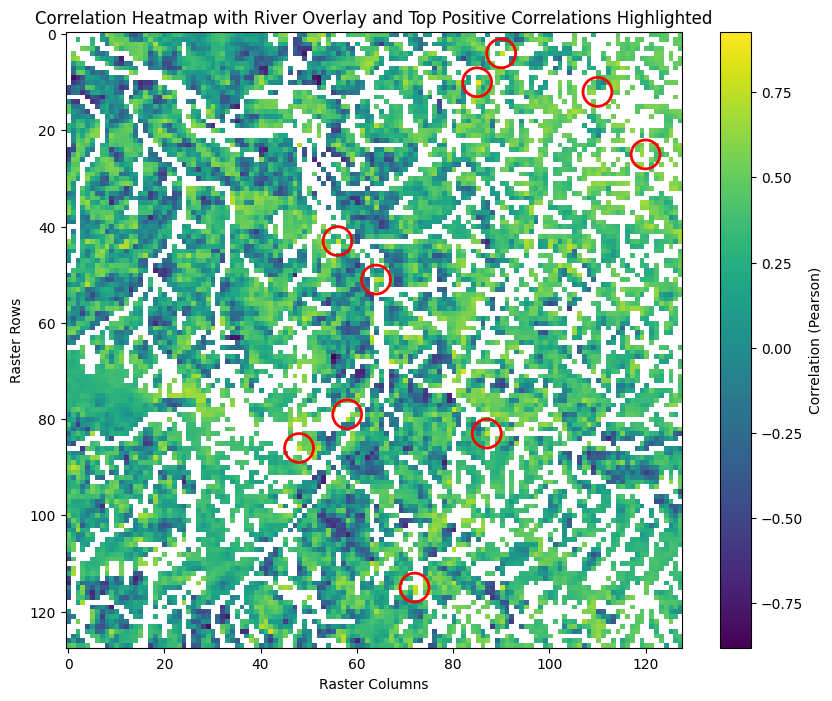

River                        cell_9
Correlation_LST_NDVI       0.265156
Correlation_LST_WT        -0.268209
Correlation_NDVI_WT        0.458275
Overall_Abs_Correlation    0.330547
Name: 22, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 24, Column 75) - Correlation: 0.6778
2: Position (Row 1, Column 62) - Correlation: 0.6751
3: Position (Row 24, Column 74) - Correlation: 0.6494
4: Position (Row 19, Column 19) - Correlation: 0.6463
5: Position (Row 24, Column 121) - Correlation: 0.6244
6: Position (Row 58, Column 87) - Correlation: 0.6062
7: Position (Row 19, Column 20) - Correlation: 0.5967
8: Position (Row 76, Column 80) - Correlation: 0.5845
9: Position (Row 77, Column 81) - Correlation: 0.5841
10: Position (Row 82, Column 85) - Correlation: 0.5816

 Cell cell_9


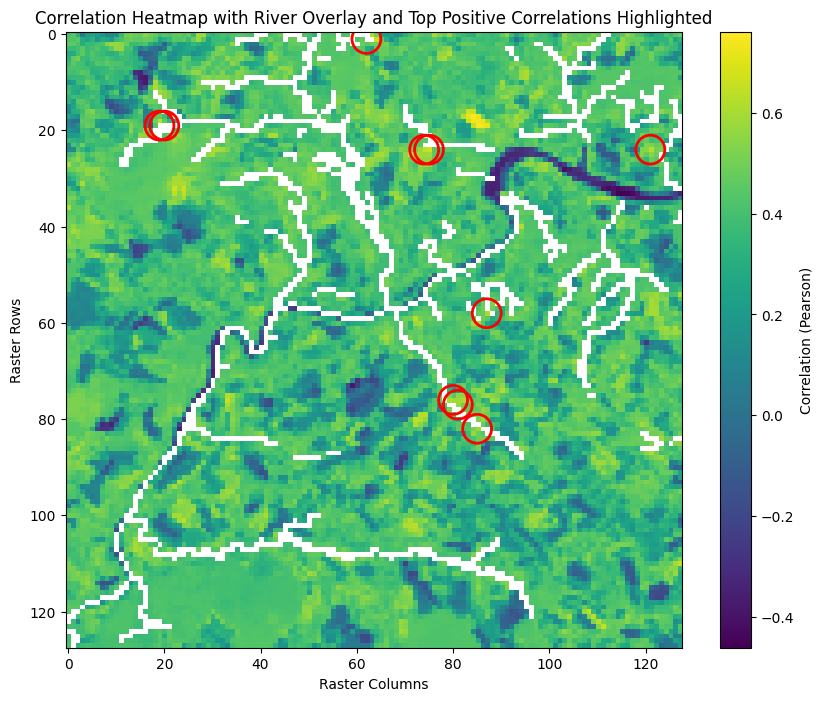

River                        cell_8
Correlation_LST_NDVI       0.284232
Correlation_LST_WT        -0.385949
Correlation_NDVI_WT         0.41973
Overall_Abs_Correlation    0.363304
Name: 20, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 126, Column 63) - Correlation: 0.8119
2: Position (Row 123, Column 34) - Correlation: 0.7344
3: Position (Row 125, Column 63) - Correlation: 0.7323
4: Position (Row 102, Column 55) - Correlation: 0.7288
5: Position (Row 125, Column 72) - Correlation: 0.7277
6: Position (Row 122, Column 67) - Correlation: 0.7140
7: Position (Row 103, Column 82) - Correlation: 0.7116
8: Position (Row 123, Column 68) - Correlation: 0.7079
9: Position (Row 81, Column 62) - Correlation: 0.6940
10: Position (Row 123, Column 62) - Correlation: 0.6929

 Cell cell_8


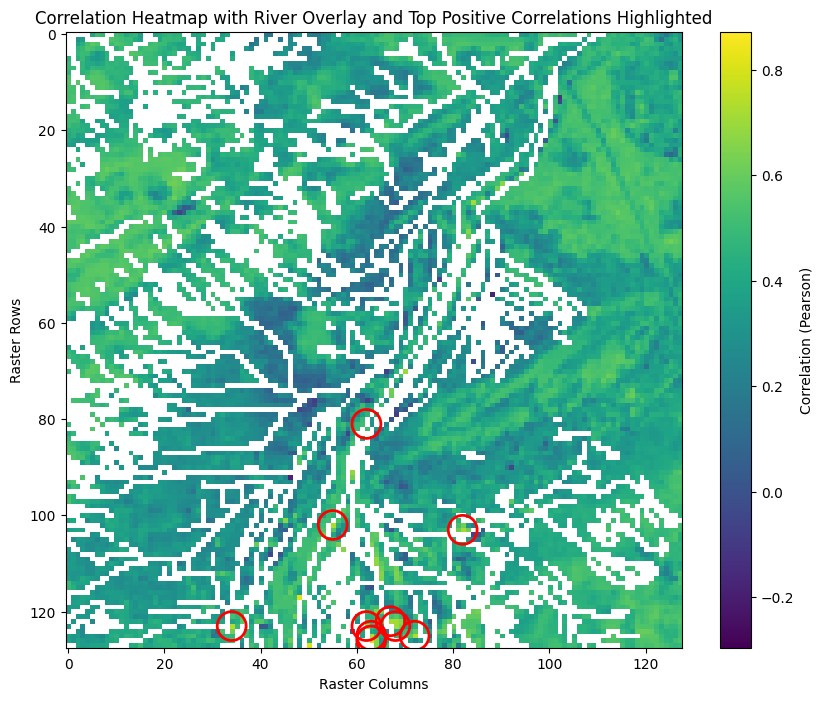

River                       cell_50
Correlation_LST_NDVI       0.052826
Correlation_LST_WT         0.191007
Correlation_NDVI_WT        0.386562
Overall_Abs_Correlation    0.210132
Name: 64, dtype: object
Top 10 positive correlations and their positions:
1: Position (Row 13, Column 17) - Correlation: 0.8683
2: Position (Row 25, Column 30) - Correlation: 0.8517
3: Position (Row 12, Column 15) - Correlation: 0.7584
4: Position (Row 88, Column 59) - Correlation: 0.7529
5: Position (Row 79, Column 47) - Correlation: 0.7333
6: Position (Row 83, Column 53) - Correlation: 0.7216
7: Position (Row 72, Column 91) - Correlation: 0.7131
8: Position (Row 50, Column 21) - Correlation: 0.6926
9: Position (Row 47, Column 4) - Correlation: 0.6905
10: Position (Row 10, Column 12) - Correlation: 0.6852

 Cell cell_50


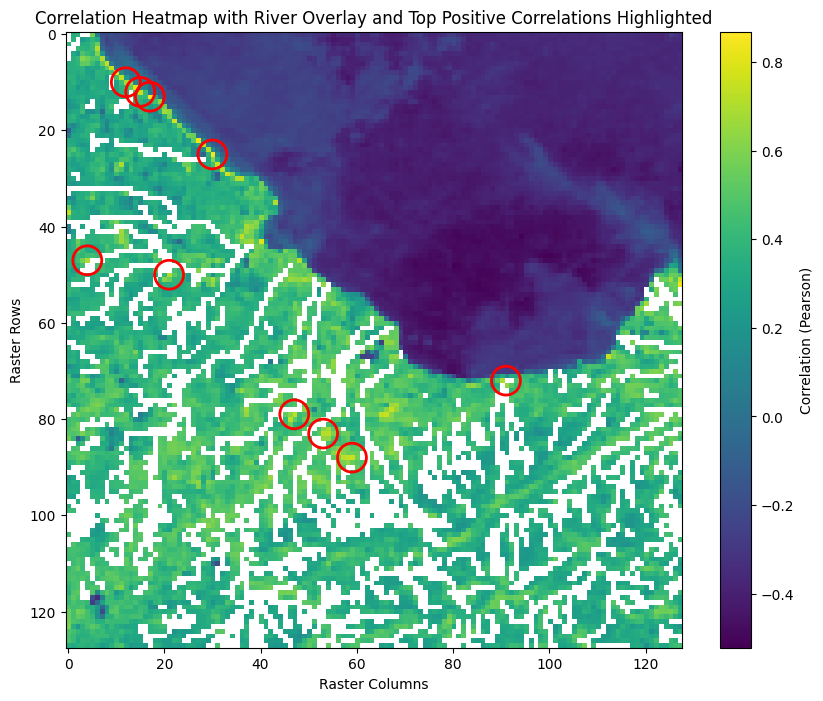

In [62]:
height, width = 128, 128
for i,row in results_df.sort_values('Correlation_NDVI_WT', ascending=False).iloc[:10].iterrows():
    print(row)
    riv = row.River
    num = imgs_per_river[riv]
    time_series_values = np.zeros((height, width, num))
    water_temp_rasters = []
    
    for n in range(num):
        image = lst_images[riv][n]
        lst_values.append(neigh_values_lst)
    
        image = ndvi_images[riv][n]
        time_series_values[:, :, n] = image
        
        water_temp = all_ds['wt'][riv][n]
        raster_water = np.full((height, width), water_temp)
        water_temp_rasters.append(raster_water)
        
    correlation_map = np.full((height, width), np.nan)
    water_temp_rasters = np.array(water_temp_rasters)

    for row in range(height):
        for col in range(width):
            pixel_series_lst = time_series_values[row, col, :]
            pixel_series_water = water_temp_rasters[:, row, col]
            
            if np.count_nonzero(pixel_series_lst) > 1:
                correlation, _ = pearsonr(pixel_series_lst, pixel_series_water)
                correlation_map[row, col] = correlation
                
    corr_plot(correlation_map, riv, river_masks, 'positive',adj_neighbors[riv])
    



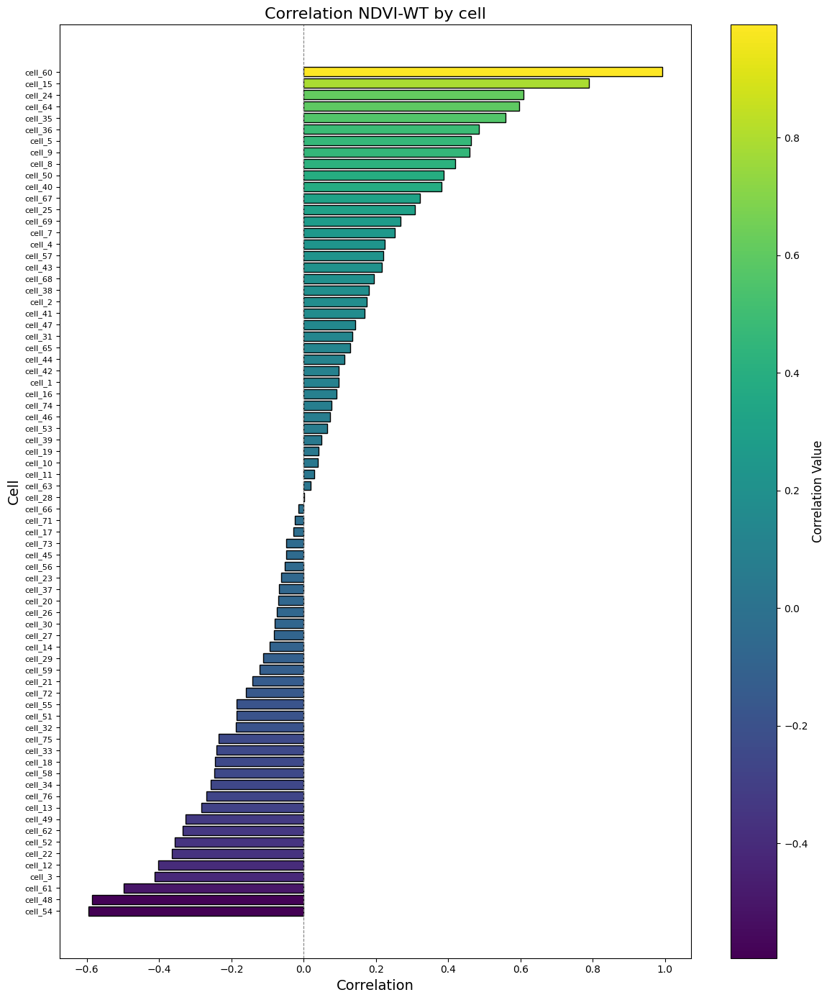

In [52]:
results_df_sorted = results_df.sort_values('Correlation_NDVI_WT')

# Normalize the correlation values for the colormap
norm = Normalize(vmin=results_df_sorted['Correlation_NDVI_WT'].min(), 
                 vmax=results_df_sorted['Correlation_NDVI_WT'].max())
colors = cm.viridis(norm(results_df_sorted['Correlation_NDVI_WT']))

# Plot horizontal bar chart
fig, ax = plt.subplots(figsize=(12, 14))
bars = ax.barh(
    results_df_sorted['River'], 
    results_df_sorted['Correlation_NDVI_WT'], 
    color=colors, 
    edgecolor='black'
)

# Add colorbar with correct linkage
sm = cm.ScalarMappable(cmap="viridis", norm=norm)
sm.set_array([])  # ScalarMappable necesita un array para funcionar
cbar = fig.colorbar(sm, ax=ax)
cbar.set_label('Correlation Value', fontsize=12)

# Add guide line at 0
ax.axvline(0, color='gray', linestyle='--', linewidth=0.8)

# Configure labels and title
ax.set_title('Correlation NDVI-WT by cell', fontsize=16)
ax.set_xlabel('Correlation', fontsize=14)
ax.set_ylabel('Cell', fontsize=14)

# Reduce font size of y-axis labels
ax.tick_params(axis='y', labelsize=8)

# Adjust layout
plt.tight_layout()
plt.show()